In [7]:
import itertools
import copy
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader, random_split
import torch.nn as nn
import pickle
import random
from sklearn.model_selection import train_test_split
import time
from joblib import Parallel, delayed
import pandas as pd
import sys
import os
import seaborn as sns 
from sklearn.metrics import r2_score
import math
import matplotlib as mpl

from cryptic_rnn import *

# Functions

# RNN setup

In [25]:
## running function
def get_reps(model, testdata, hidden_size):
    model.eval()
    trials = []
    hiddens = []
    for testset in testdata:
        for x,y in testset:
            for i in range(len(x)):
                hidden_arr = np.empty((0,  hidden_size))
                hidden = torch.zeros(1, hidden_size)[0]
                for step in x[i]:
                    hidden, y_hat = model.get_activations(step,hidden)
                    hidden_arr = np.vstack([hidden_arr, hidden.detach().numpy()])
            hiddens.append(hidden_arr)
            trials.append(str(onehot2seq(x)))

    return hiddens, trials 
    

def run_exp(trainseqs_old , testseqs_old, cue_dict, xavier_gain, num_episodes):
    
    losses = np.empty((0,1))
    accs = np.empty((0,2))
    cue_dicts = []
    tests = []
    # initialize RNN
    model = OneStepRNN(input_size, output_size, hidden_size, num_layers, xavier_gain)
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=learningRate)
    
    # repeat episodes of training with new input values
    for ep in range(num_episodes):
        all_syms = list(cue_dict.keys())
        all_input_vals = list(np.arange(2,18))
        input_vals = random.sample(all_input_vals,num_inputs)
        for i, s in enumerate(all_syms):
            cue_dict[s] = input_vals[i]

        trainseqs = change_dict(trainseqs_old, cue_dict)
        train_inputs = convert_seq2inputs(trainseqs, num_classes=num_classes, seq_len=5)
        trainset = DataLoader(train_inputs, batch_size=batchsize, shuffle=True)

        testseqs = change_dict(testseqs_old, cue_dict)
        test_inputs = convert_seq2inputs(testseqs, num_classes=num_classes, seq_len=5)
        testset = DataLoader(test_inputs, batch_size=batchsize, shuffle=True)

        # run primitive training RNN
        loss1, acc1 = run_acc(model,optimizer,criterion, trainset, [trainset, testset], epochs, hidden_size)
        losses = np.vstack([losses, loss1])
        accs = np.vstack([accs, acc1])
        cue_dicts.append(cue_dict)
        tests.append(testset)
     
    return {'all_loss':losses, 'all_acc':accs, 'mod': model,\
            'loss':loss1, 'acc':acc1, 'test':testset, 'cue_dict':cue_dicts
           }

def run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes):
    
    t1 = time.time()
    res  = Parallel(n_jobs = -1)(delayed(run_exp)(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes) for i in range(num_sims))
    t2 = time.time()
    print('run time: ', (t2-t1)/60)

    acc_train_list = [r['acc'][:,0] for r in res]
    acc_test_list = [r['acc'][:,1] for r in res]
    loss_list = [r['loss'] for r in res]
    tests = [r['test'] for r in res]
    cue_dicts = [r['cue_dict'] for r in res]
    mods = [r['mod'] for r in res]
 
    # all RNNs plot accuracy
    losses = np.hstack([r['all_loss'] for r in res])
    acc_train = np.array([r['all_acc'][:,0] for r in res]).T
    acc_test = np.array([r['all_acc'][:,1] for r in res]).T
    
    r2, dfs, alldfs = predcorr(mods, tests, hidden_size, plot_corr = True)
    plotNNs([losses], [acc_train, acc_test], \
            ['train', 'test'], colors = ['green', 'orange'], title = '', shift = 0)
    
    final_accs = pd.DataFrame({'train_acc': acc_train[-1,:],'test_acc': acc_test[-1,:]}) 
    
    # fully trained
    fully_trained = final_accs[final_accs['train_acc'] == 1]
    fully_trained_idx = fully_trained.index
    fully_trained_test_acc = fully_trained['test_acc'].mean() 
    fully_trained_test_acc_std = fully_trained['test_acc'].std()
    
    ft_mods = [mods[i] for i in fully_trained_idx]
    print(len(ft_mods))
    ft_tests = [tests[i] for i in fully_trained_idx]
    ft_tests_acc = np.array([acc_test_list[i] for i in fully_trained_idx]).T
    ft_train_acc = np.array([acc_train_list[i] for i in fully_trained_idx]).T
    ft_loss = np.hstack([loss_list[i] for i in fully_trained_idx])
    
    if len(ft_mods) > 0:
        plt.figure()
        r2, dfs, alldfs = predcorr(ft_mods, ft_tests, hidden_size, plot_corr = True)
    else:
        r2, dfs, alldfs = 0, 0, 0
    
    plotNNs([ft_loss], [ft_train_acc, ft_tests_acc], \
            ['train', 'test'], colors = ['green', 'orange'], title = '', shift = 0)

    return {'res':res, 'dfs':dfs, 'mods':mods, 
            'tests': tests, 'cue_dicts': cue_dicts, 'acc_df':final_accs }


In [9]:
# data
num_classes = 22
batchsize=1

# RNN specs
input_size = num_classes
output_size = 1
num_layers = 1
hidden_size = 20
learningRate = 0.005

## running params
num_sims = 8

# 
xavier_gain = 0.001

# Experiments

Final accuracy against ratio of other/self



In [54]:
ops = '-'

num_inputs = 6
total_syms = ['A','B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P']
all_syms = total_syms[:num_inputs]
all_input_vals = list(np.arange(2,18))
input_vals = random.sample(all_input_vals,num_inputs)
# randomly select values for each input
cue_dict = {}
for i, s in enumerate(all_syms):
    cue_dict[s] = input_vals[i]
    
print(cue_dict)
primitives = generate_primitives(all_syms, cue_dict)
print(primitives)
neg_primitives = generate_neg_primitives(all_syms, cue_dict)
print(neg_primitives)

{'A': 8, 'B': 17, 'C': 12, 'D': 16, 'E': 11, 'F': 14}
[['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
[[('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14]]


# Run

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -6], ['E', ('-', 'C'), '=', -1], ['E', ('-',

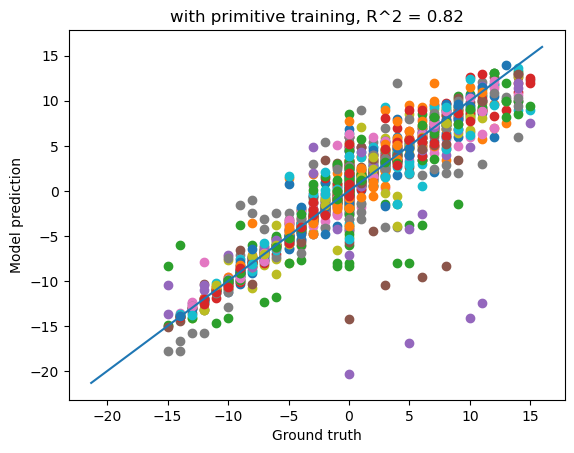

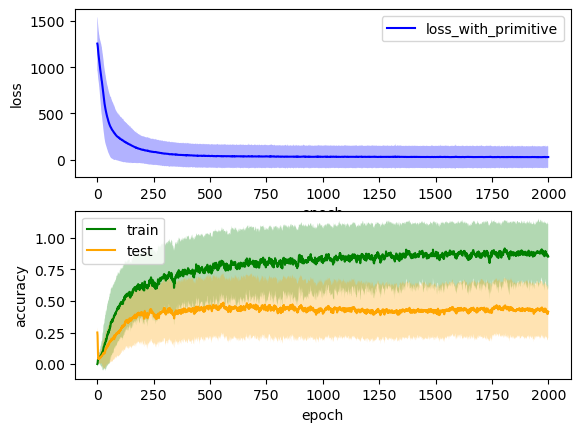

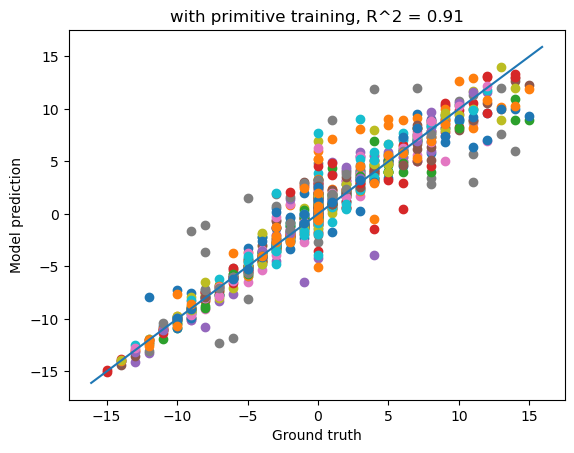

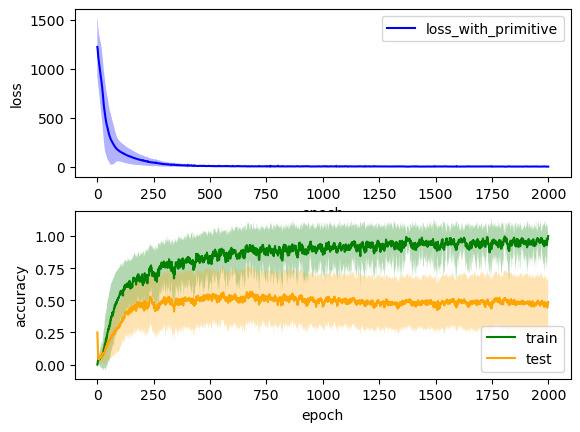

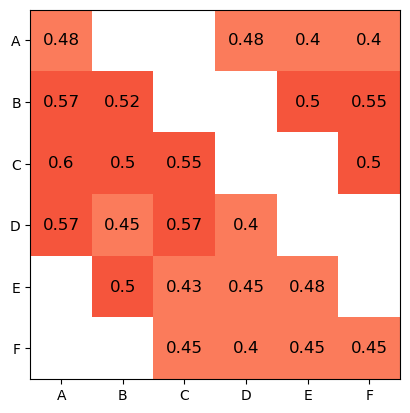

In [91]:
epochs = 2000
num_sims = 64
xavier_gain = 0.001
hidden_size = 15

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -6], ['E', ('-', 'C'), '=', -1], ['E', ('-',

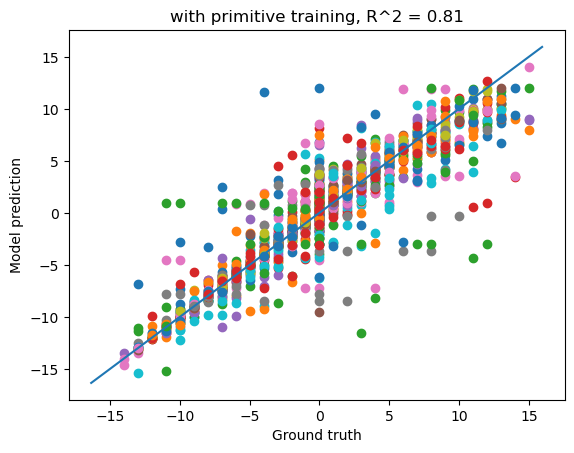

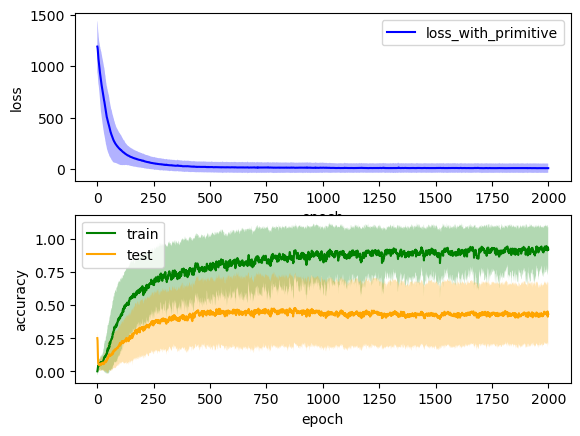

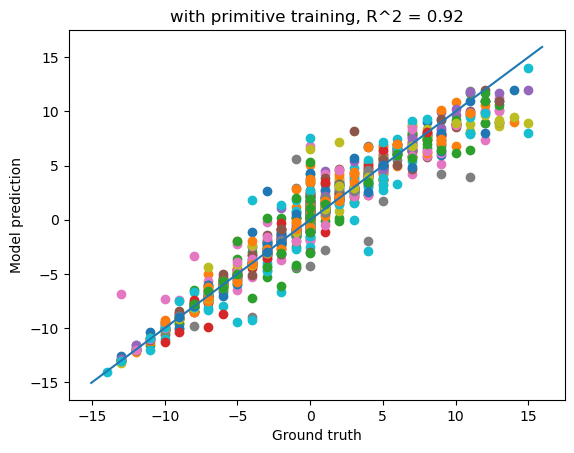

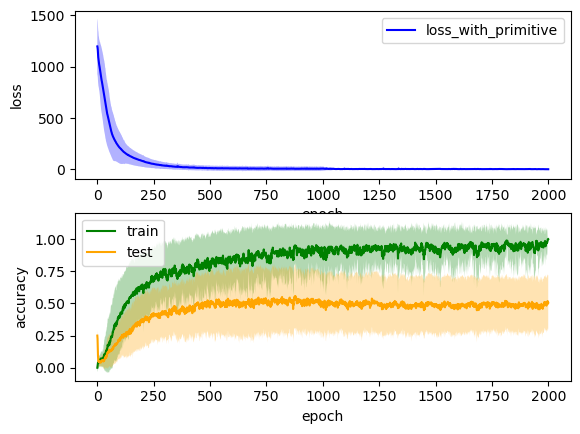

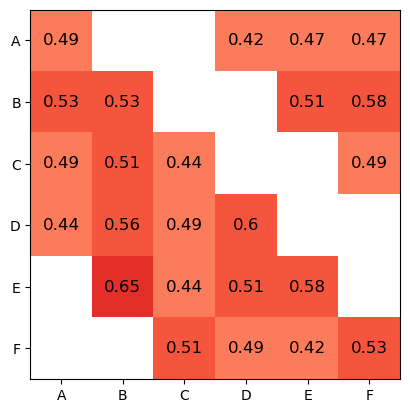

In [92]:
epochs = 2000
num_sims = 64
xavier_gain = 0.0001
hidden_size = 15

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -6], ['E', ('-', 'C'), '=', -1], ['E', ('-',

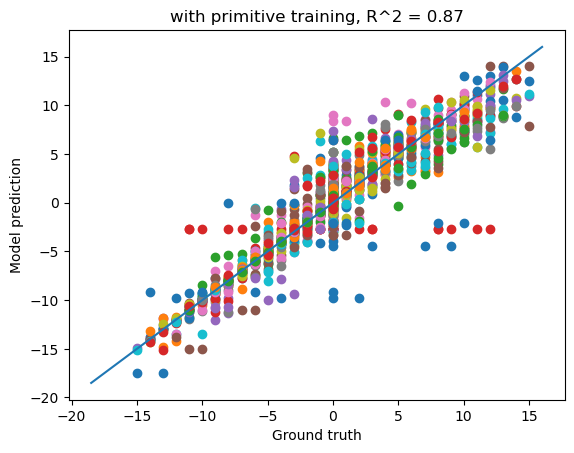

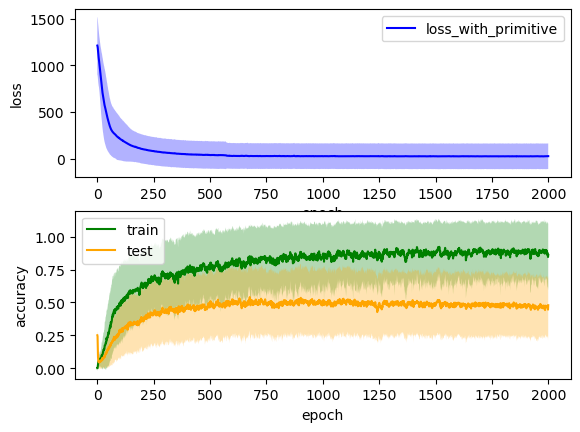

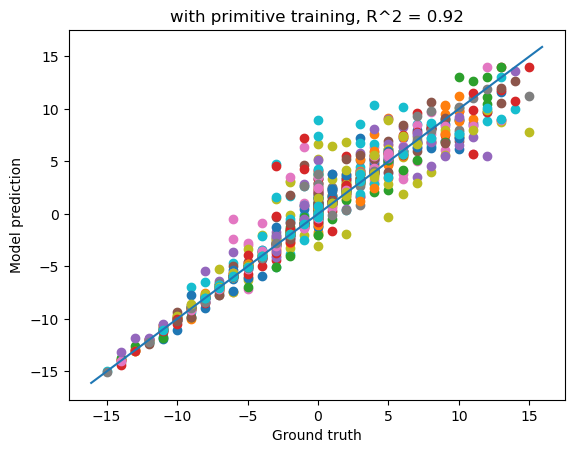

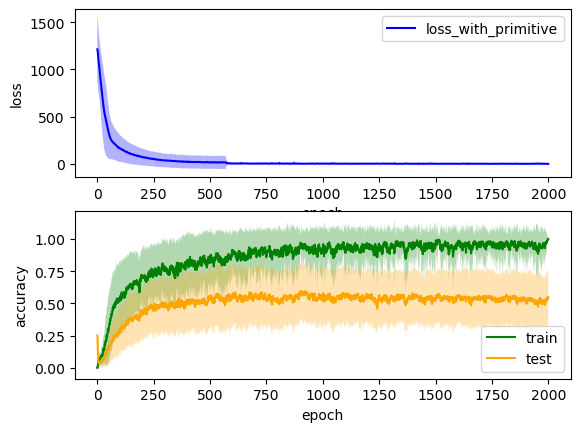

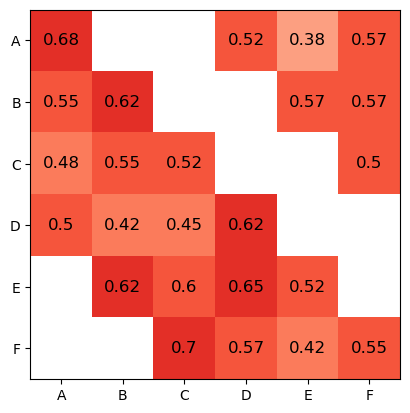

In [93]:
epochs = 2000
num_sims = 64
xavier_gain = 0.01
hidden_size = 15

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -6], ['E', ('-', 'C'), '=', -1], ['E', ('-',

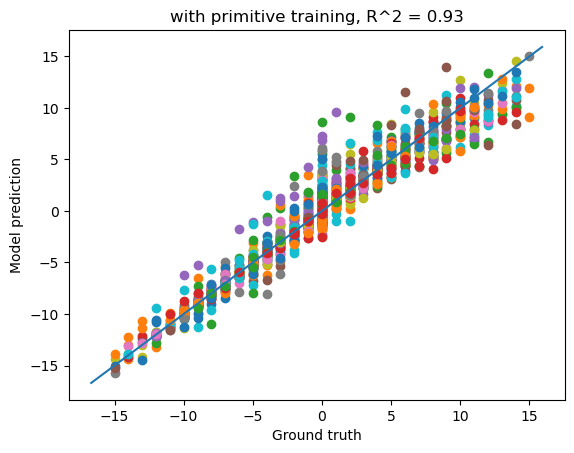

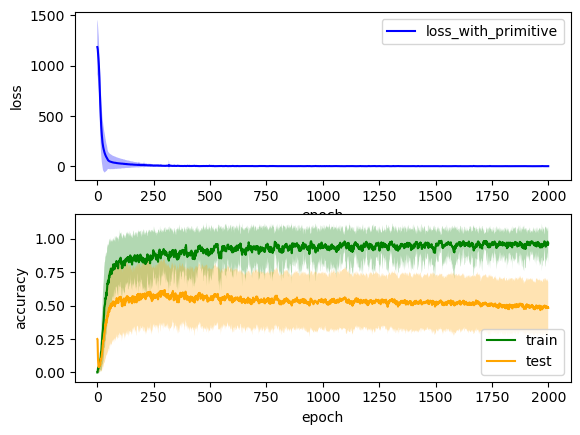

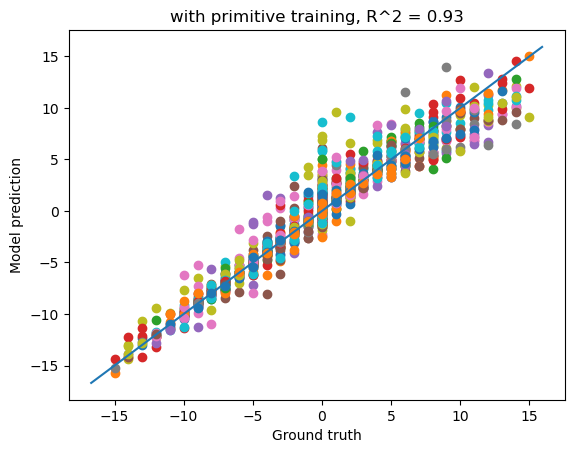

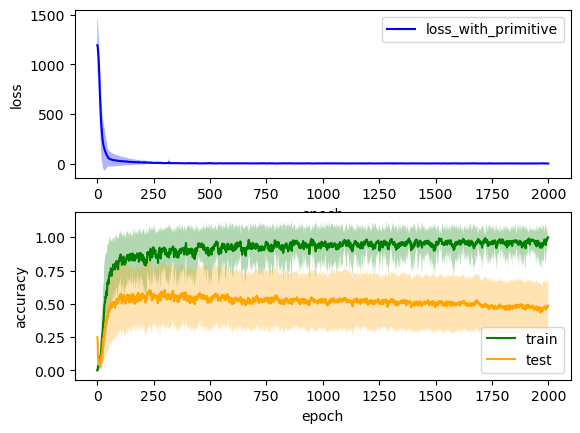

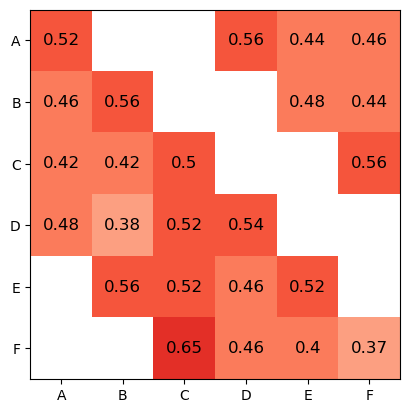

In [94]:
epochs = 2000
num_sims = 64
xavier_gain = 0.1
hidden_size = 15

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -6], ['E', ('-', 'C'), '=', -1], ['E', ('-',

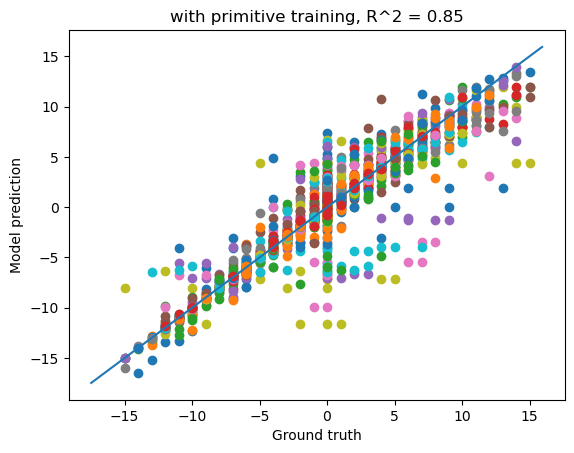

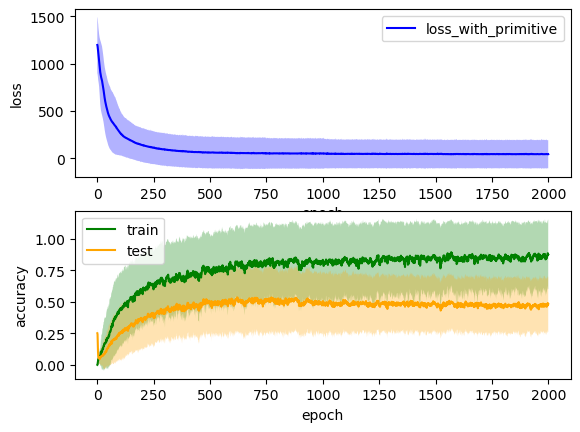

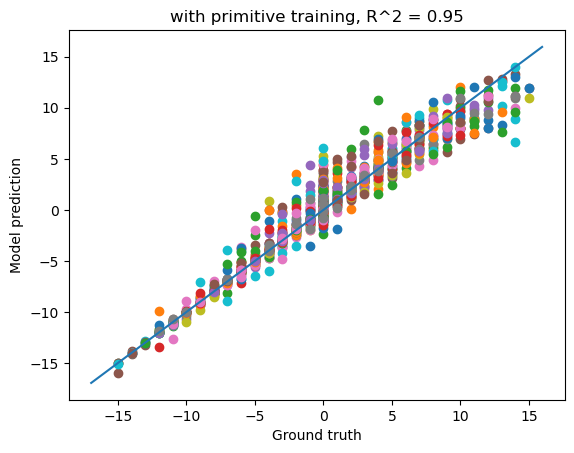

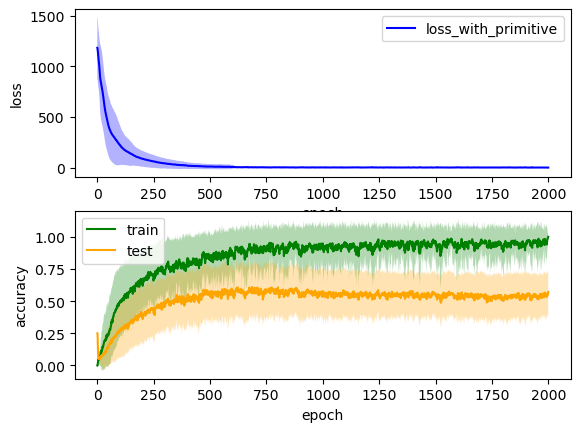

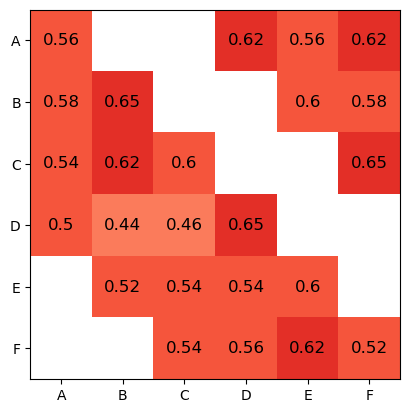

In [95]:
epochs = 2000
num_sims = 64
xavier_gain = 0.00001
hidden_size = 15

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -6], ['E', ('-', 'C'), '=', -1], ['E', ('-',

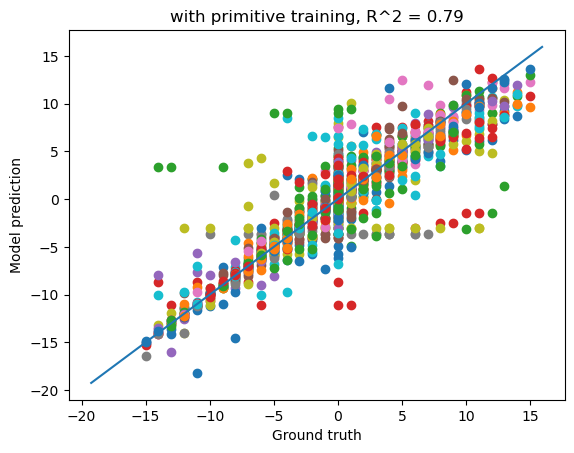

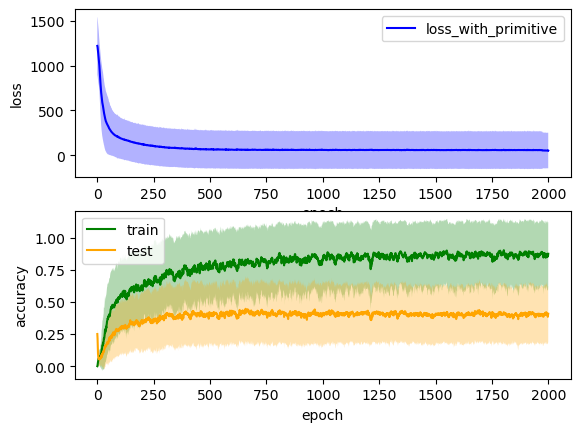

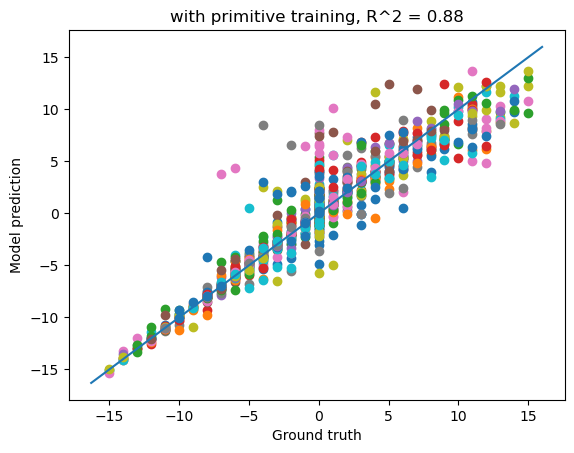

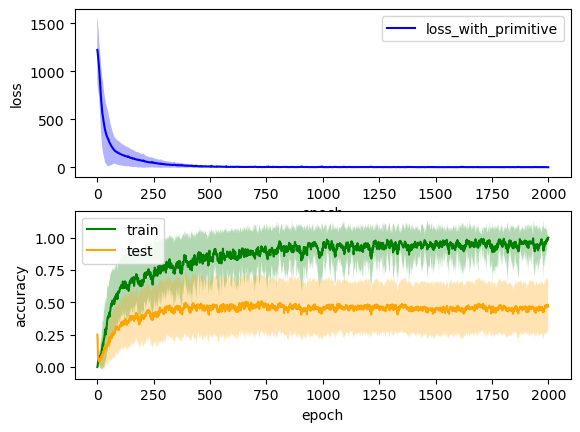

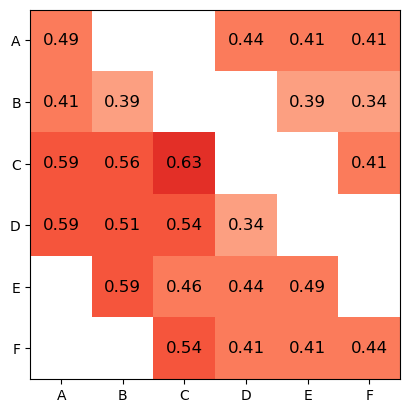

In [96]:
epochs = 2000
num_sims = 64
xavier_gain = 0.00001
hidden_size = 20

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

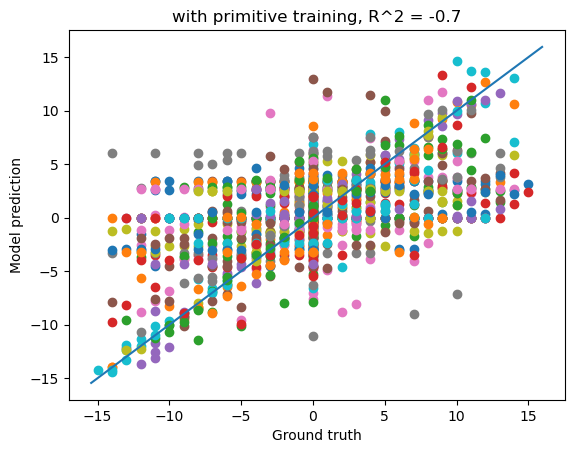

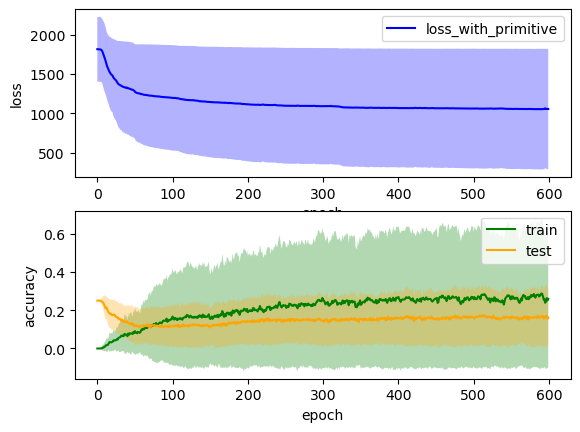

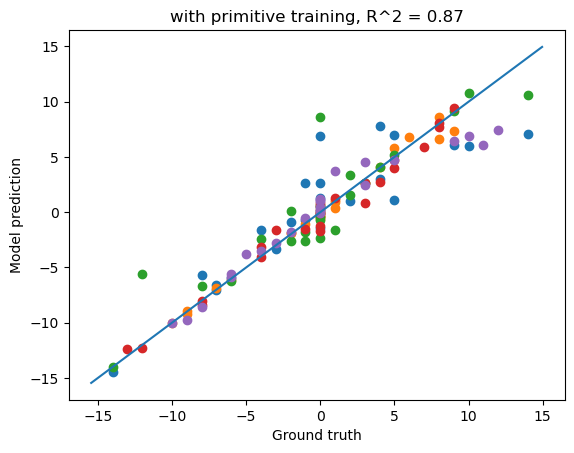

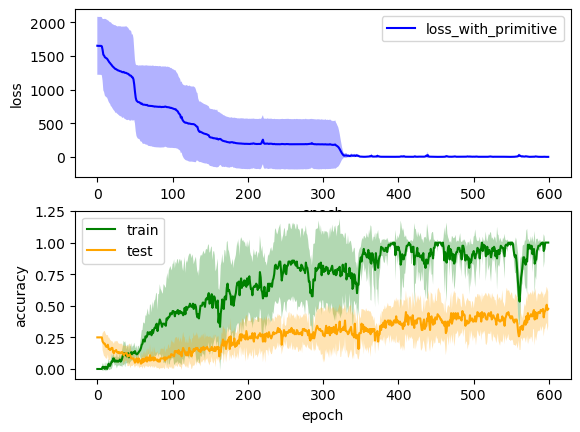

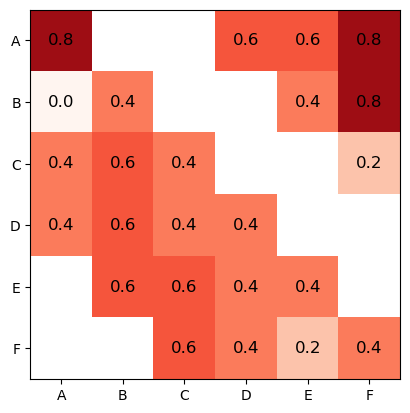

In [61]:
hidden_size = 17

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

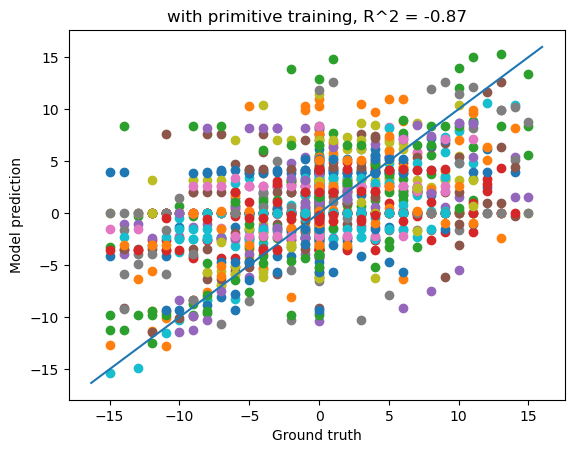

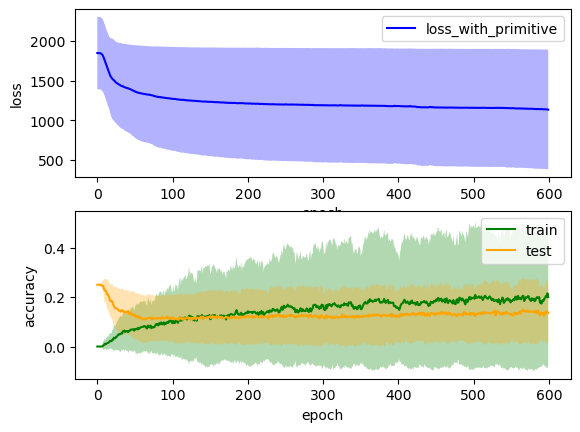

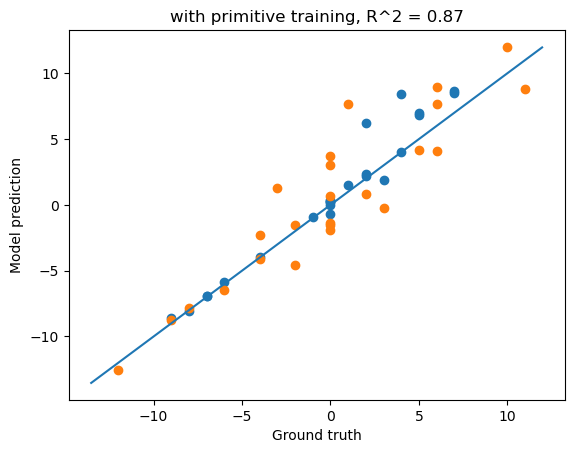

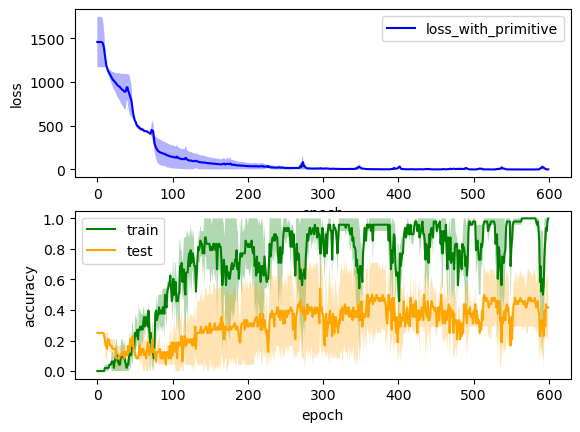

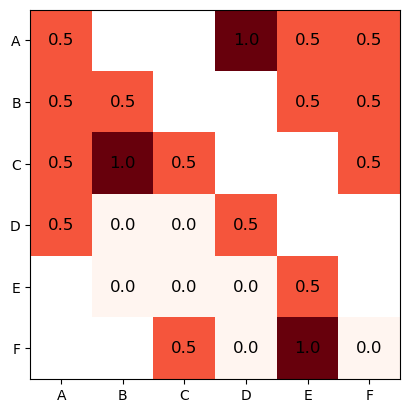

In [62]:
hidden_size = 13

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

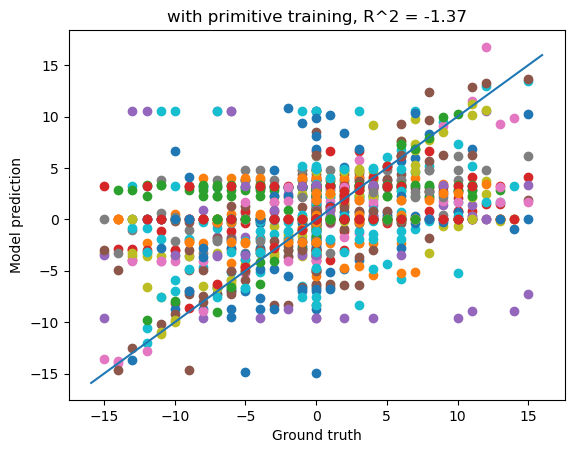

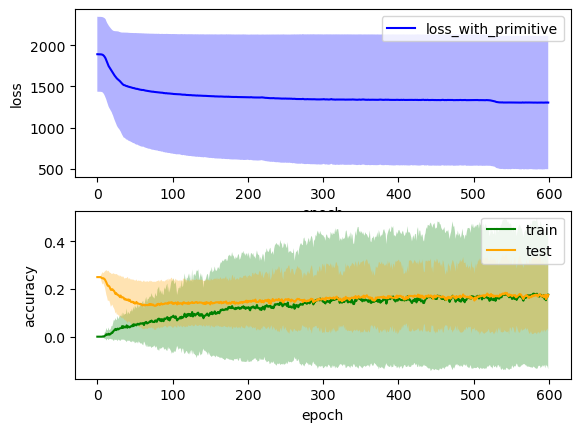

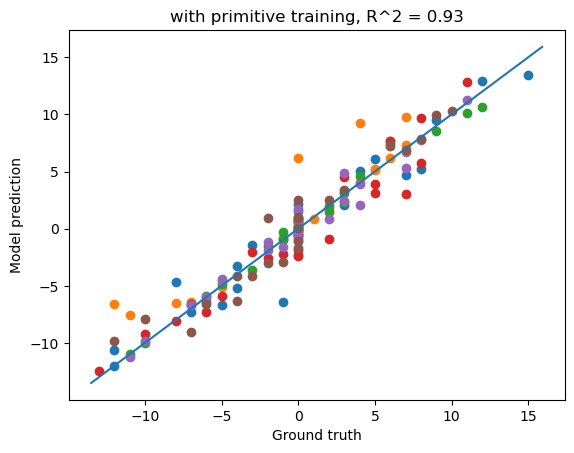

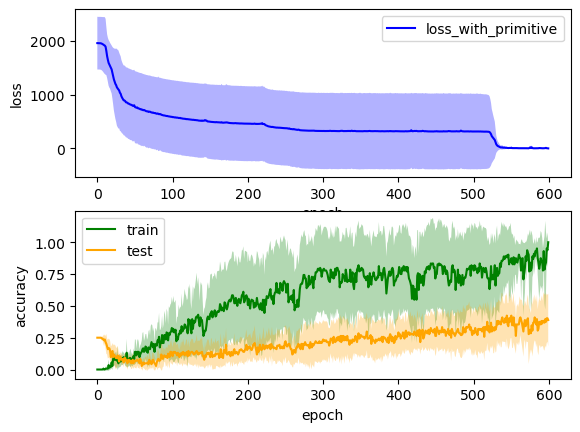

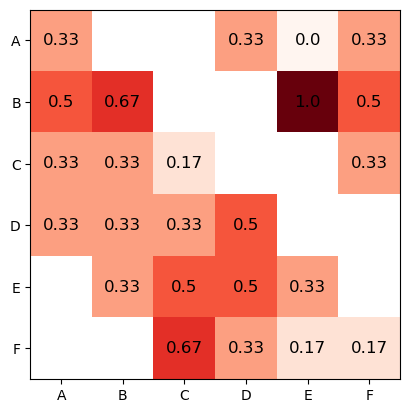

In [63]:
hidden_size = 11

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

/Users/miahannah/opt/anaconda3/lib/python3.8/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


run time:  15.69492978254954
7


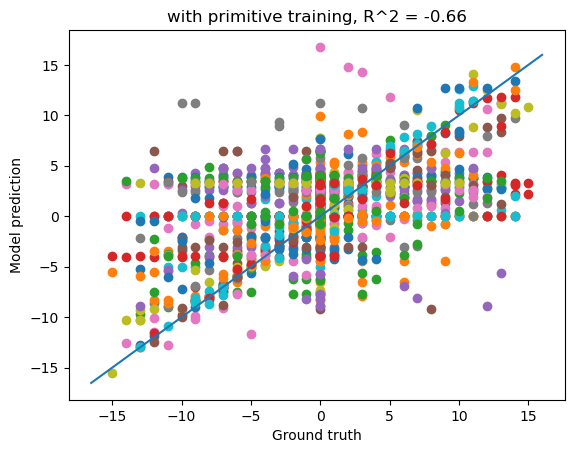

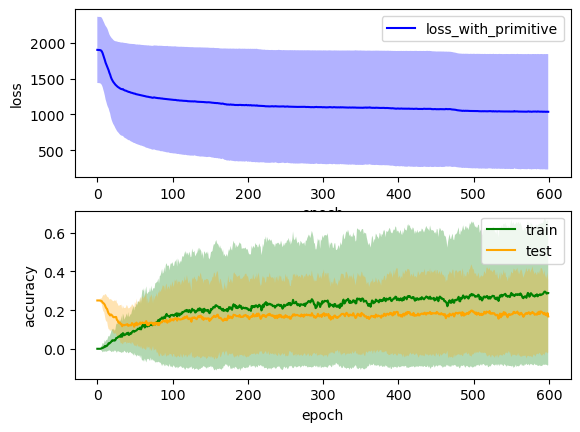

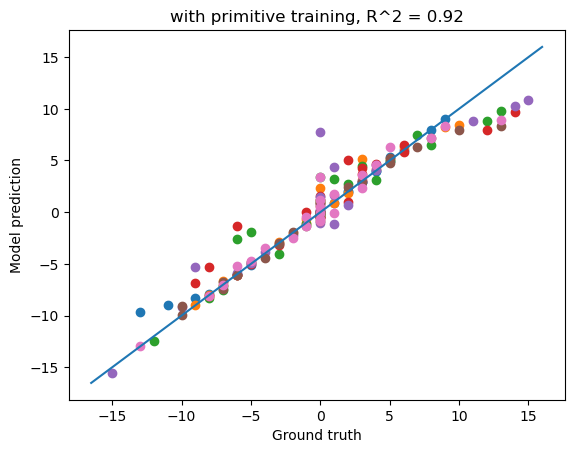

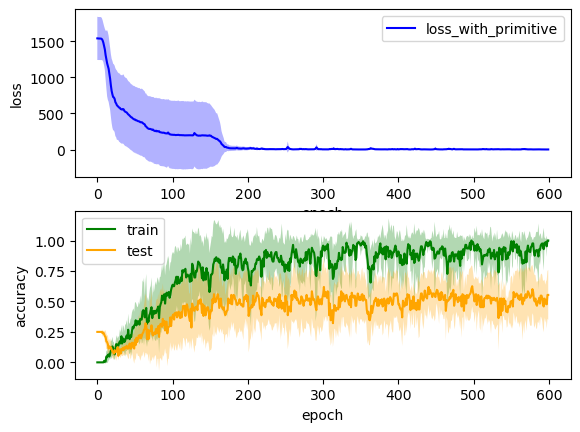

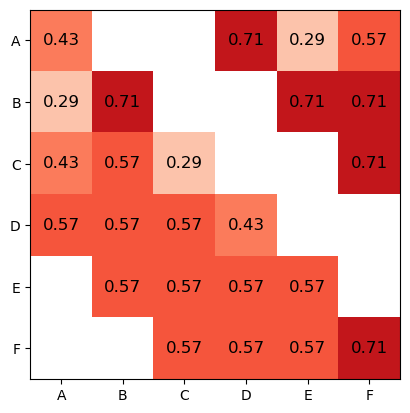

In [64]:
hidden_size = 18

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

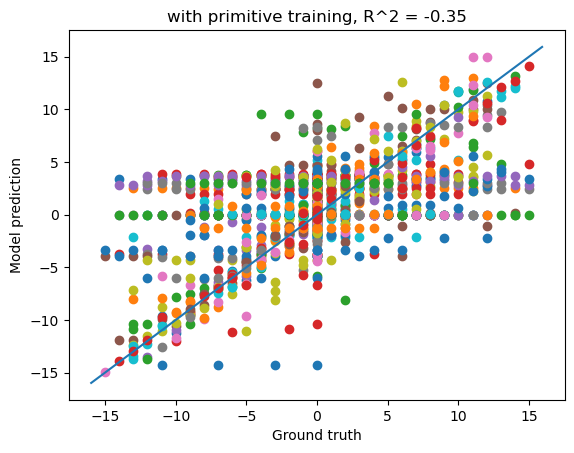

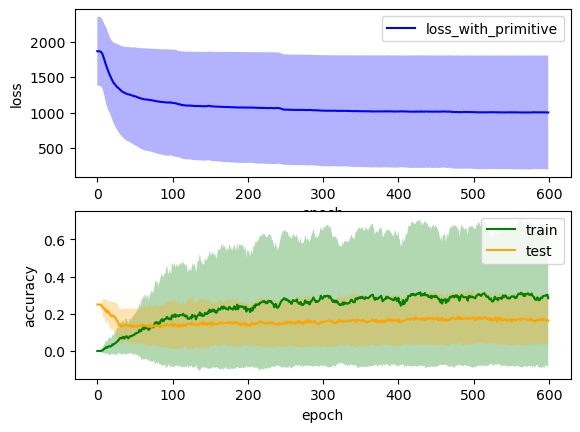

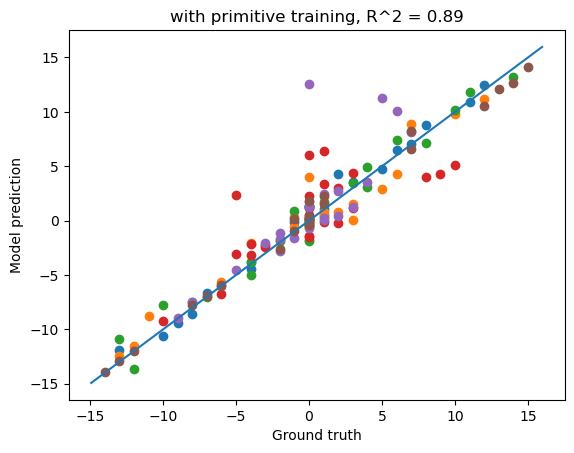

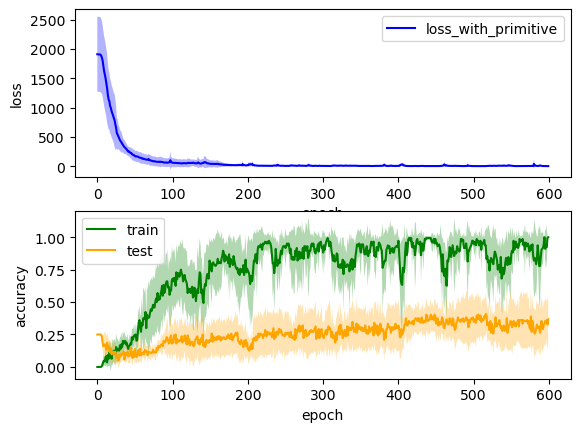

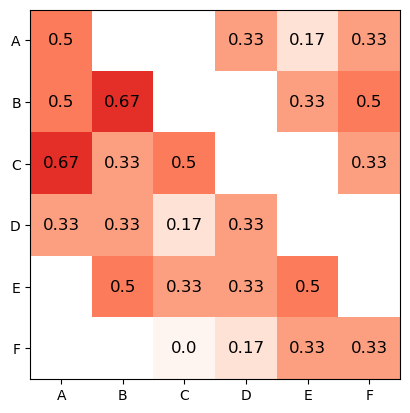

In [65]:
epochs = 600
num_sims = 64
xavier_gain = 0.001
hidden_size = 20

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

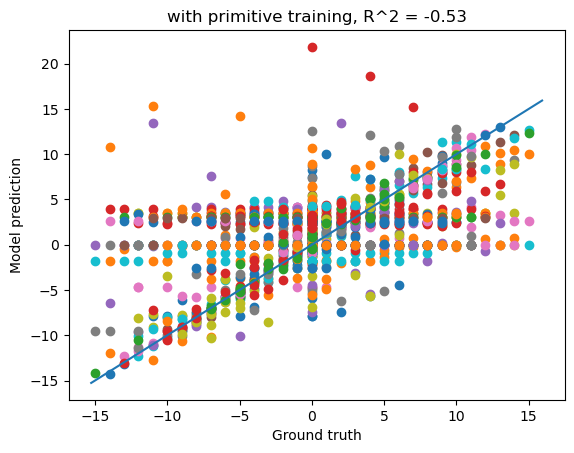

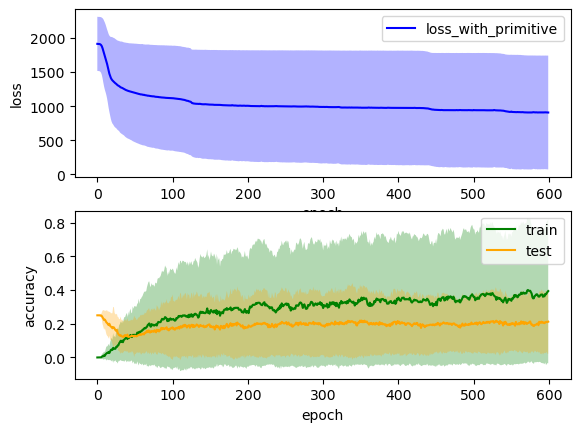

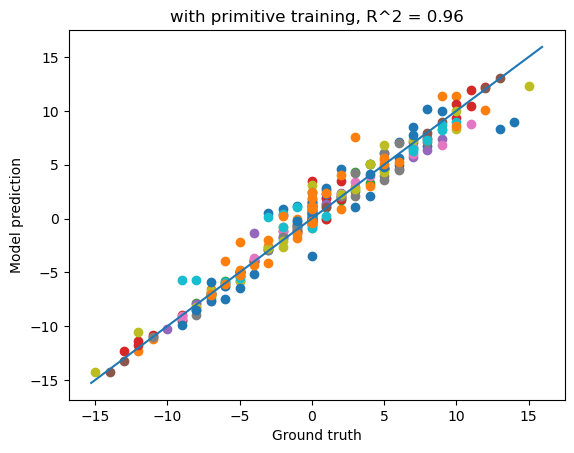

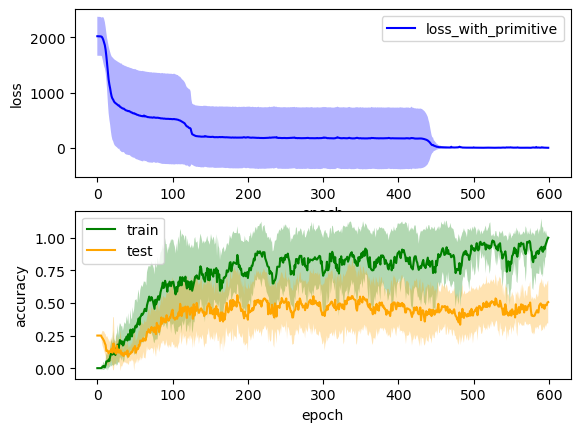

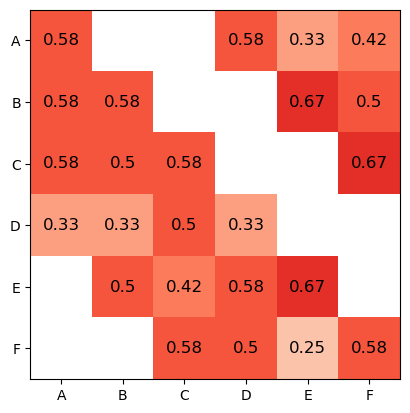

In [66]:
epochs = 600
num_sims = 64
xavier_gain = 0.001
hidden_size = 25

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

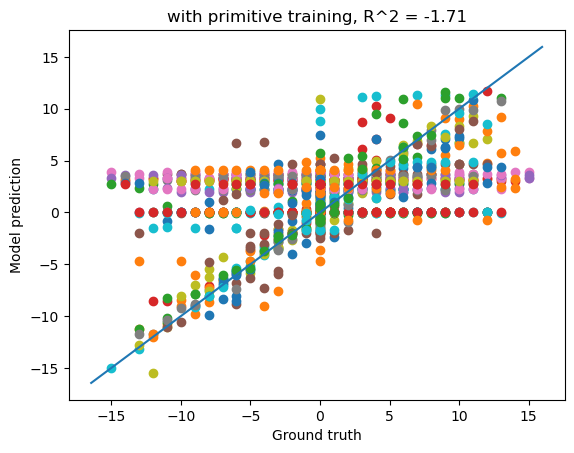

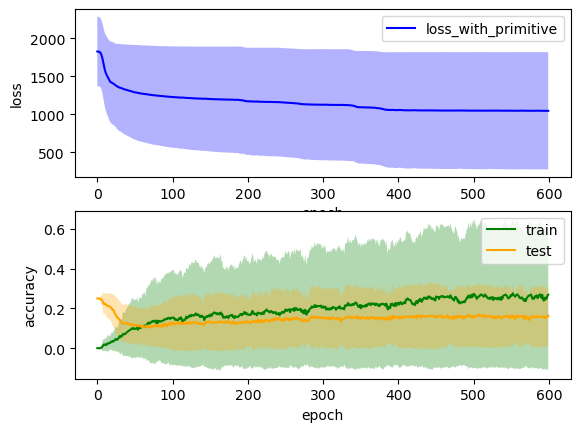

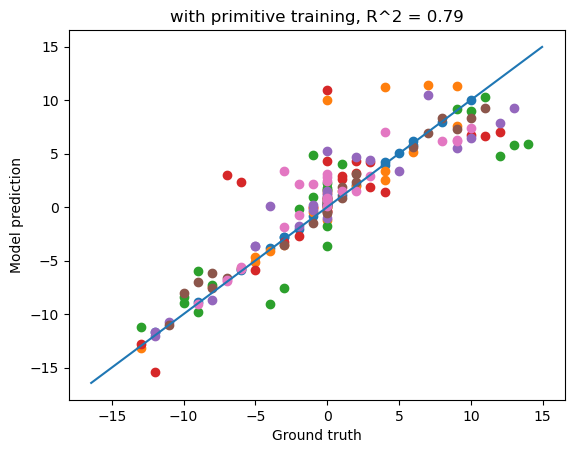

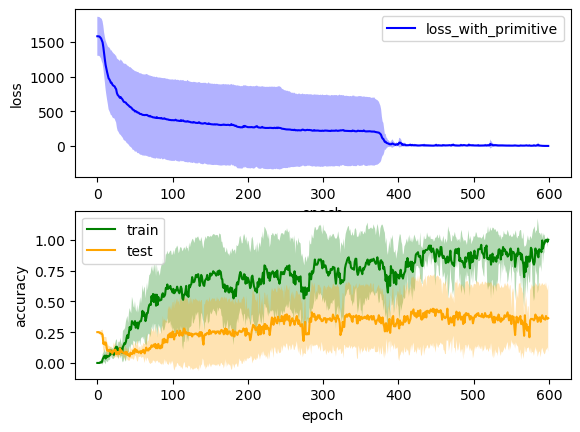

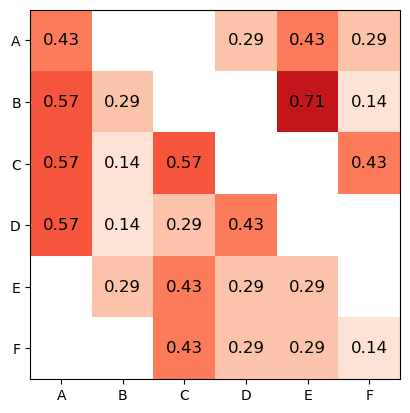

In [71]:
epochs = 600
num_sims = 64
xavier_gain = 0.001
hidden_size = 27

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

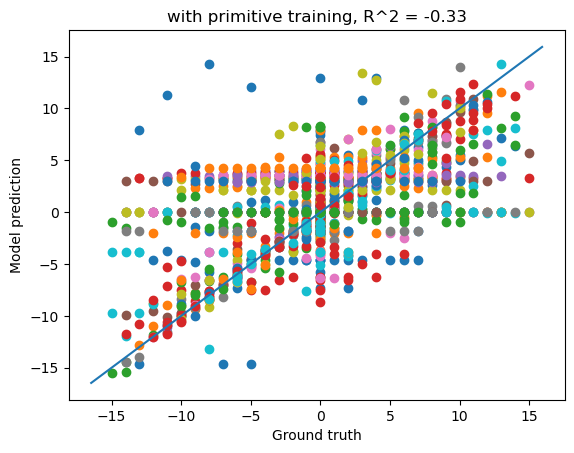

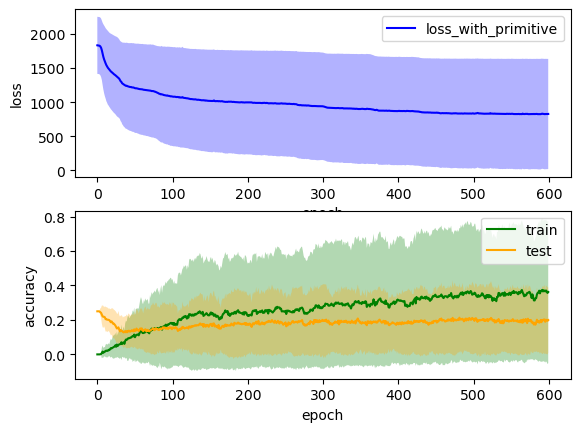

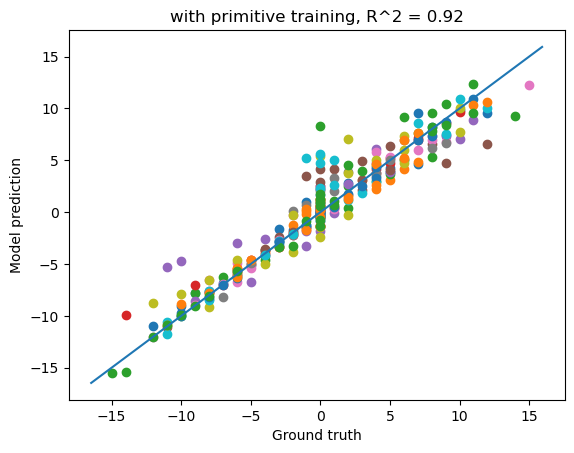

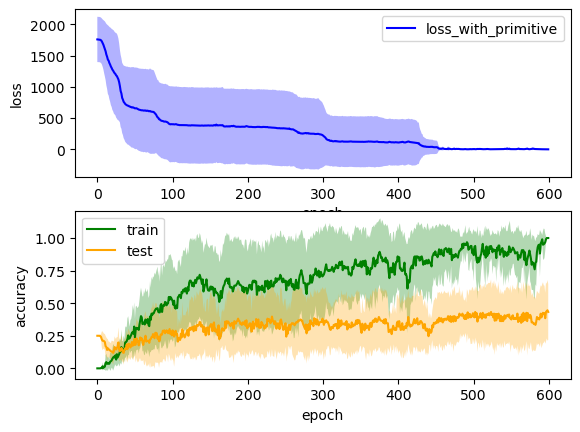

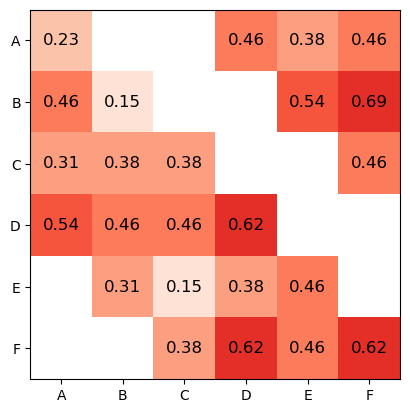

In [72]:
epochs = 600
num_sims = 64
xavier_gain = 0.001
hidden_size = 30

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

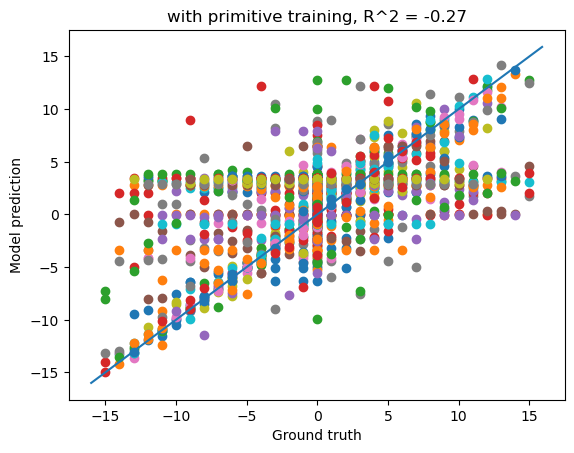

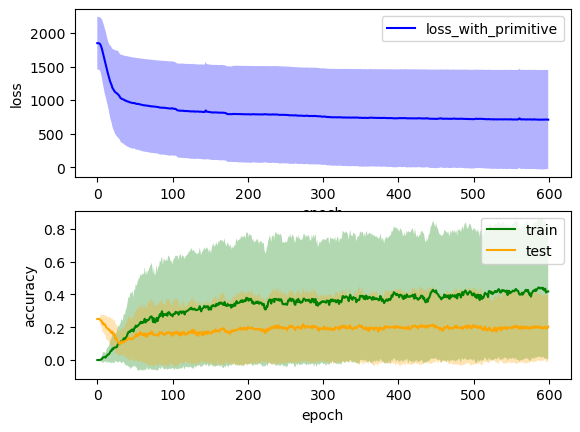

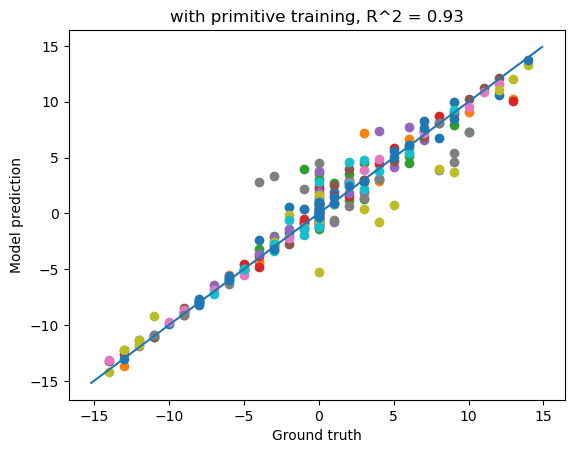

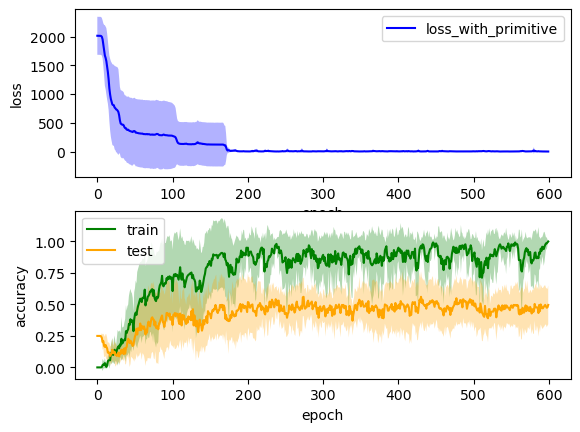

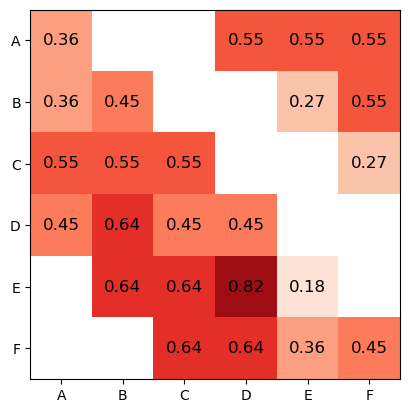

In [73]:
epochs = 600
num_sims = 64
xavier_gain = 0.001
hidden_size = 33

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [ ]:
# xavier gains

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

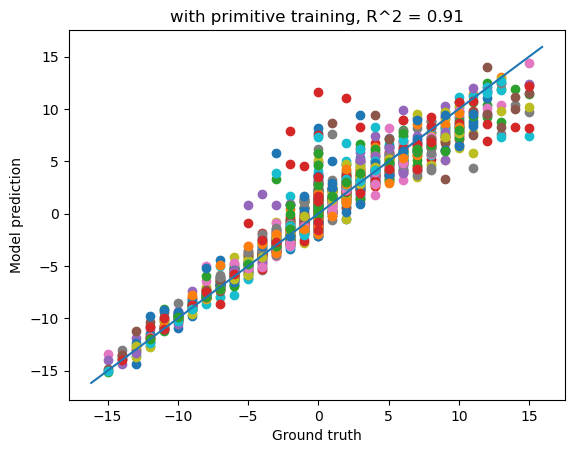

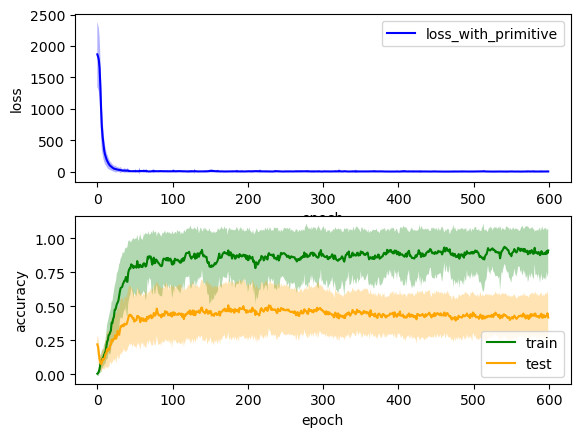

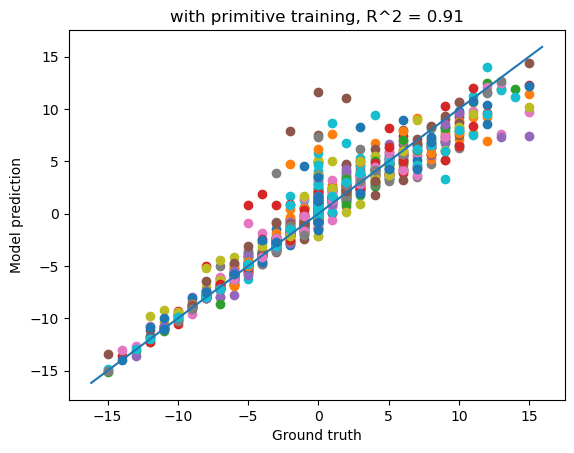

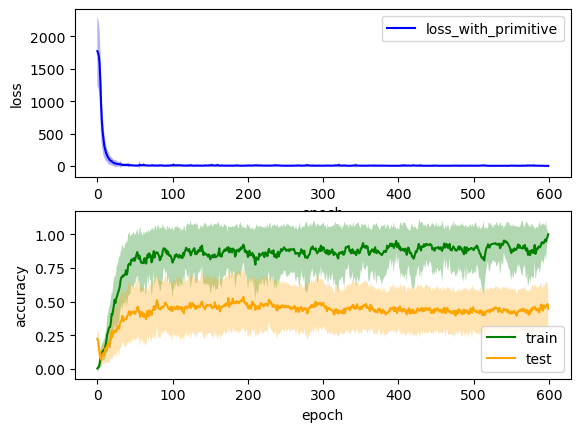

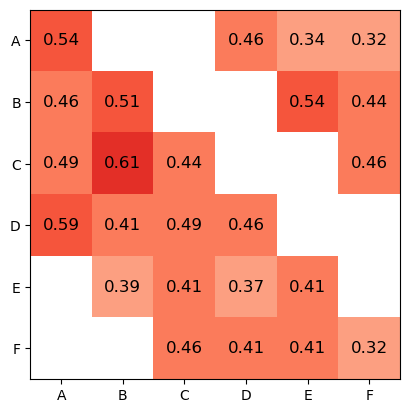

In [75]:
epochs = 600
num_sims = 64
xavier_gain = 1
hidden_size = 20

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

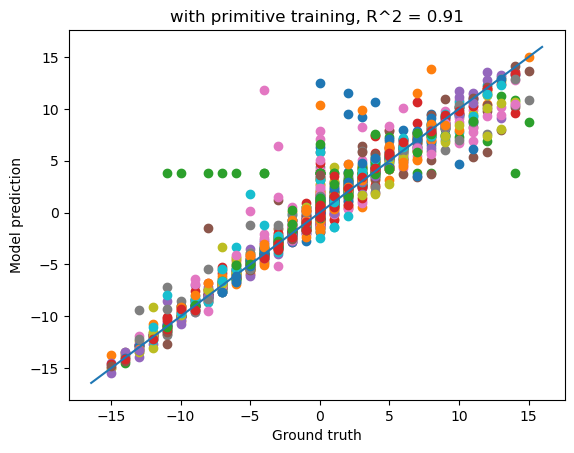

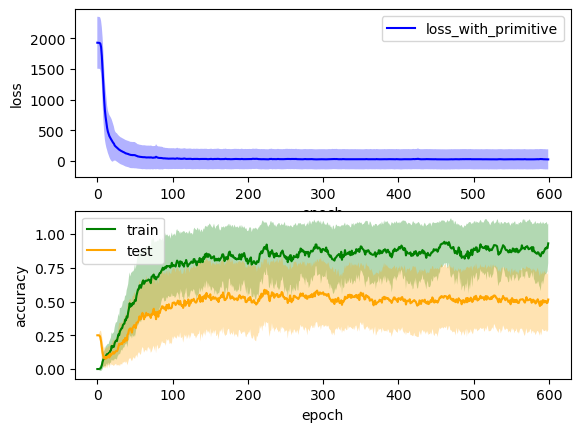

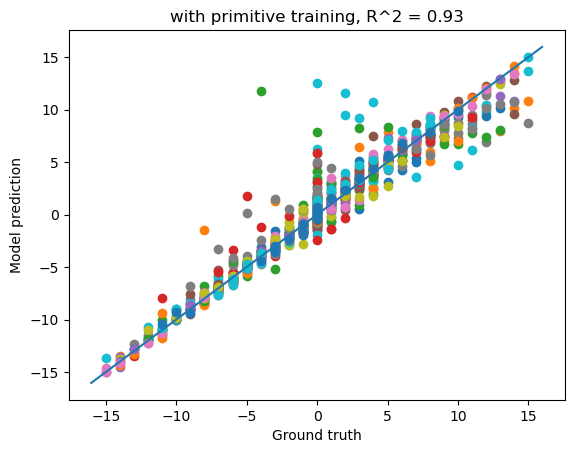

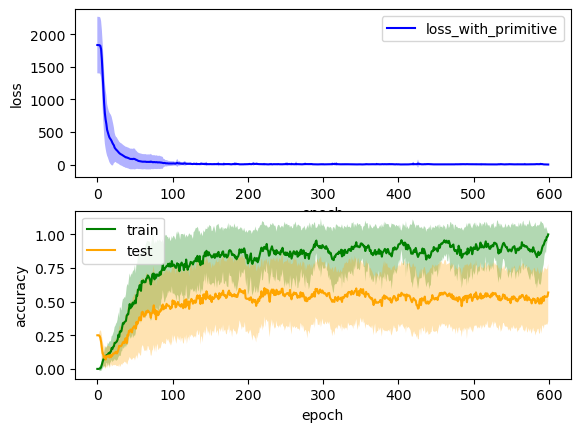

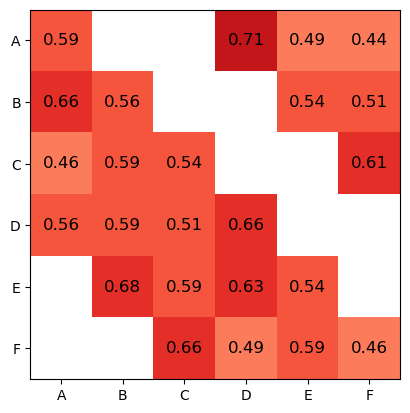

In [76]:
xavier_gain = 0.1

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

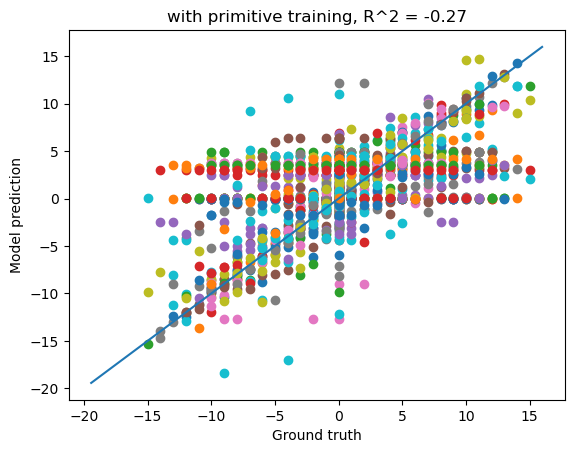

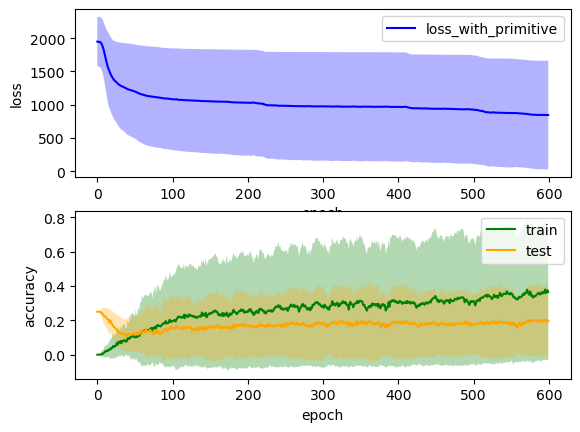

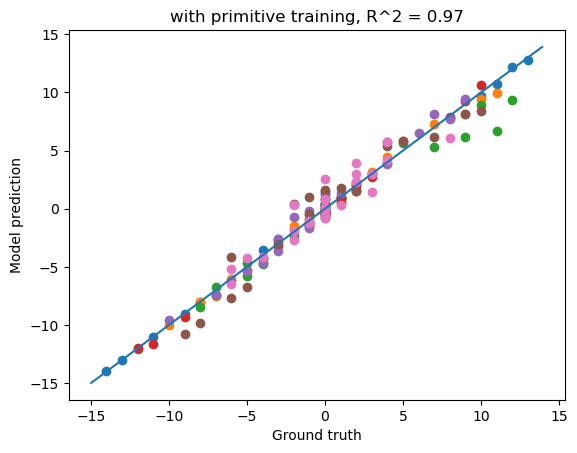

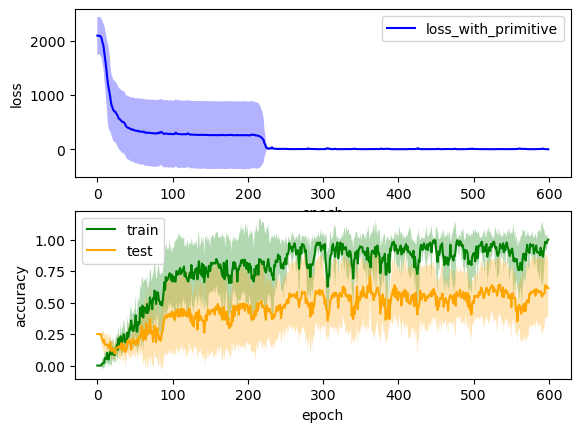

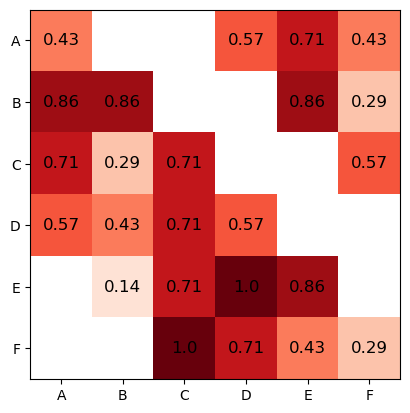

In [77]:
xavier_gain = 0.01

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

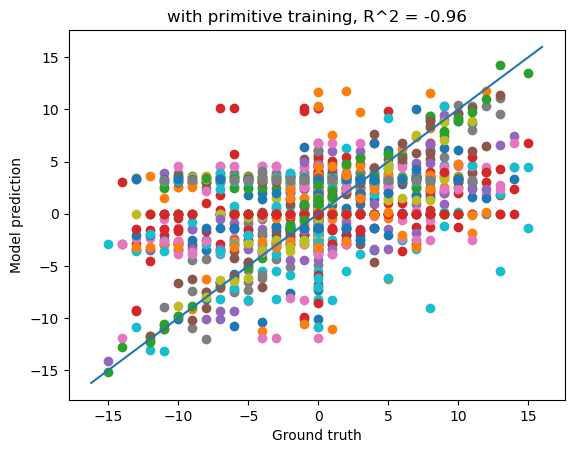

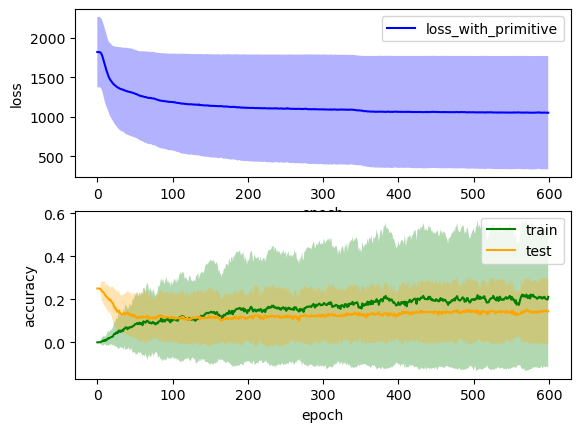

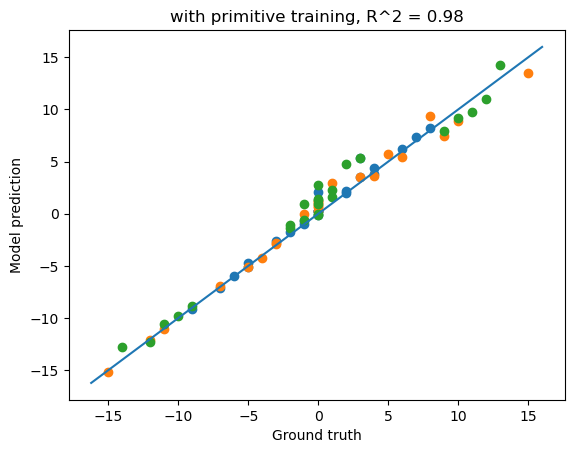

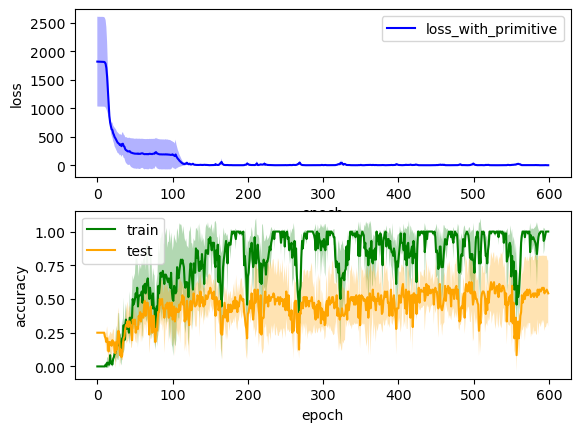

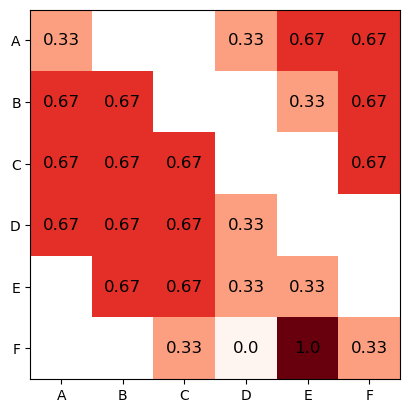

In [78]:
xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

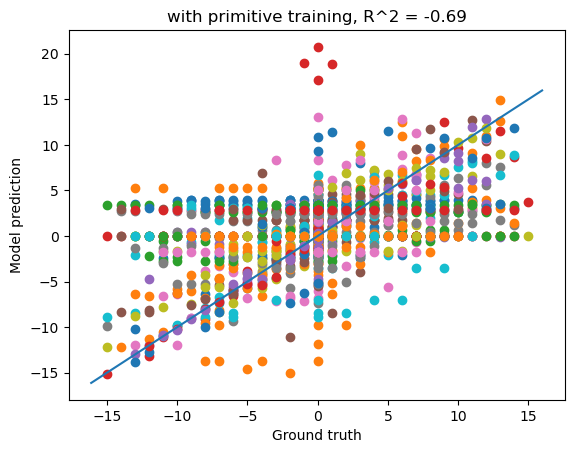

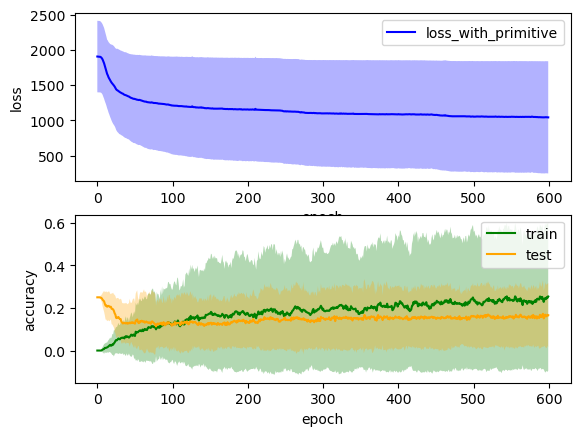

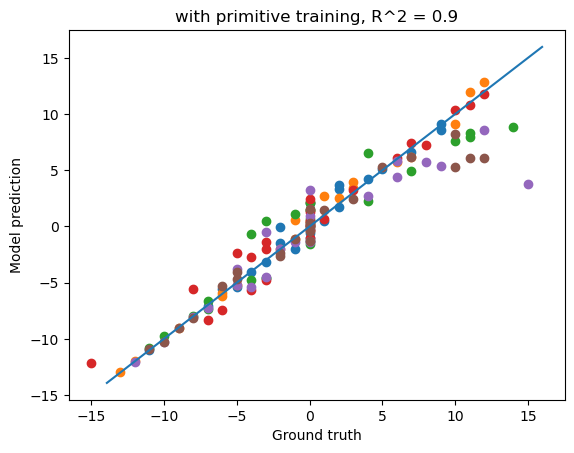

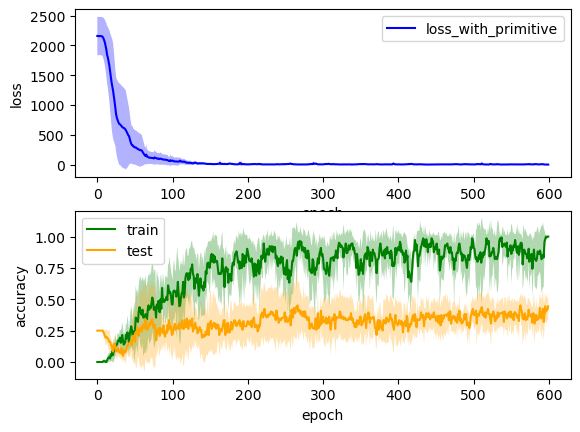

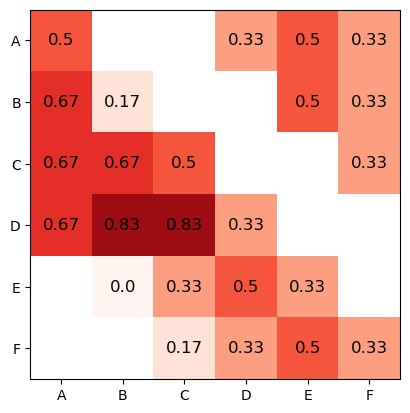

In [79]:
xavier_gain = 0.0001

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

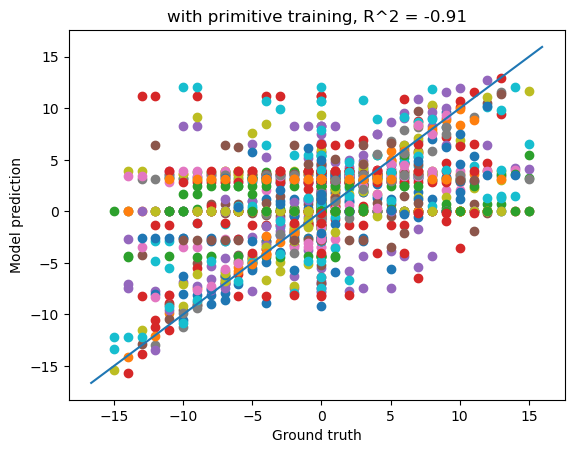

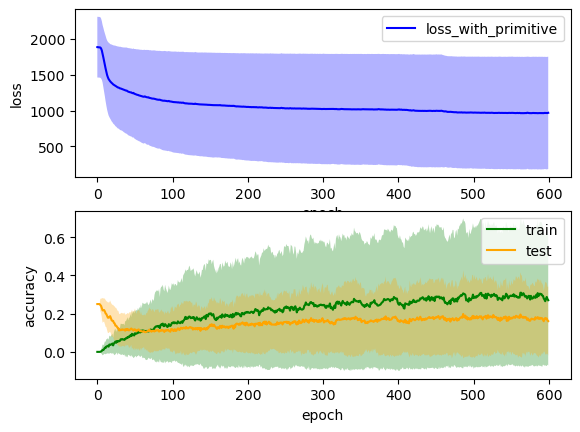

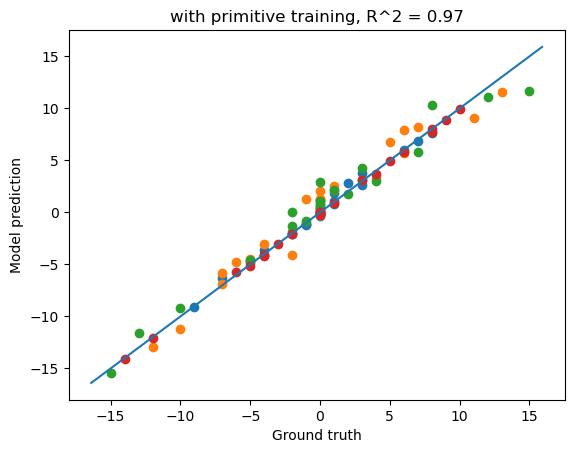

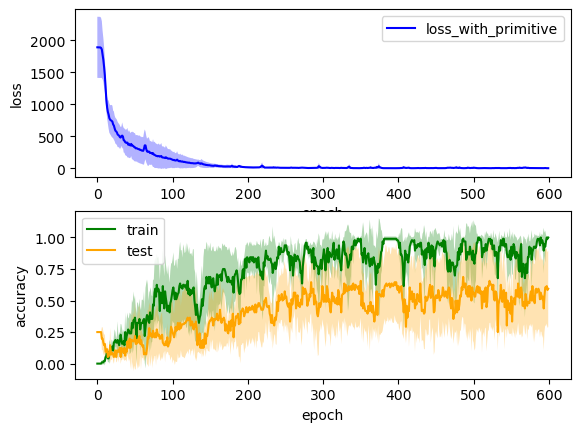

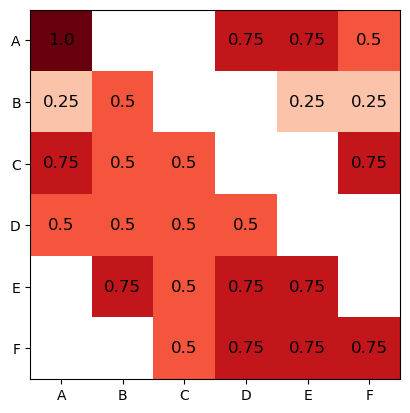

In [80]:
xavier_gain = 0.00001

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

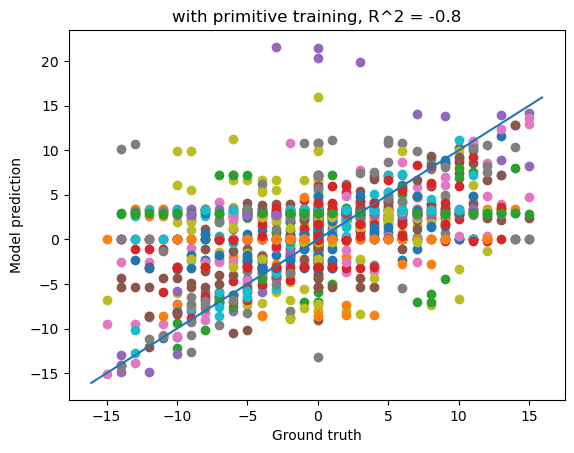

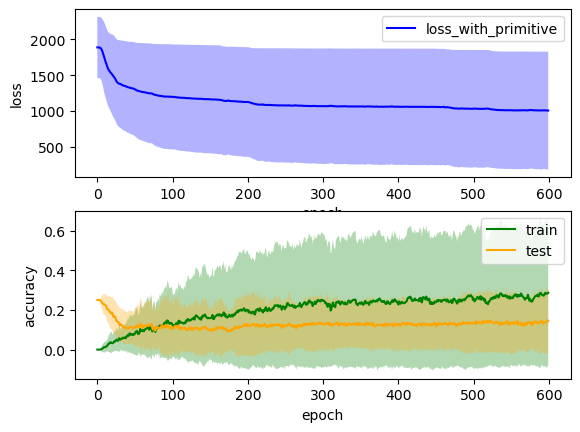

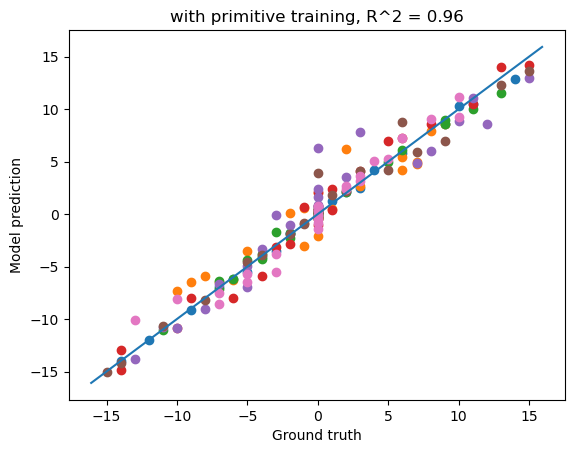

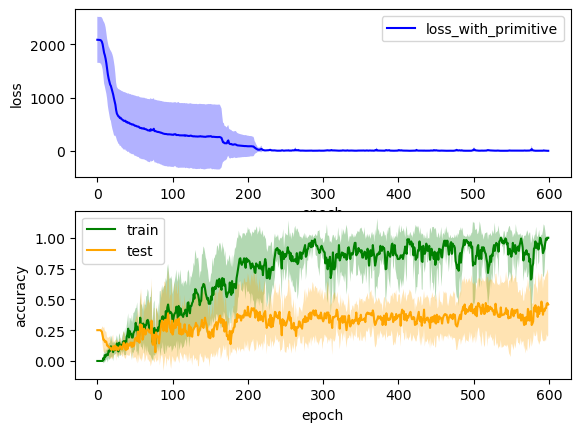

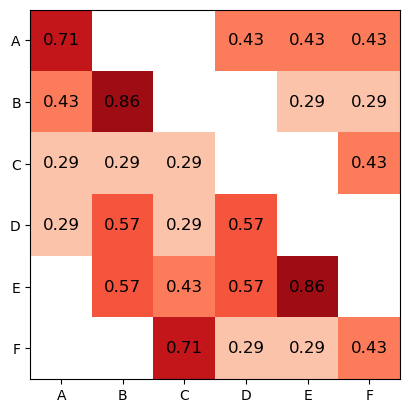

In [81]:
xavier_gain = 0.000001

trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

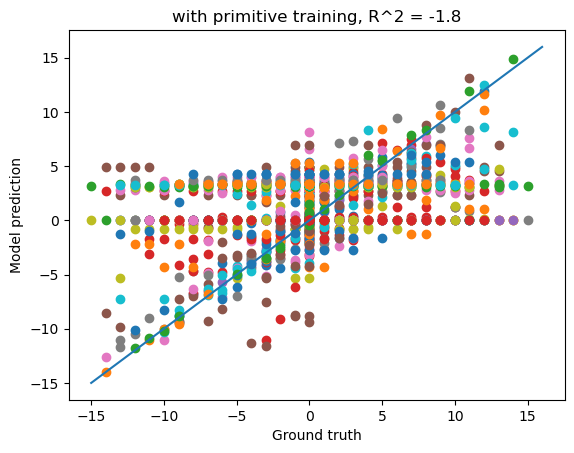

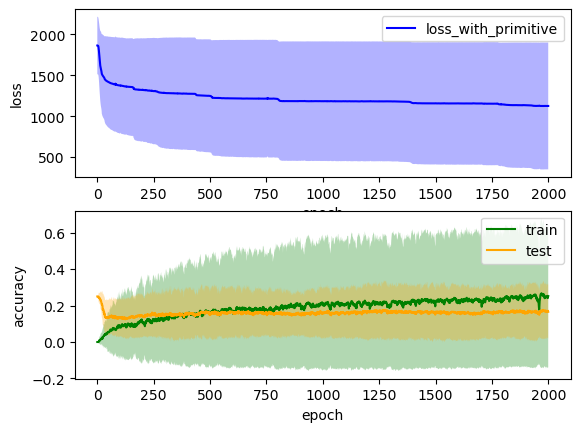

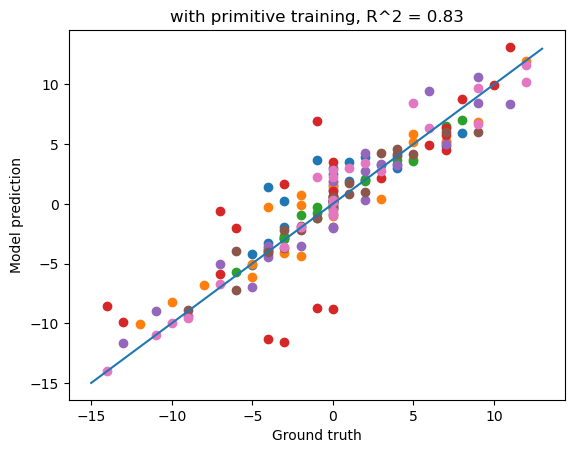

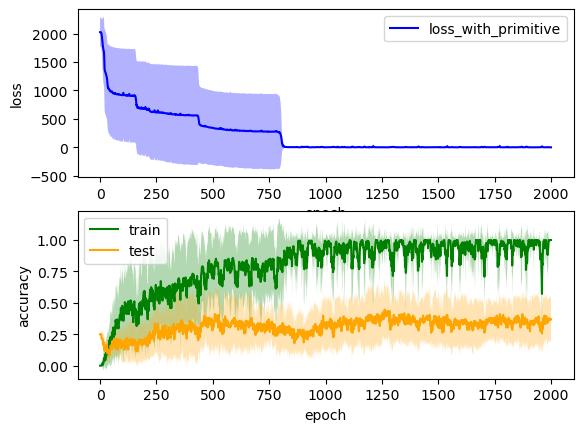

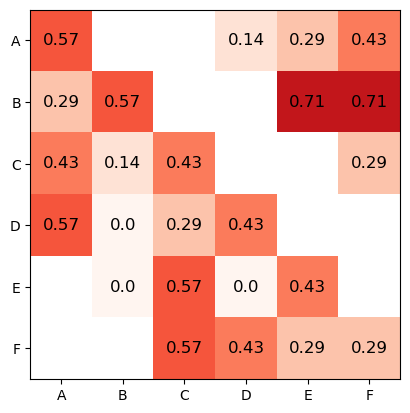

In [82]:
xavier_gain = 0.00001
epochs = 2000
trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

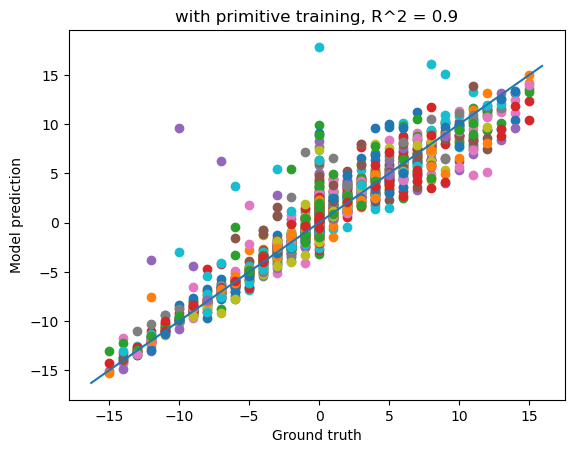

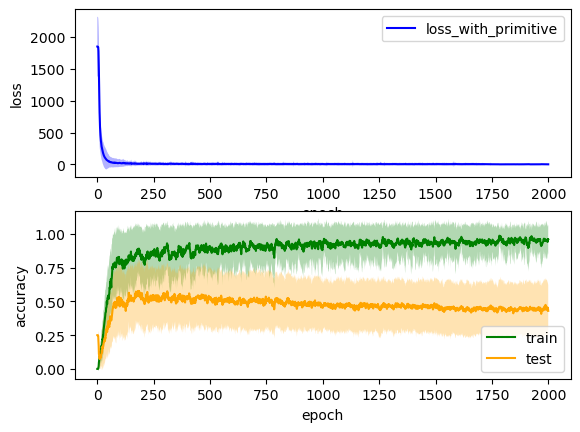

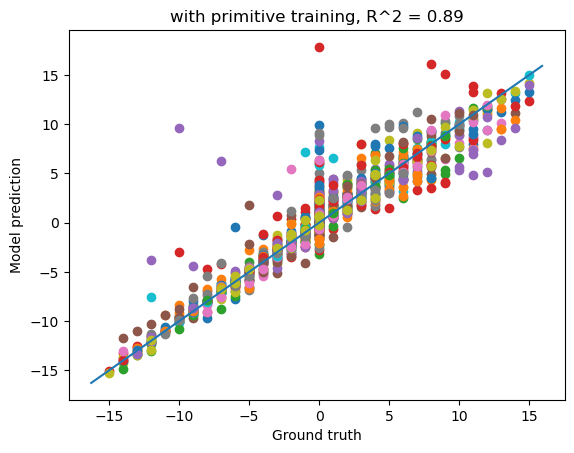

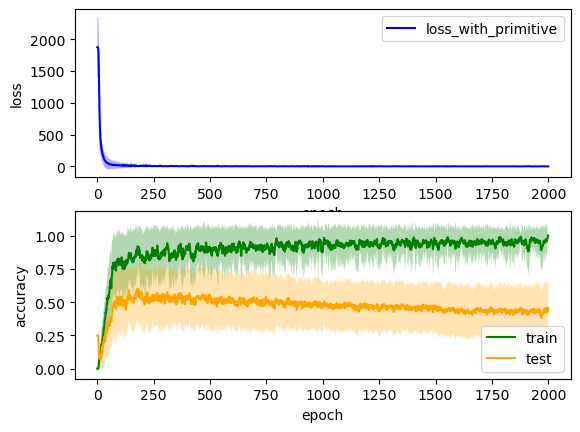

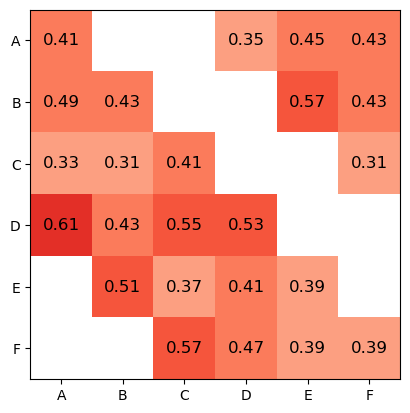

In [83]:
xavier_gain = 0.1
epochs = 2000
trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

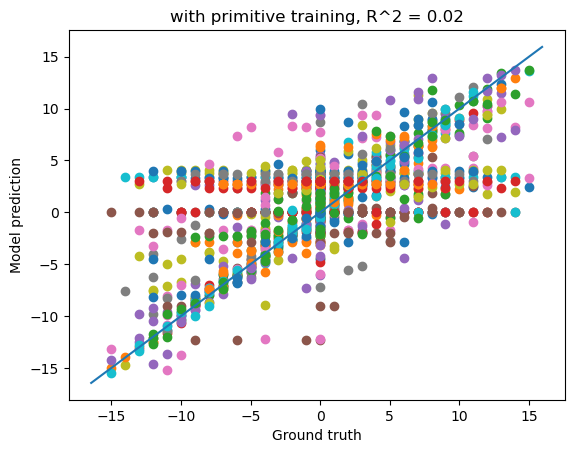

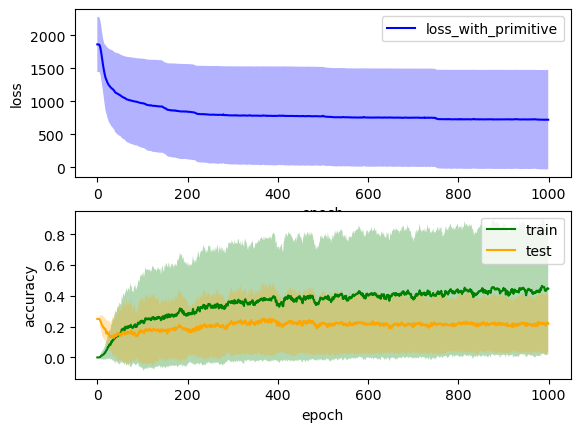

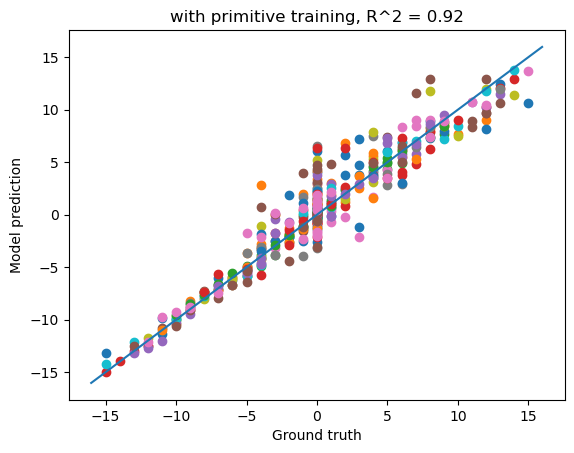

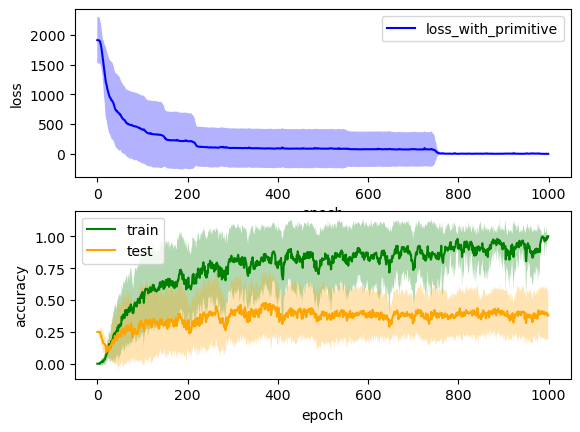

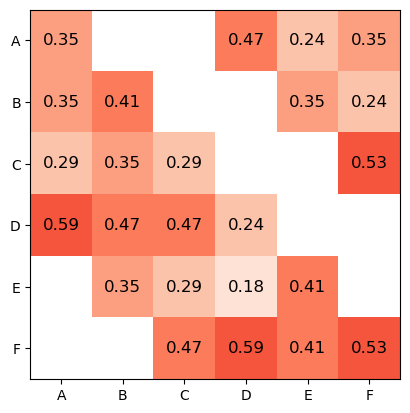

In [85]:
xavier_gain = 0.01
epochs = 1000
trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

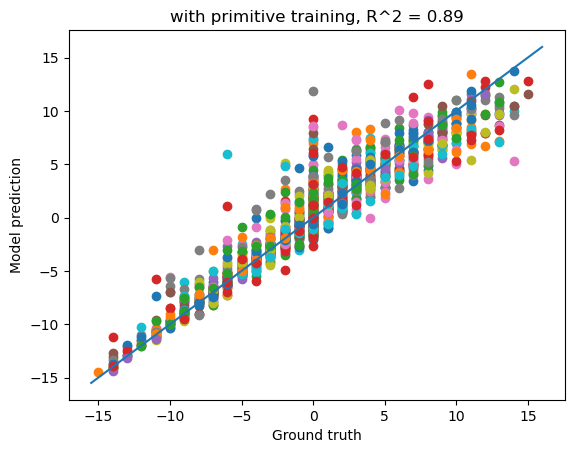

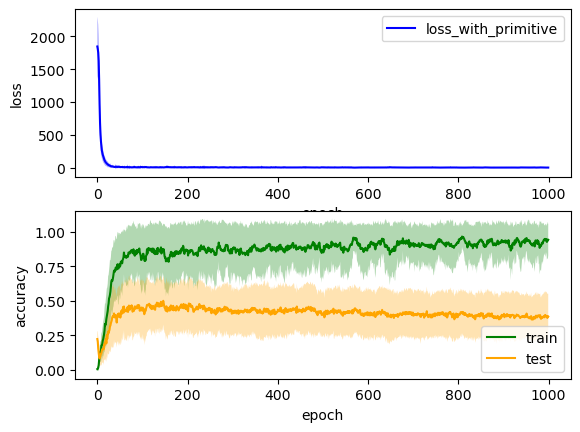

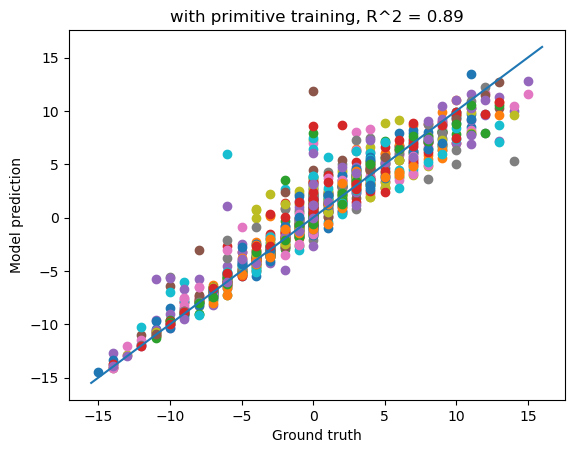

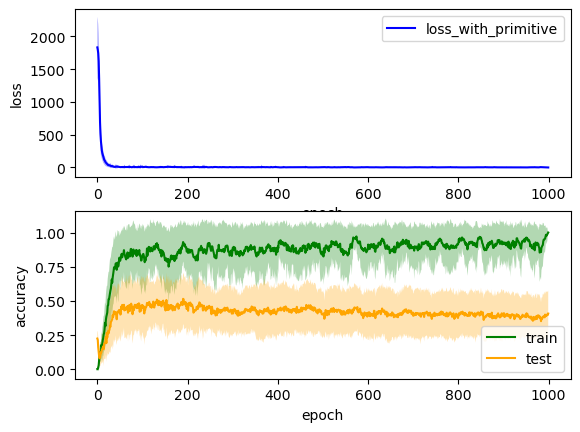

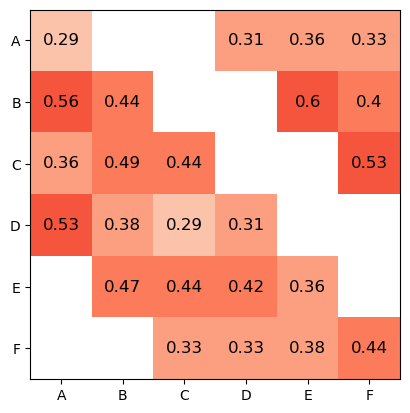

In [86]:
xavier_gain = 1
epochs = 1000
trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

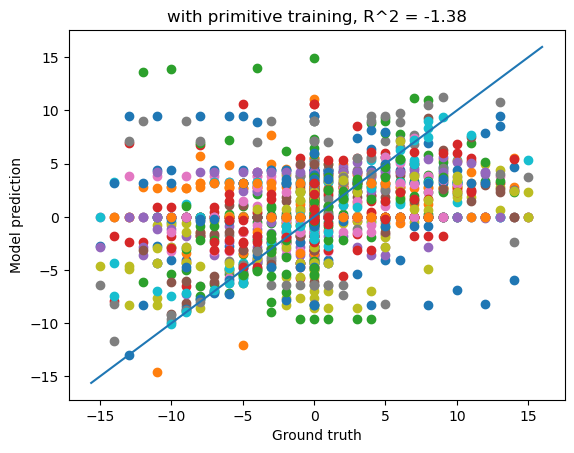

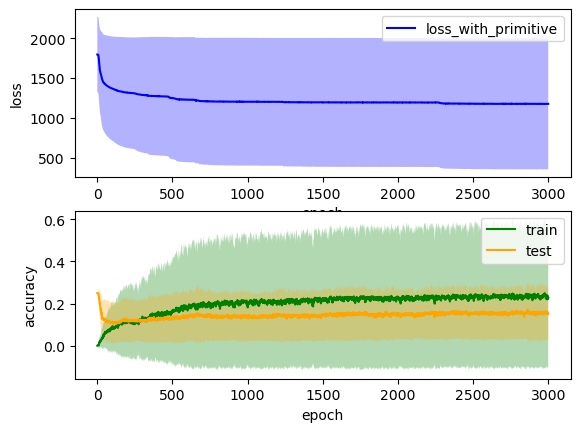

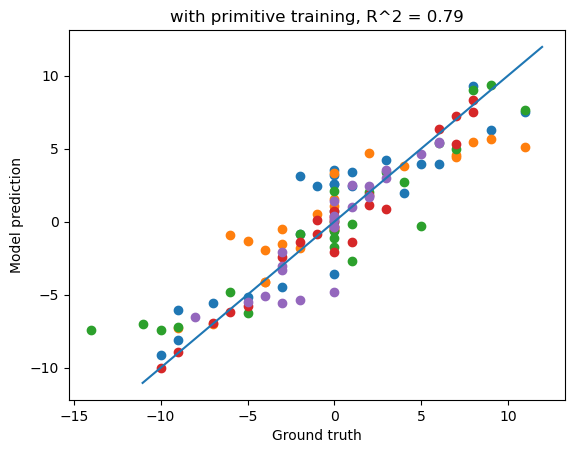

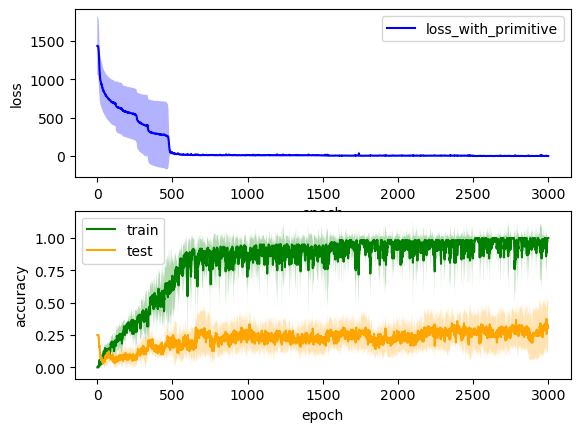

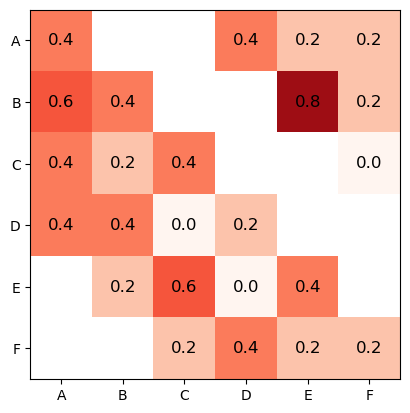

In [88]:
xavier_gain = 0.00001
epochs = 3000
hidden_size = 10
trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -9], ['B', ('-', 'C'), '=', 5], ['C', ('-', 'D'), '=', -4], ['D', ('-', 'E'), '=', 5], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'A'), '=', 6], ['A', ('-', 'C'), '=', -4], ['B', ('-', 'D'), '=', 1], ['C', ('-', 'E'), '=', 1], ['D', ('-', 'F'), '=', 2], ['E', ('-', 'A'), '=', 3], ['F', ('-', 'B'), '=', -3], [('-', 'A'), '=', -8], [('-', 'B'), '=', -17], [('-', 'C'), '=', -12], [('-', 'D'), '=', -16], [('-', 'E'), '=', -11], [('-', 'F'), '=', -14], ['A', '=', 8], ['B', '=', 17], ['C', '=', 12], ['D', '=', 16], ['E', '=', 11], ['F', '=', 14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'D'), '=', -8], ['A', ('-', 'E'), '=', -3], ['A', ('-', 'F'), '=', -6], ['B', ('-', 'A'), '=', 9], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'E'), '=', 6], ['B', ('-', 'F'), '=', 3], ['C', ('-', 'A'), '=', 4], ['C', ('-', 'B'), '=', -5], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'F'), '=', -2], ['D', ('-', 'A'), '=', 8], ['D', ('-', 'B'), '=', -1], ['D', ('-', 'C'), '=', 4],

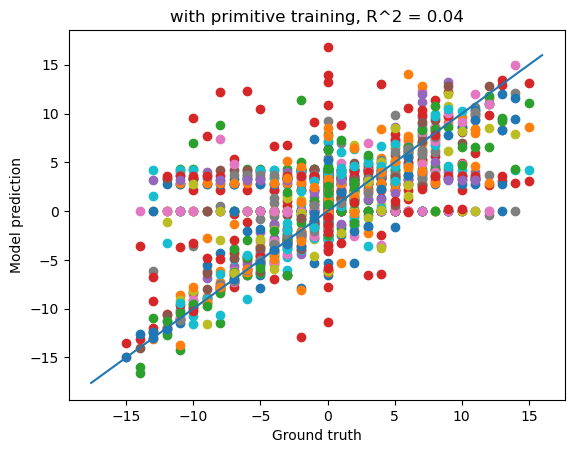

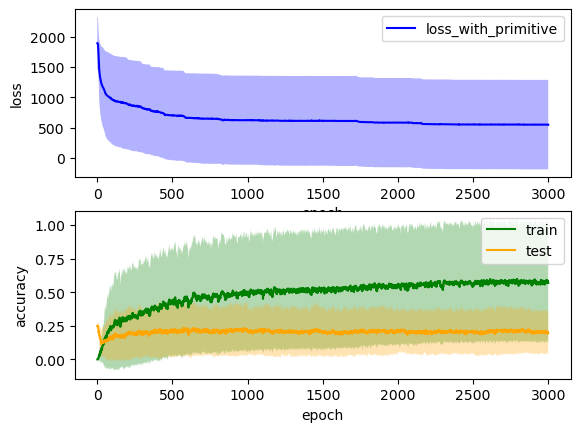

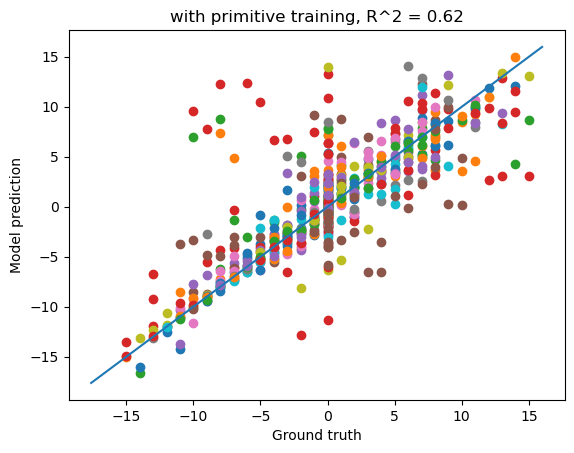

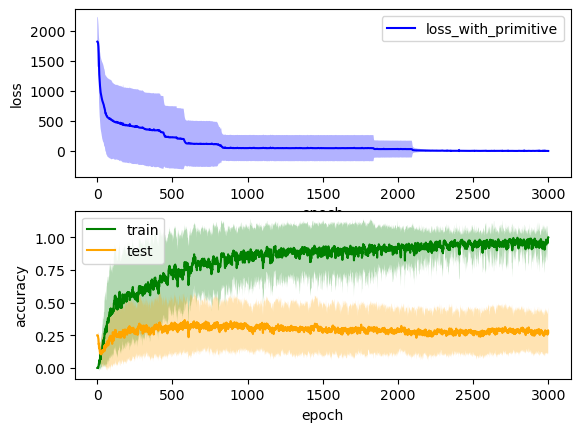

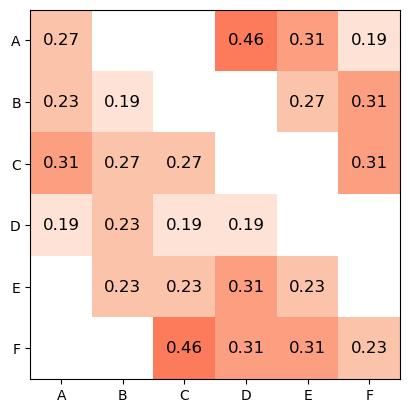

In [89]:
xavier_gain = 0.00001
epochs = 3000
hidden_size = 30
trainseqs = generate_other(ops, all_syms, cue_dict)+ generate_other_reverse(ops, all_syms, cue_dict)+neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [51]:
hidden_size = 12

trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', -7], ['B', ('-', 'C'), '=', 3], ['C', ('-', 'D'), '=', -9], ['D', ('-', 'E'), '=', 11], ['E', ('-', 'F'), '=', -3], ['F', ('-', 'G'), '=', -3], ['G', ('-', 'H'), '=', -1], ['H', ('-', 'I'), '=', -1], ['I', ('-', 'J'), '=', 9], ['J', ('-', 'A'), '=', 1], [('-', 'A'), '=', -4], [('-', 'B'), '=', -11], [('-', 'C'), '=', -8], [('-', 'D'), '=', -17], [('-', 'E'), '=', -6], [('-', 'F'), '=', -9], [('-', 'G'), '=', -12], [('-', 'H'), '=', -13], [('-', 'I'), '=', -14], [('-', 'J'), '=', -5], ['A', '=', 4], ['B', '=', 11], ['C', '=', 8], ['D', '=', 17], ['E', '=', 6], ['F', '=', 9], ['G', '=', 12], ['H', '=', 13], ['I', '=', 14], ['J', '=', 5]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -4], ['A', ('-', 'D'), '=', -13], ['A', ('-', 'E'), '=', -2], ['A', ('-', 'F'), '=', -5], ['A', ('-', 'G'), '=', -8], ['A', ('-', 'H'), '=', -9], ['A', ('-', 'I'), '=', -10], ['A', ('-', 'J'), '=', -1], ['B', ('-', 'A'), '=', 7], ['B', ('-', 'B'), '=', 0], ['B

KeyboardInterrupt: 

In [ ]:
hidden_size = 15

trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [ ]:
hidden_size = 10

trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [ ]:
hidden_size = 20

trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [38]:
# hidden size = 15

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  8.265526147683461
6


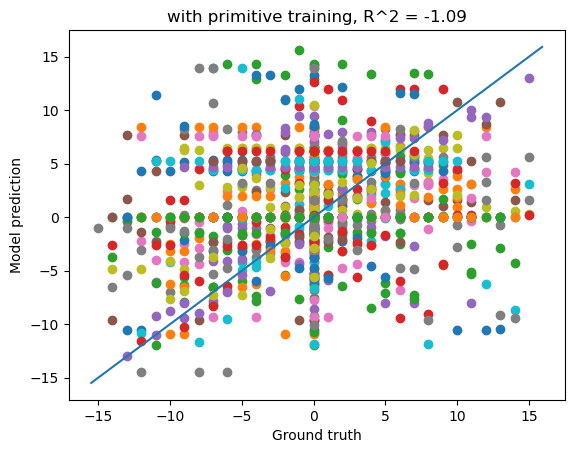

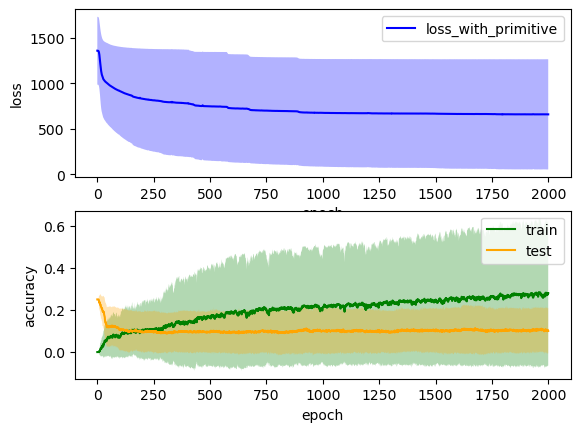

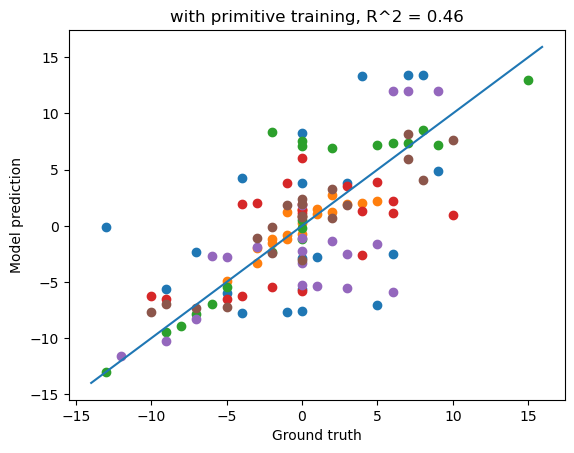

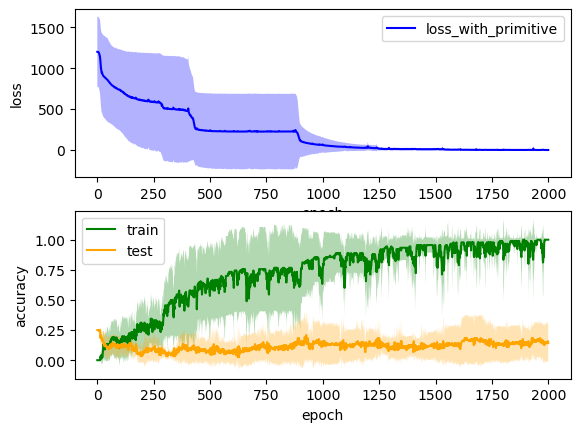

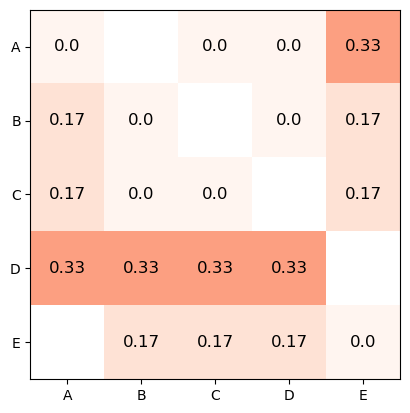

In [40]:
epochs = 2000
hidden_size = 15
trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  8.460118448734283
11


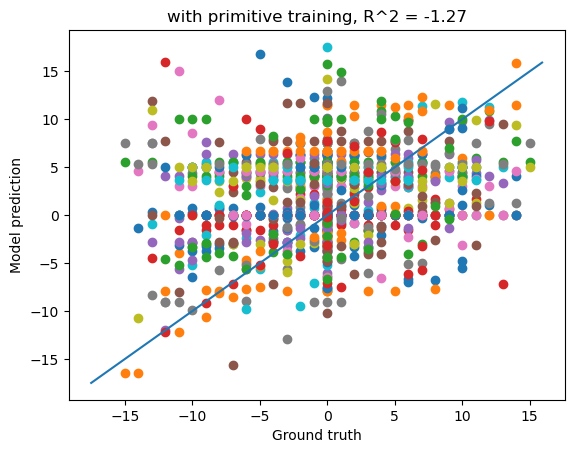

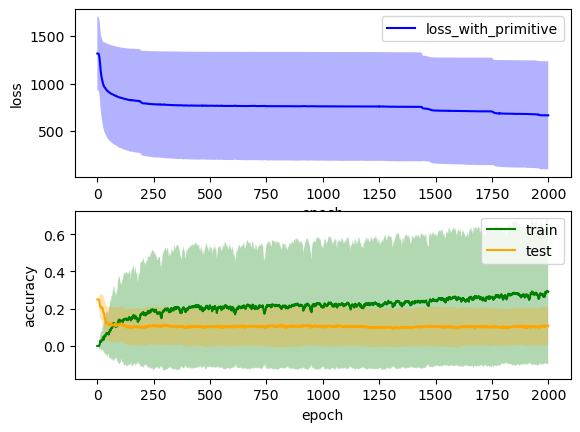

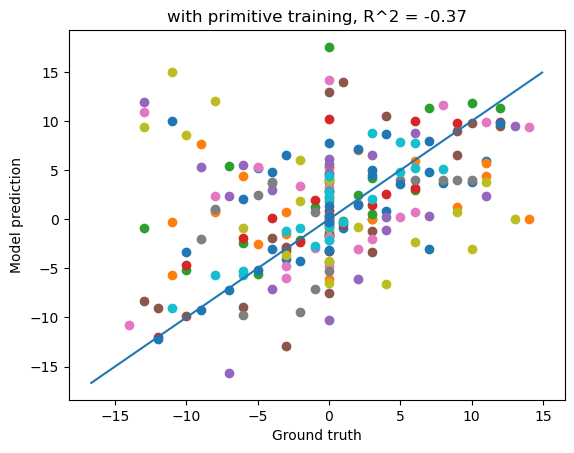

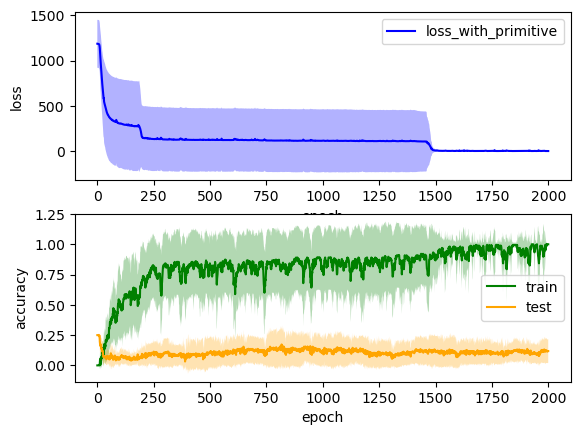

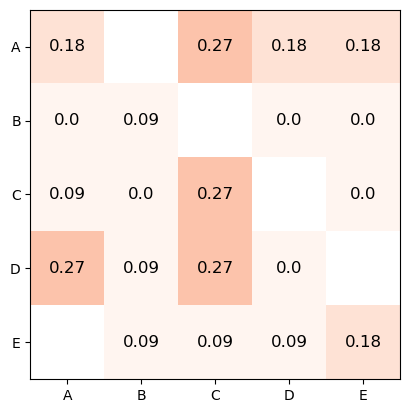

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  8.243152829011281
7


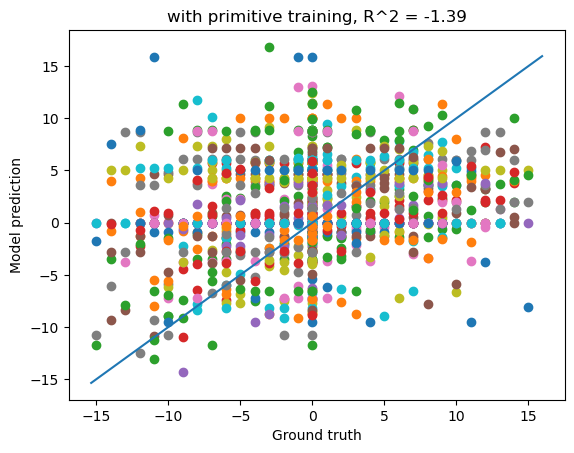

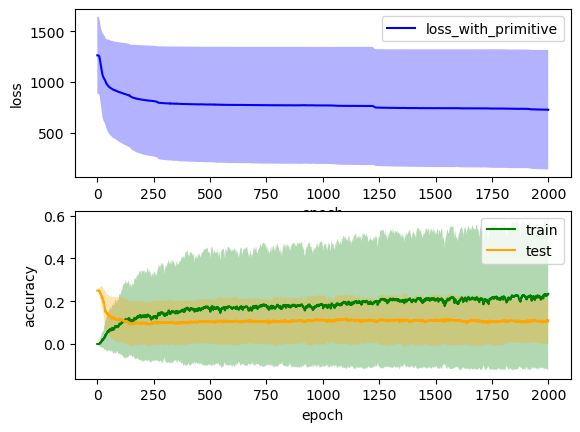

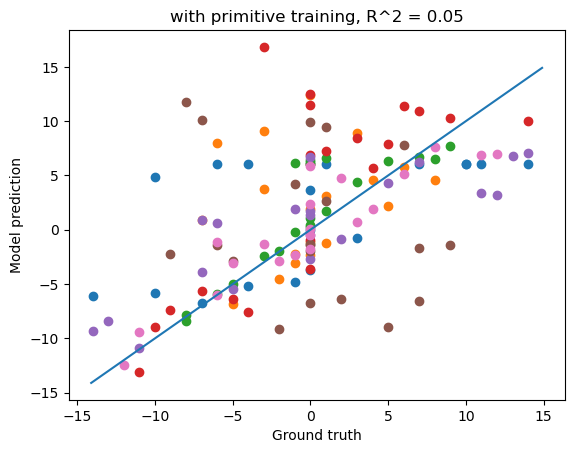

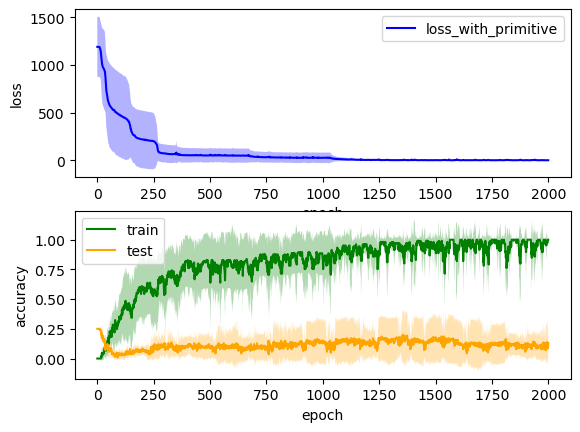

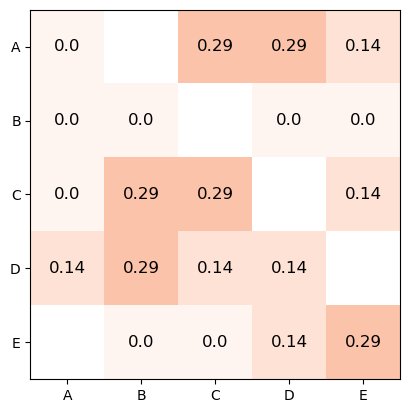

In [41]:
xavier_gain = 0.001
trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  8.305304102102916
3


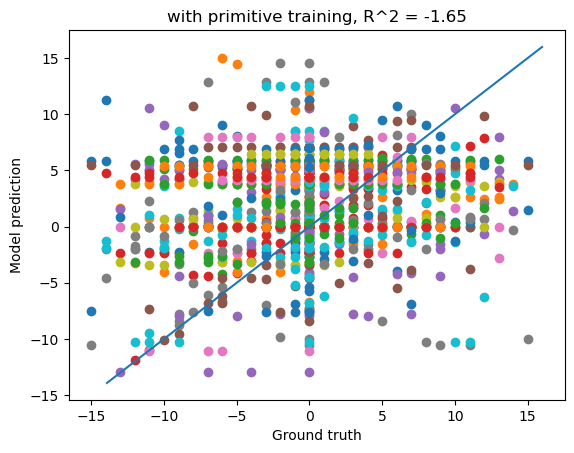

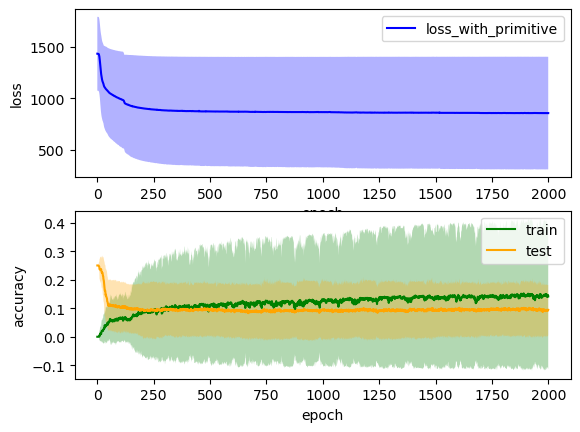

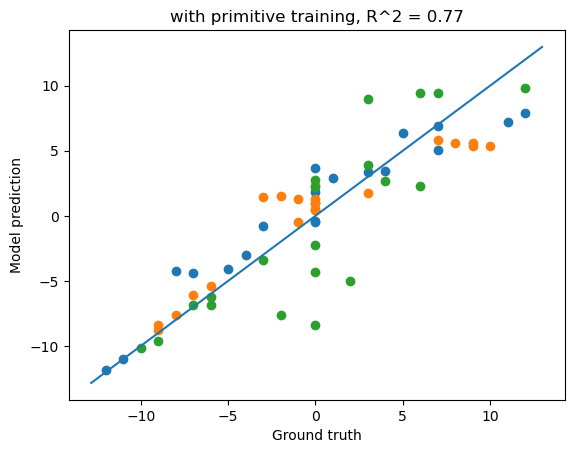

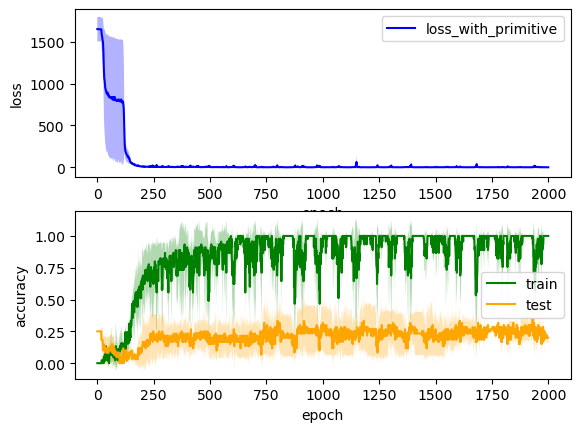

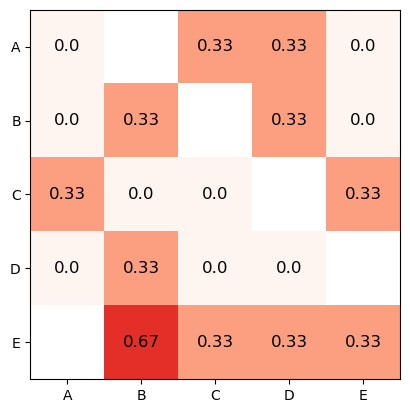

In [42]:
xavier_gain = 0.00001
trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  8.645158048470815
9


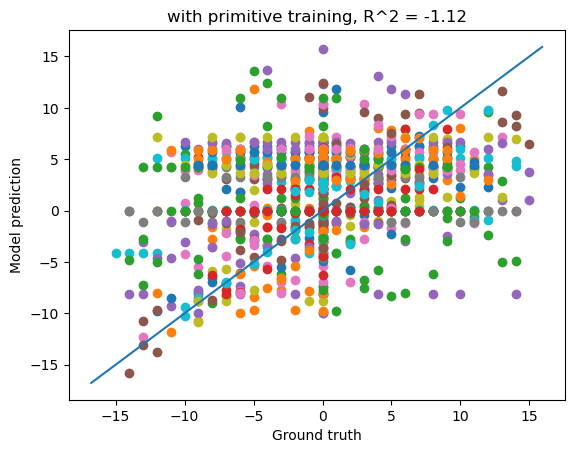

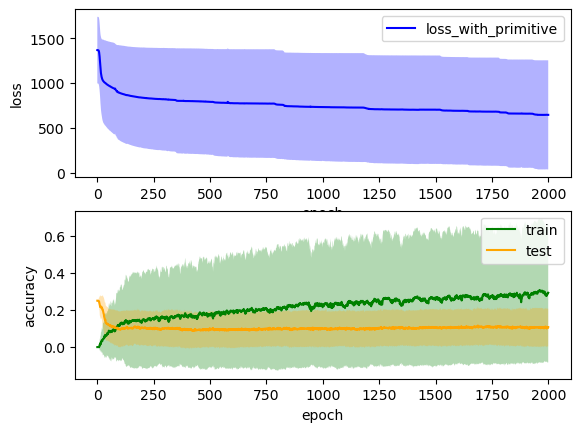

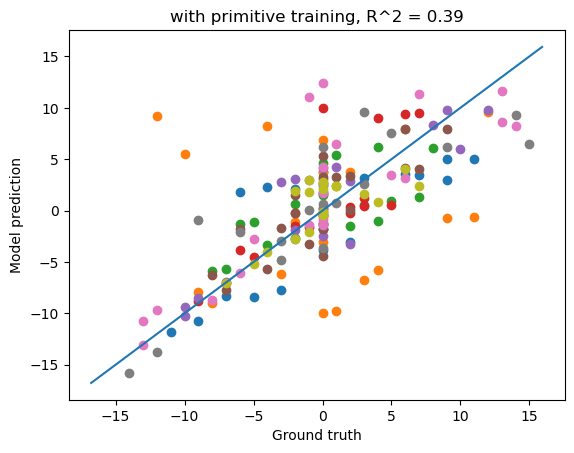

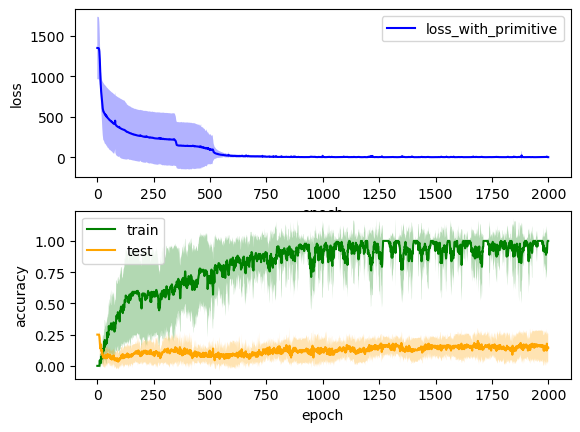

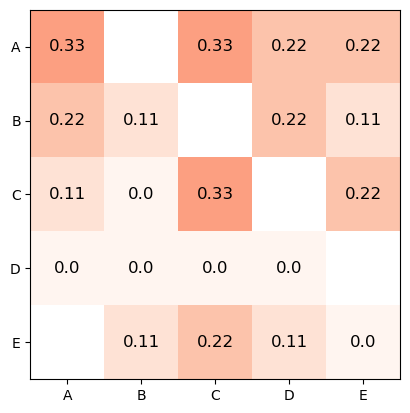

In [44]:
xavier_gain = 0.0001
hidden_size = 20
trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]


/Users/miahannah/opt/anaconda3/lib/python3.8/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


run time:  251.57591257890064
18


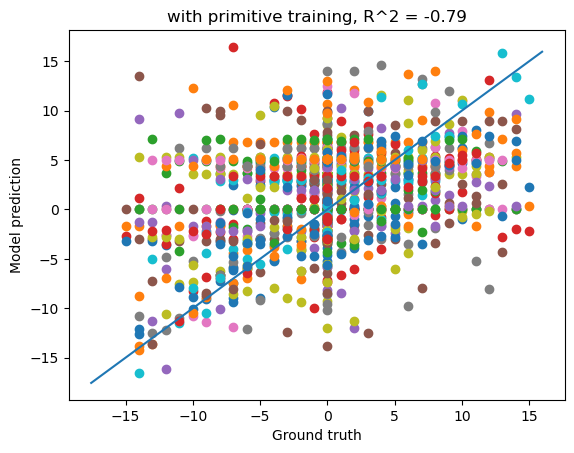

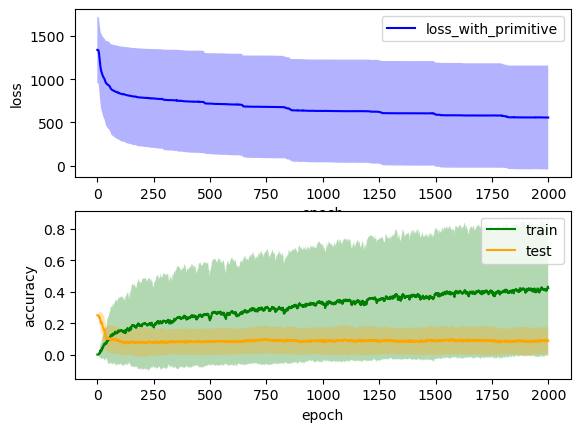

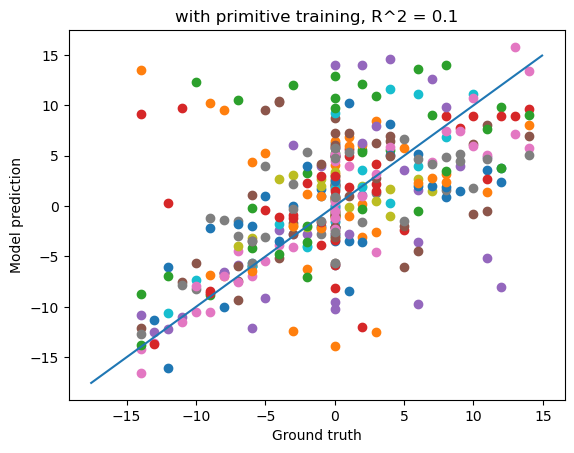

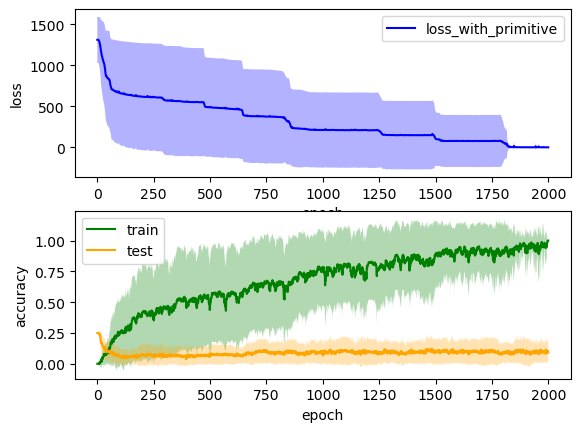

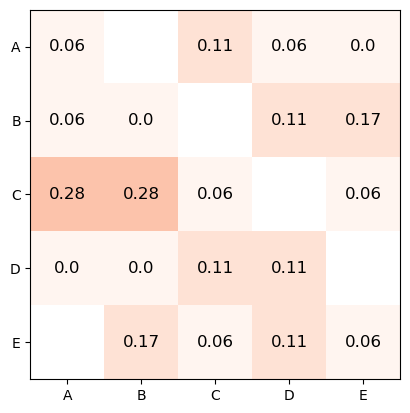

In [47]:
xavier_gain = 0.0001
hidden_size = 25
trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  8.454823939005534
18


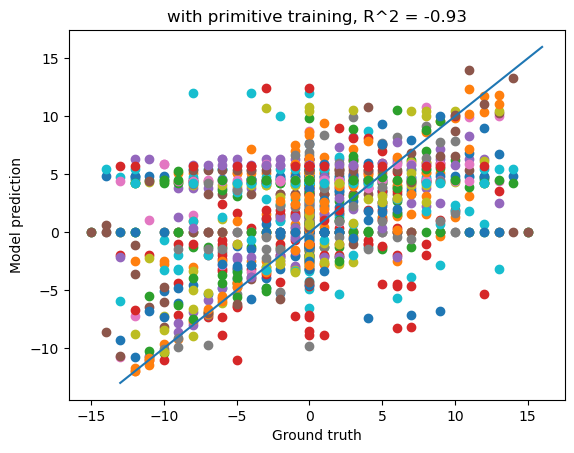

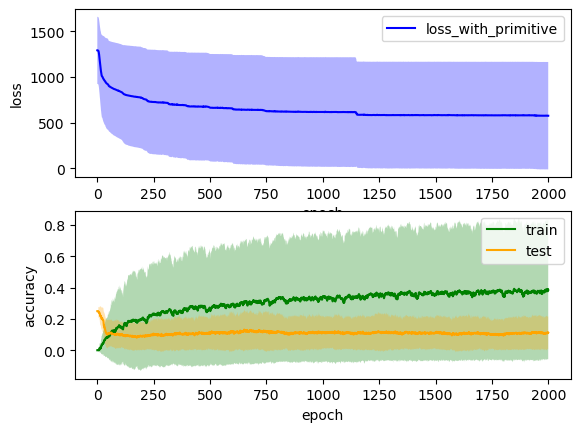

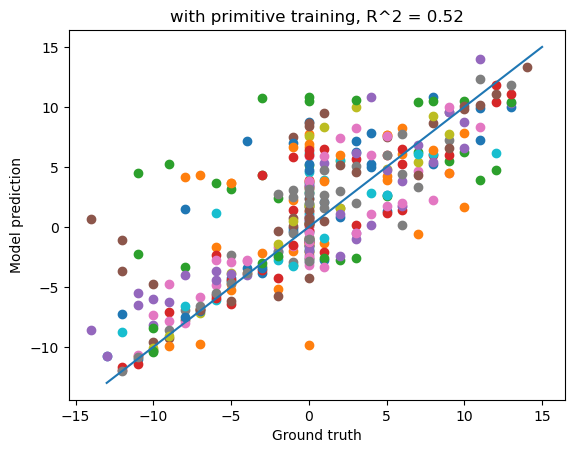

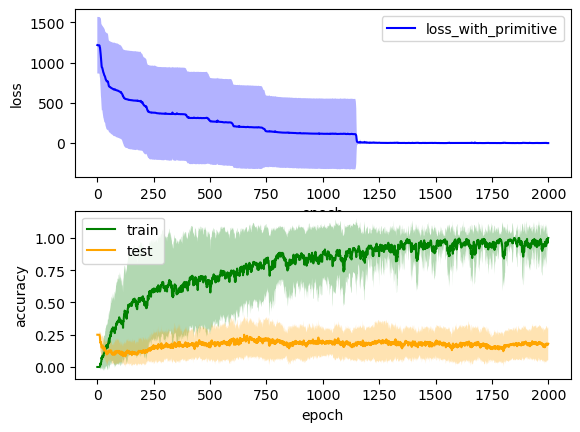

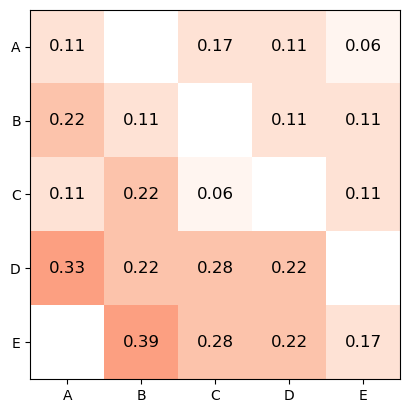

In [45]:
xavier_gain = 0.0001
hidden_size = 30
trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  57.18777793645859
2


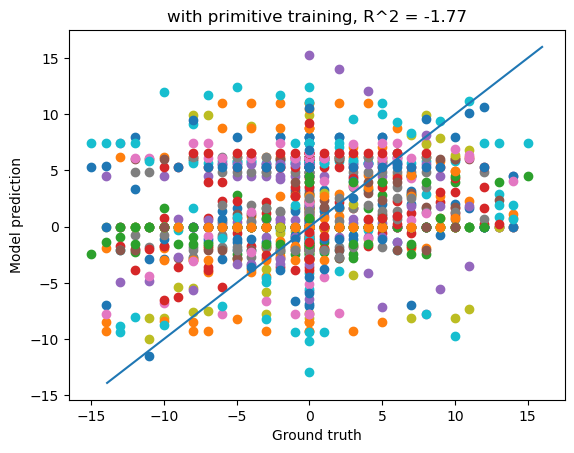

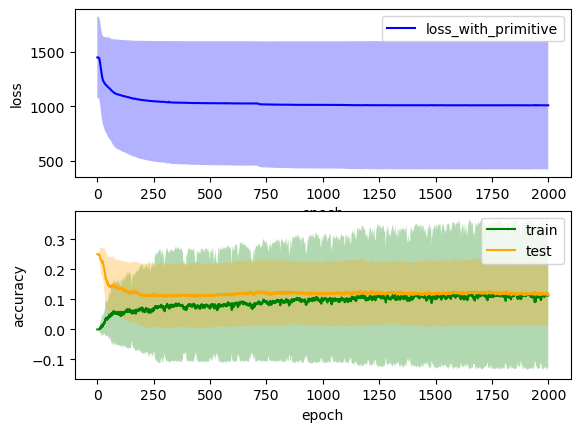

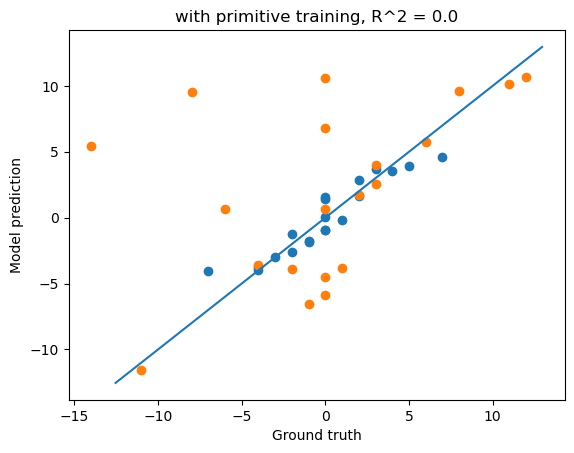

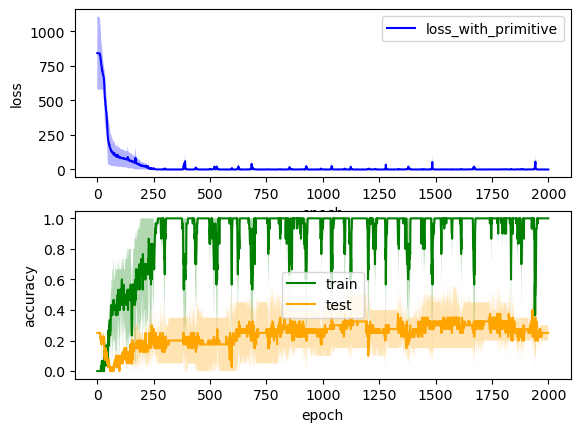

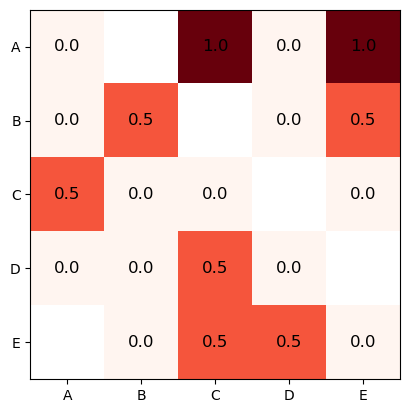

In [46]:
xavier_gain = 0.0001
hidden_size = 10
trainseqs = generate_other(ops, all_syms, cue_dict)+ neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  10.177681199709575
3


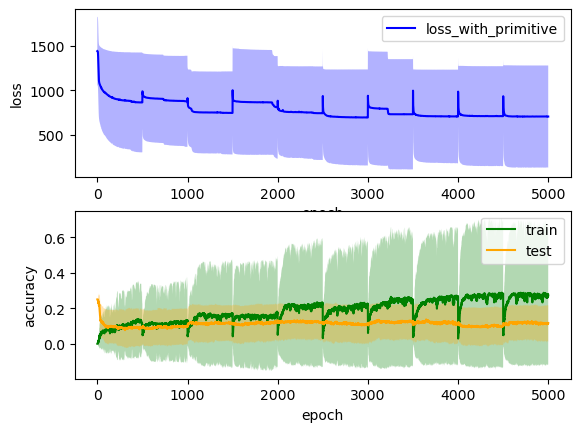

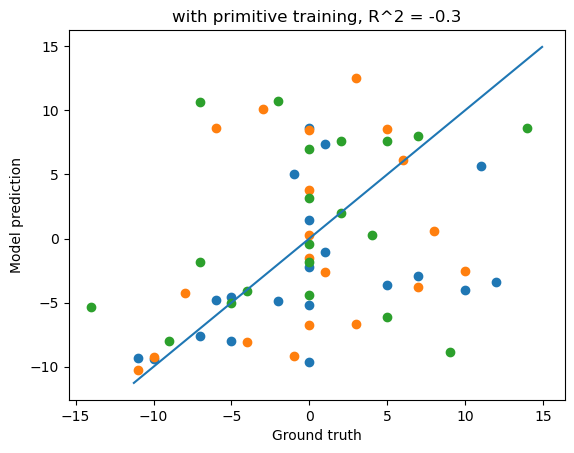

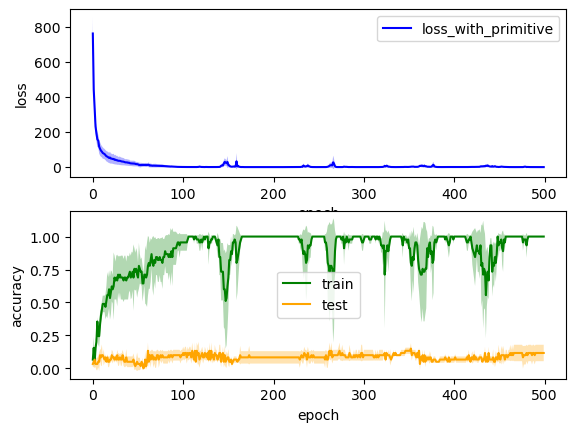

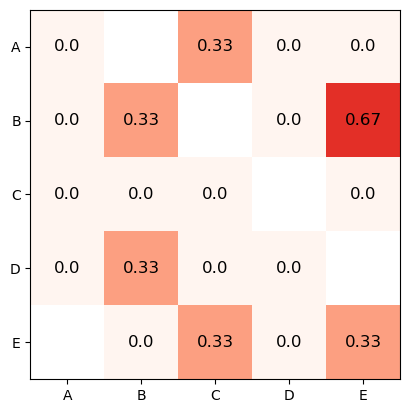

In [16]:
# other
epochs = 500
num_sims = 32
num_episodes = 10
xavier_gain = 0.001
hidden_size = 20

trainseqs = generate_other(ops, all_syms, cue_dict)+ primitives+ neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  66.29198379913966
3


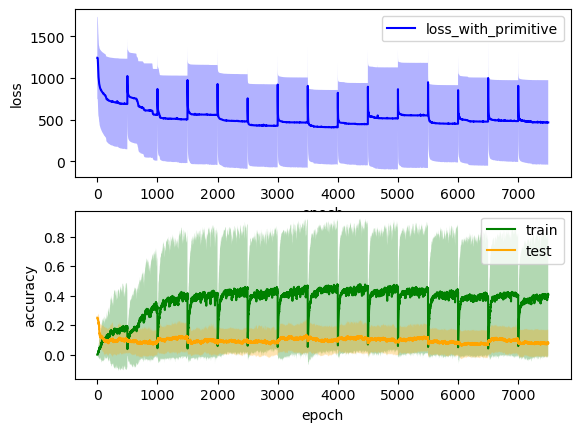

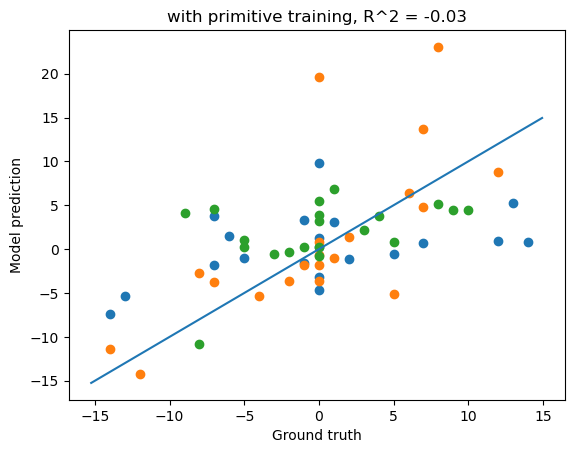

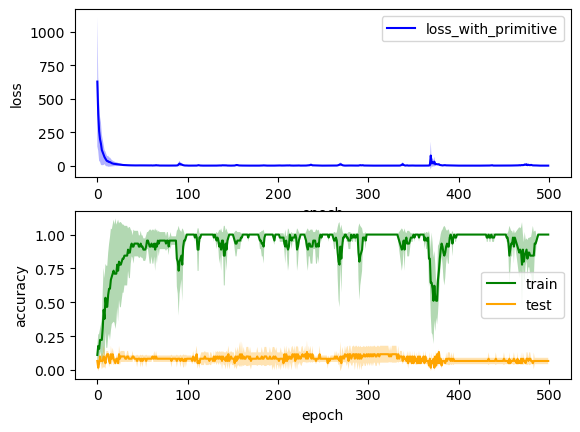

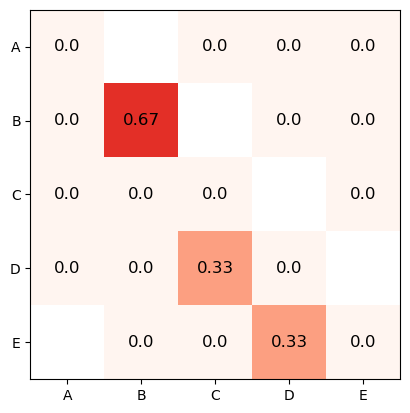

In [17]:
# other
epochs = 500
num_sims = 32
num_episodes = 15
xavier_gain = 0.001
hidden_size = 20

trainseqs = generate_other(ops, all_syms, cue_dict)+ primitives+ neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 8], ['B', ('-', 'C'), '=', -4], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'E'), '=', -1], ['E', ('-', 'A'), '=', -9], ['A', '=', 16], ['B', '=', 15], ['C', '=', 13], ['D', '=', 9], ['E', '=', 7], [('-', 'A'), '=', -16], [('-', 'B'), '=', -15], [('-', 'C'), '=', -13], [('-', 'D'), '=', -9], [('-', 'E'), '=', -7]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 4], ['A', ('-', 'D'), '=', 10], ['A', ('-', 'E'), '=', 9], ['B', ('-', 'A'), '=', -8], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', 2], ['B', ('-', 'E'), '=', 1], ['C', ('-', 'A'), '=', -4], ['C', ('-', 'B'), '=', 4], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'E'), '=', 5], ['D', ('-', 'A'), '=', -10], ['D', ('-', 'B'), '=', -2], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0], ['E', ('-', 'B'), '=', -1], ['E', ('-', 'C'), '=', -5], ['E', ('-', 'D'), '=', 1], ['E', ('-', 'E'), '=', 0]]
run time:  32.60551264683406
5


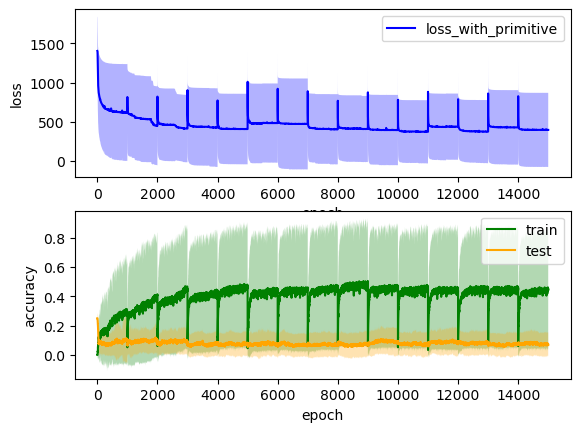

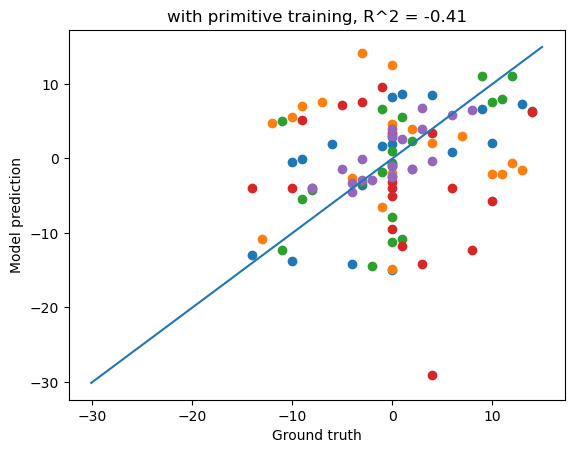

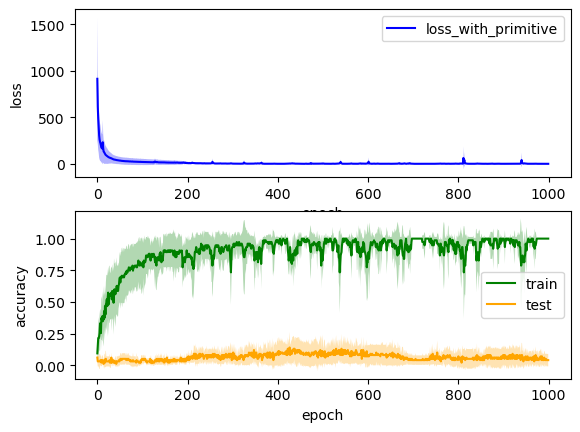

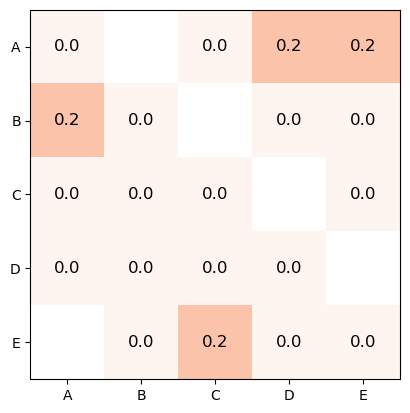

In [18]:
# other
epochs = 1000
num_sims = 32
num_episodes = 15
xavier_gain = 0.001
hidden_size = 20

trainseqs = generate_other(ops, all_syms, cue_dict)+ primitives+ neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [12]:
run_exp(trainseqs, testseqs, cue_dict, xavier_gain, num_episodes)

NameError: name 'tests' is not defined

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  0.8039043148358663
31


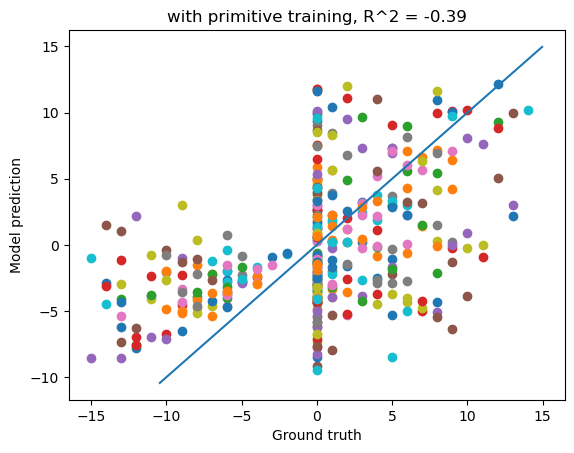

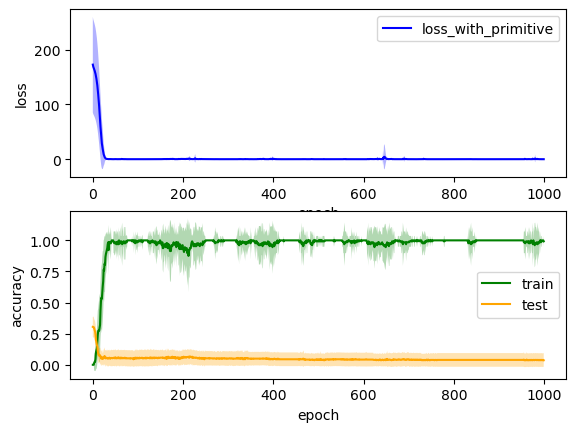

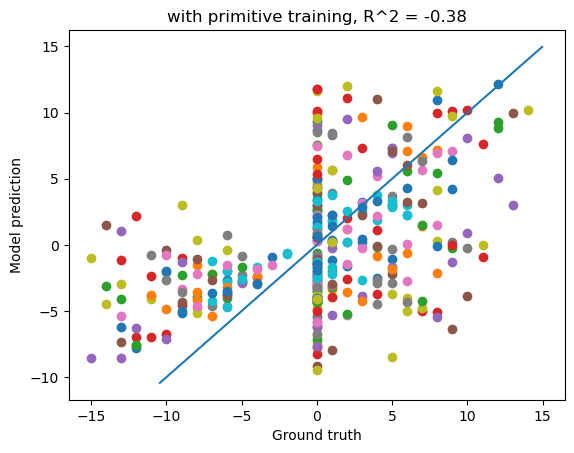

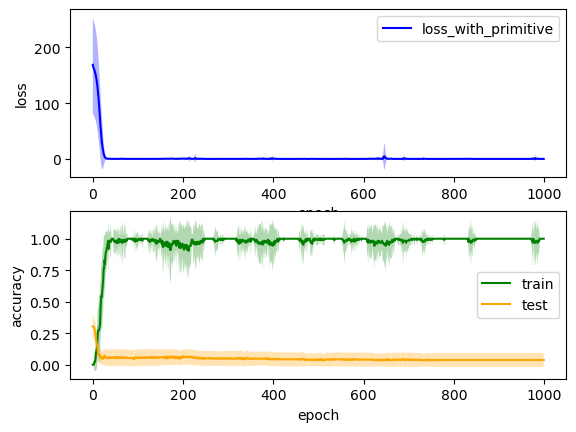

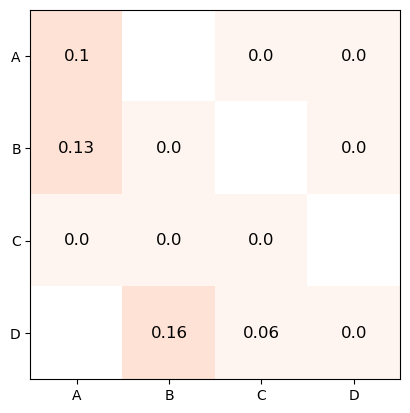

In [49]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms, cue_dict)+ primitives+ neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [ ]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 1

trainseqs = generate_other(ops, all_syms, cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 13], ['B', ('-', 'C'), '=', -7], ['C', ('-', 'D'), '=', -3], ['D', ('-', 'E'), '=', -4], ['E', ('-', 'F'), '=', 12], ['F', ('-', 'G'), '=', -4], ['G', ('-', 'H'), '=', 3], ['H', ('-', 'I'), '=', -5], ['I', ('-', 'J'), '=', 7], ['J', ('-', 'K'), '=', -11], ['K', ('-', 'L'), '=', 1], ['L', ('-', 'A'), '=', -2], ['A', '=', 16], ['B', '=', 3], ['C', '=', 10], ['D', '=', 13], ['E', '=', 17], ['F', '=', 5], ['G', '=', 9], ['H', '=', 6], ['I', '=', 11], ['J', '=', 4], ['K', '=', 15], ['L', '=', 14], [('-', 'A'), '=', -16], [('-', 'B'), '=', -3], [('-', 'C'), '=', -10], [('-', 'D'), '=', -13], [('-', 'E'), '=', -17], [('-', 'F'), '=', -5], [('-', 'G'), '=', -9], [('-', 'H'), '=', -6], [('-', 'I'), '=', -11], [('-', 'J'), '=', -4], [('-', 'K'), '=', -15], [('-', 'L'), '=', -14]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', 6], ['A', ('-', 'D'), '=', 3], ['A', ('-', 'E'), '=', -1], ['A', ('-', 'F'), '=', 11], ['A', ('-', 'G'), '=', 7], ['A', ('-

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.160587481657664
32


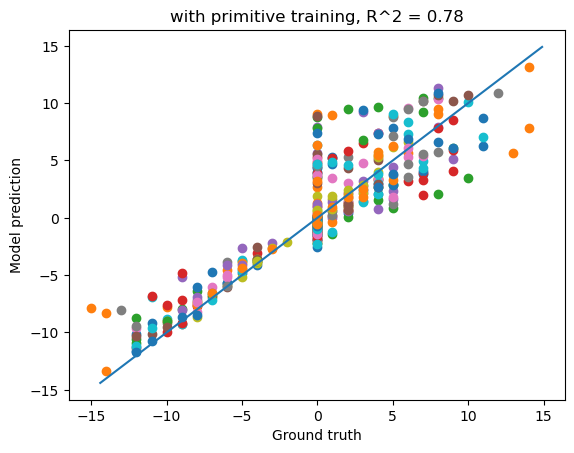

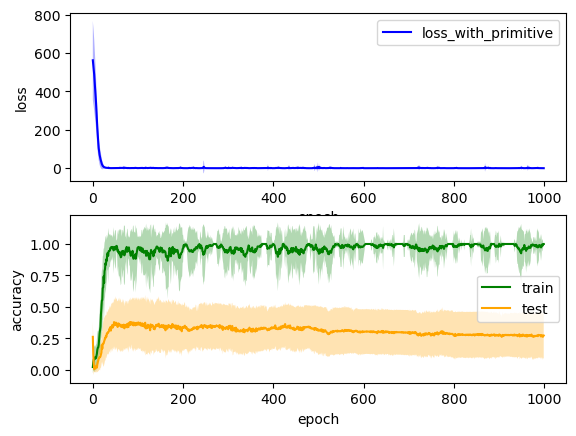

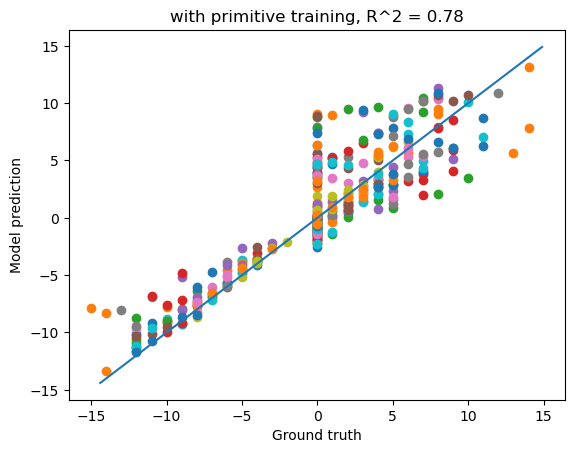

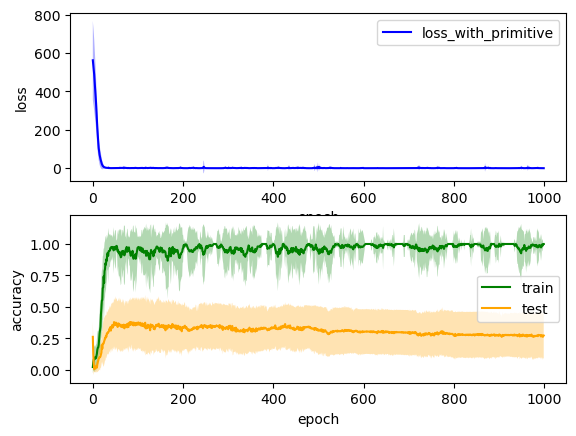

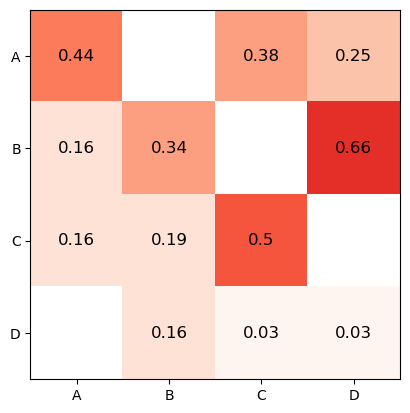

In [51]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 1

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.2048442324002584
28


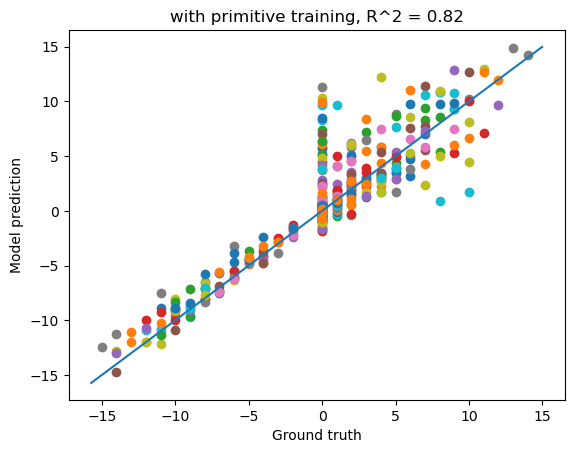

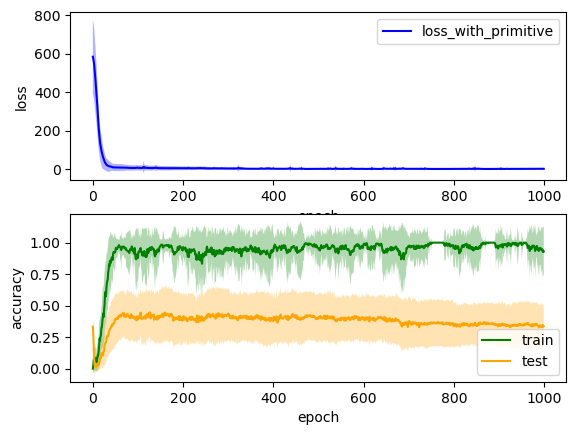

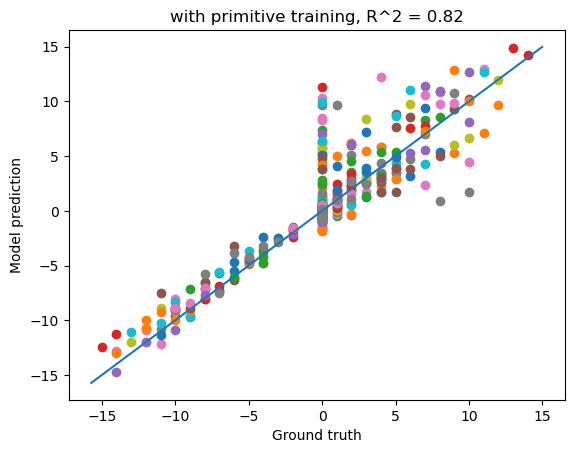

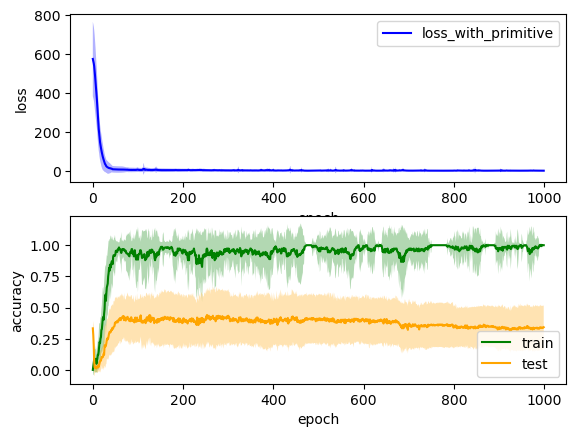

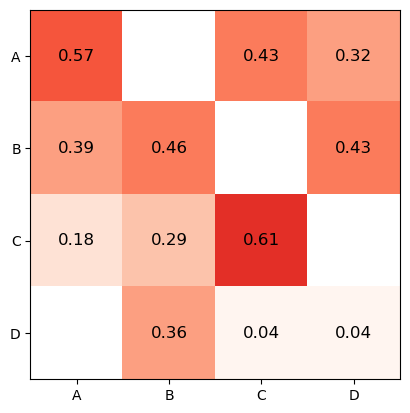

In [59]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.5

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  8.583308883508046
27


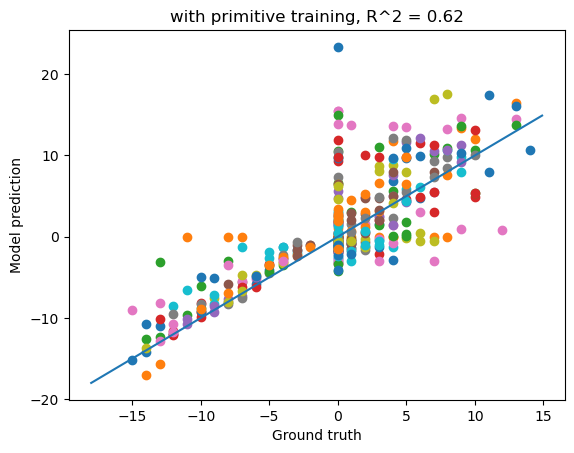

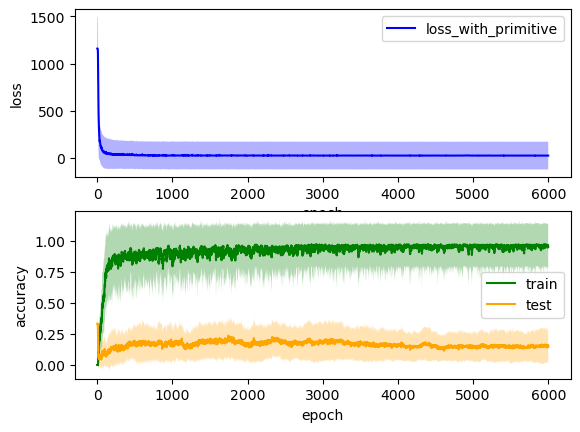

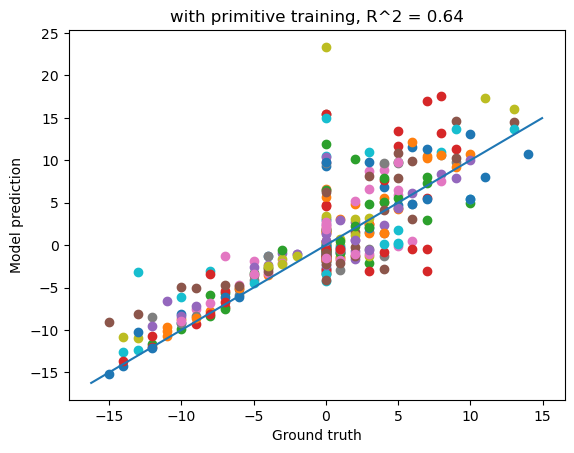

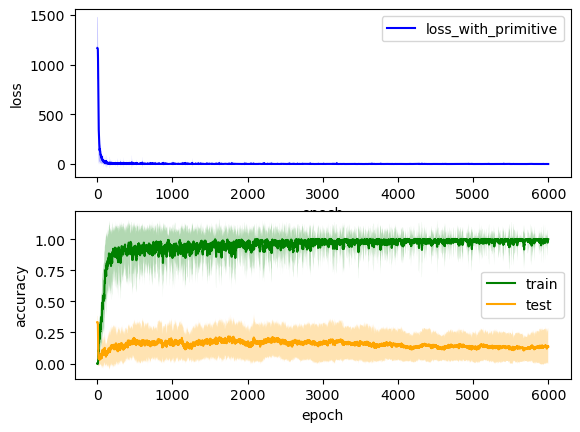

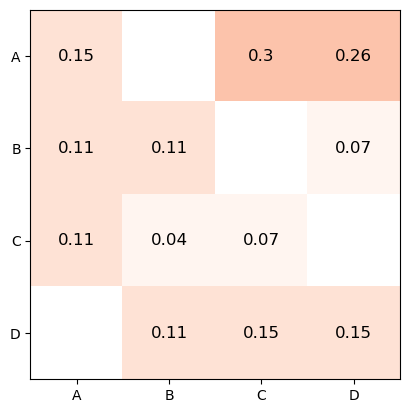

In [56]:
# other
# other
epochs = 6000
num_sims = 32

xavier_gain = 0.1

trainseqs = generate_other(ops, all_syms, cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  9.266598880290985
15


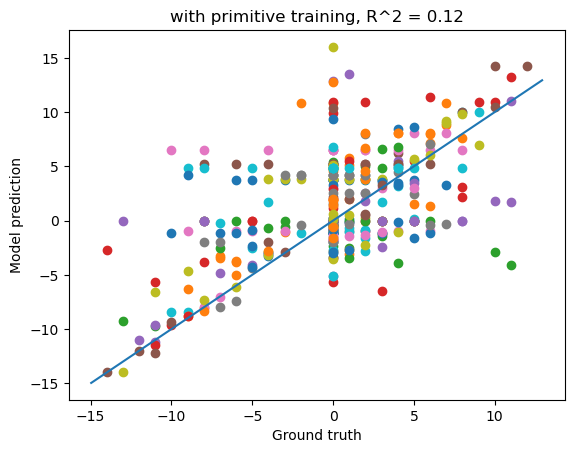

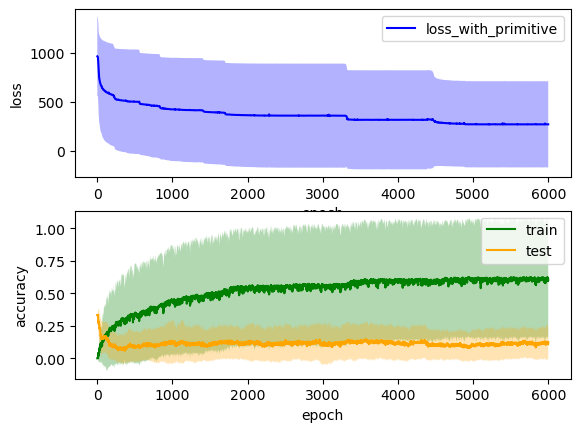

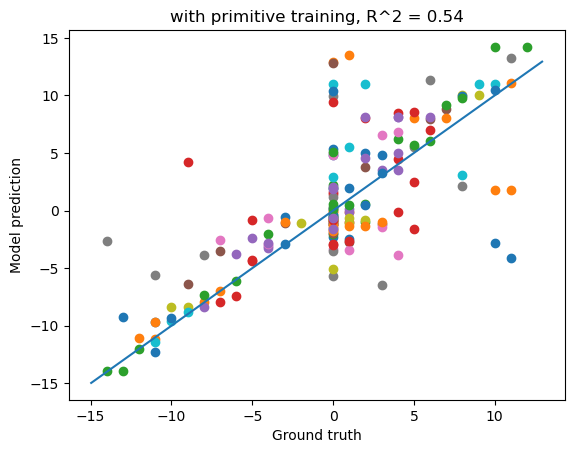

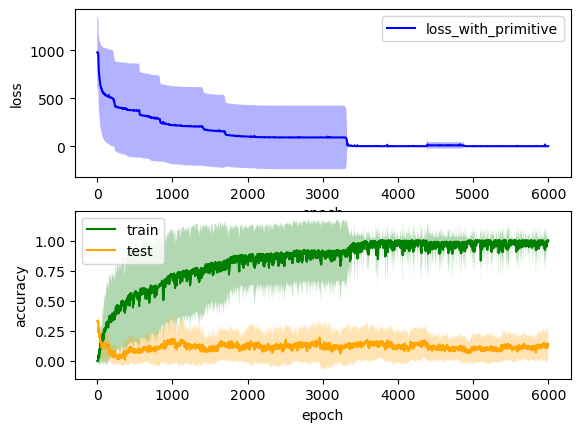

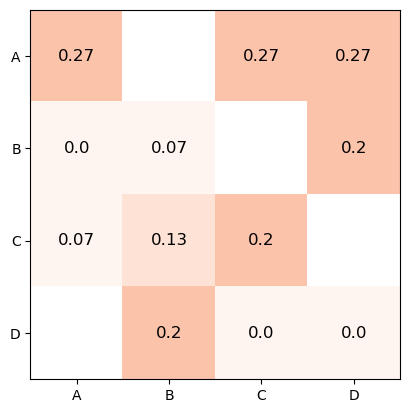

In [57]:
# other
epochs = 6000
num_sims = 32

xavier_gain = 0.01

trainseqs = generate_other(ops, all_syms, cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.4367265303929646
2


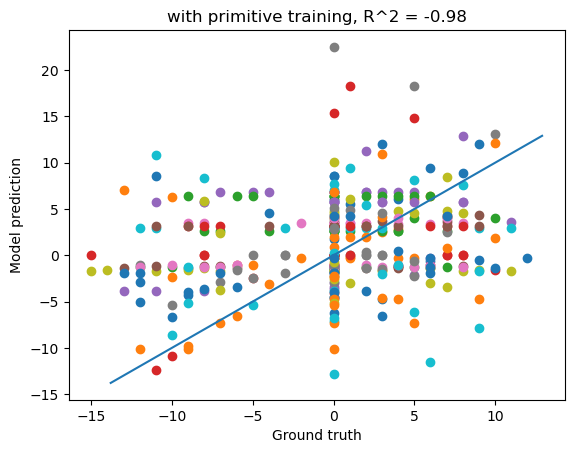

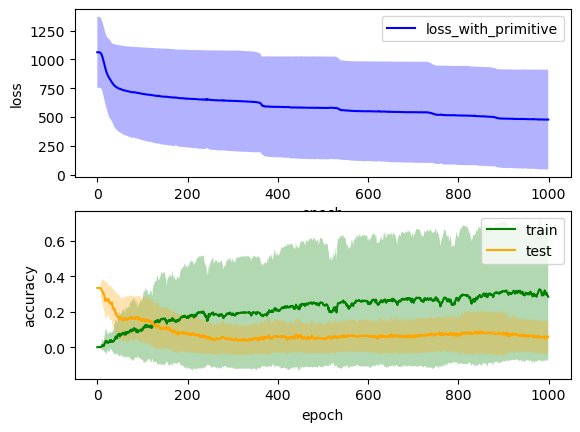

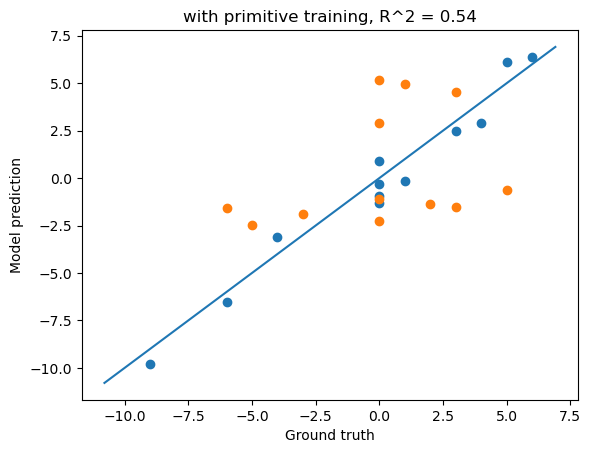

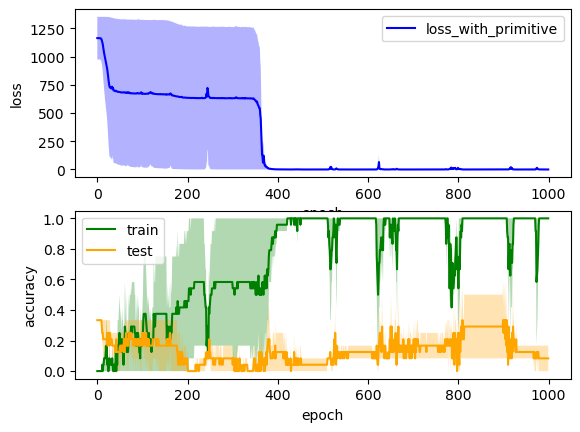

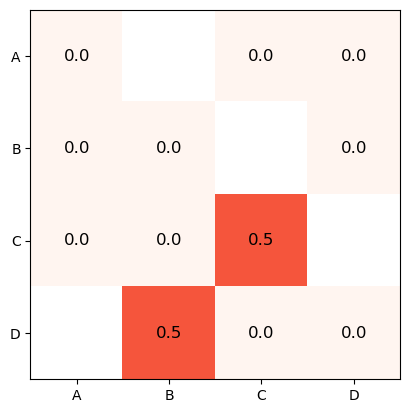

In [54]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms, cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  11.665091931819916
16


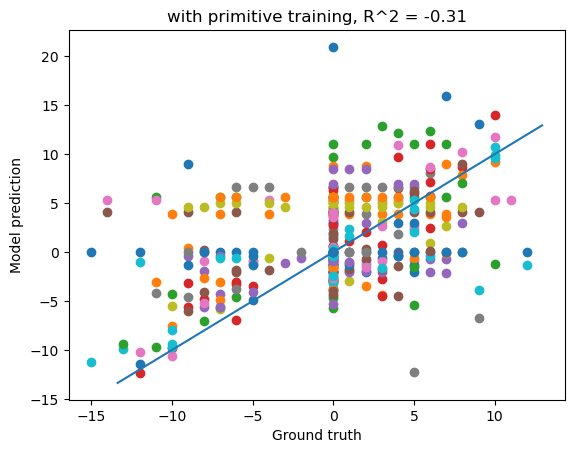

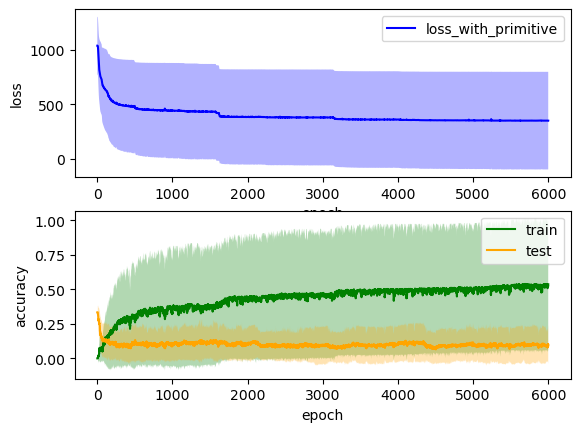

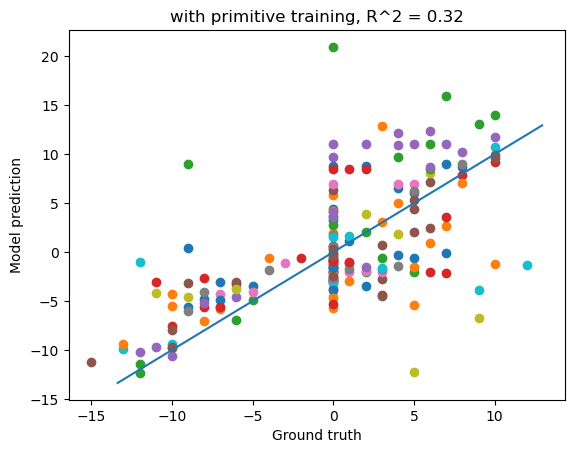

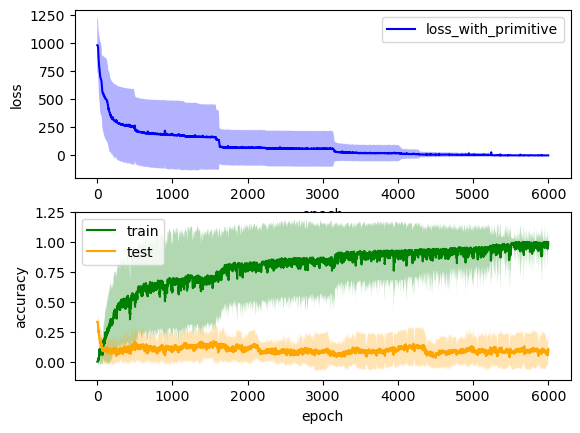

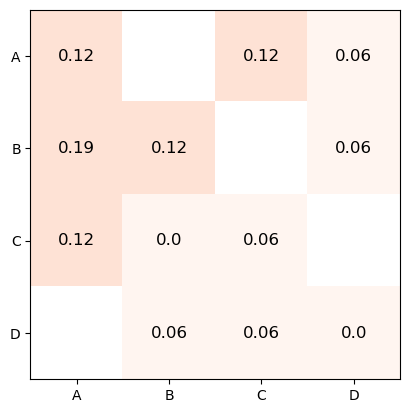

In [55]:
# other
epochs = 6000
num_sims = 32

xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms, cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.5234460830688477
28


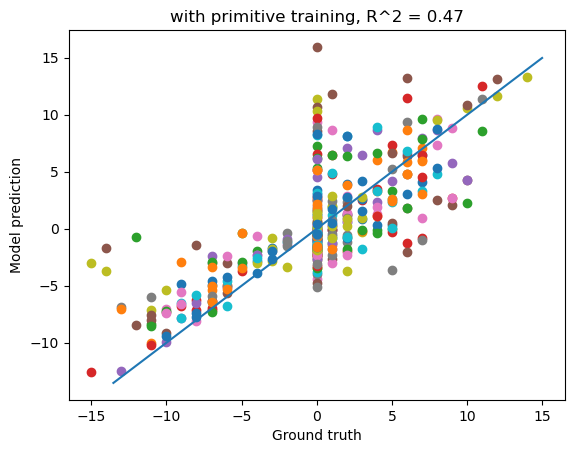

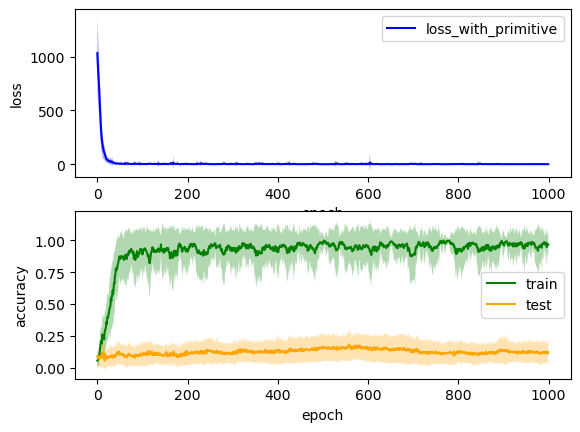

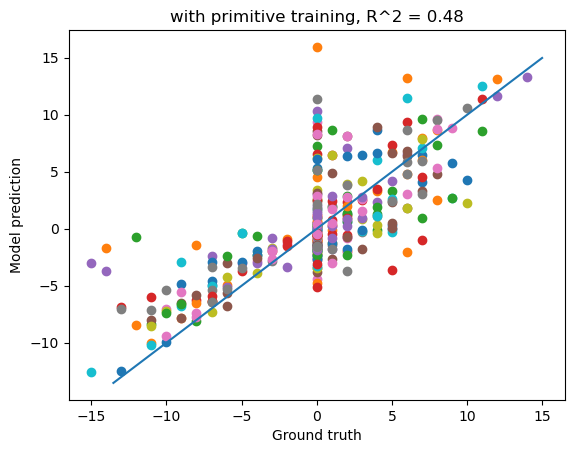

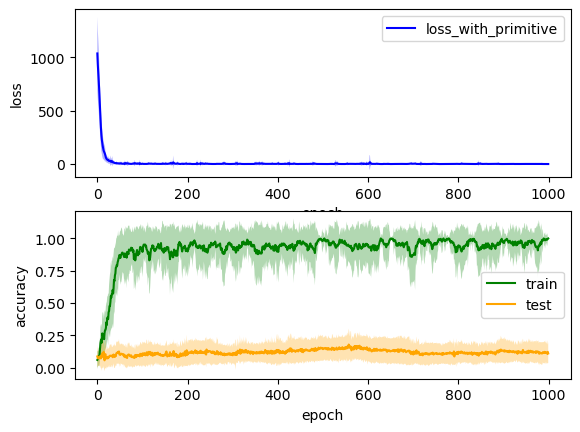

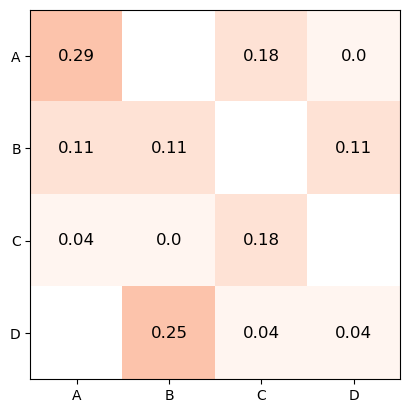

In [64]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 2

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.524096683661143
29


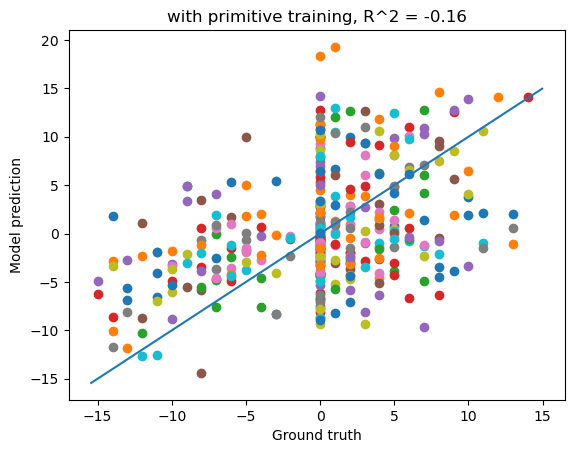

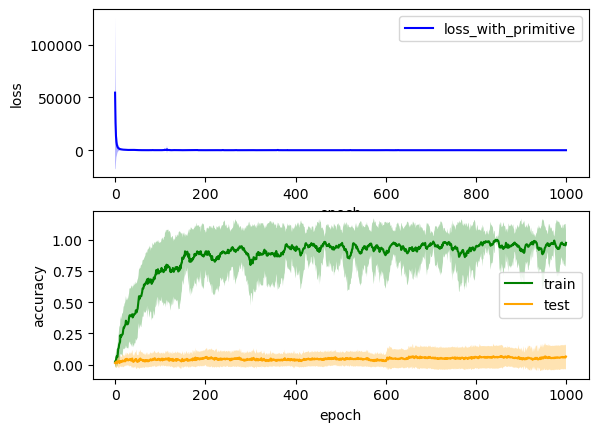

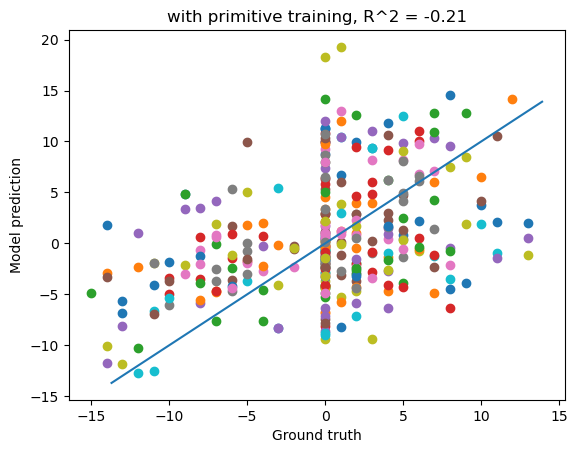

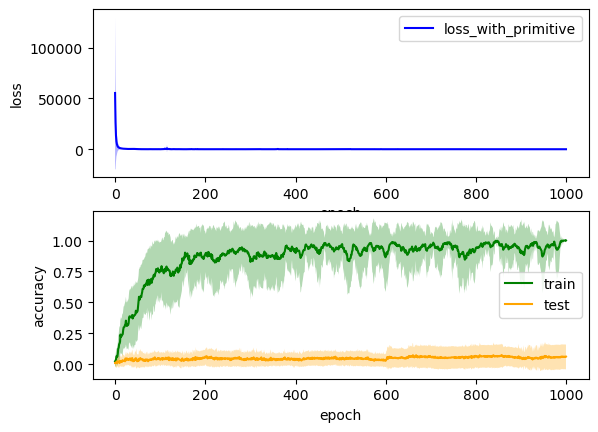

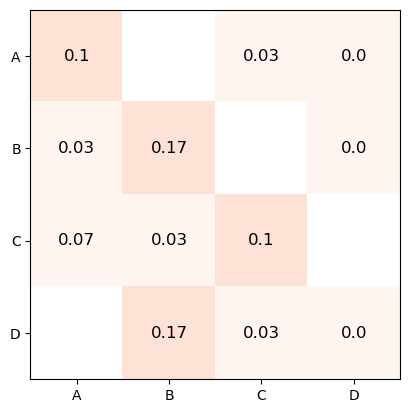

In [67]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 5

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

## only negs

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.289108117421468
29


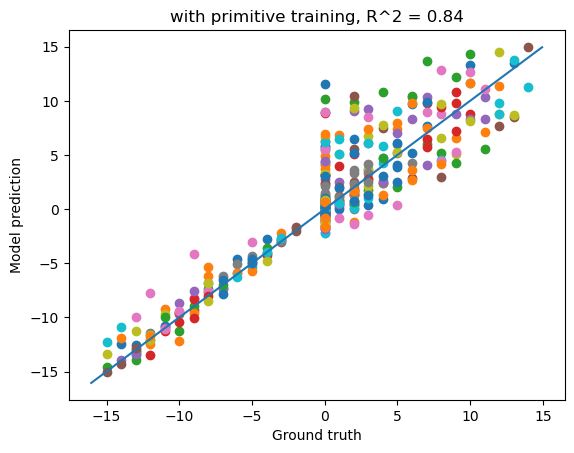

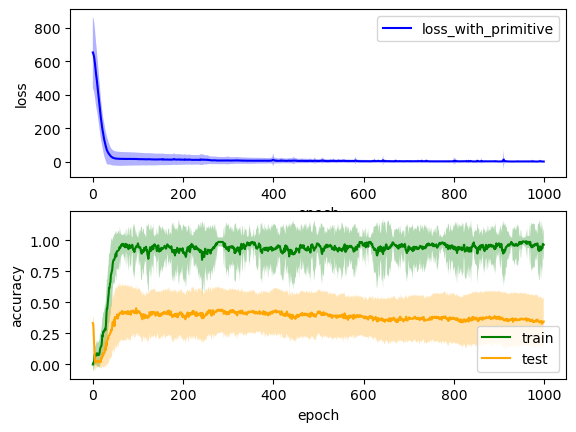

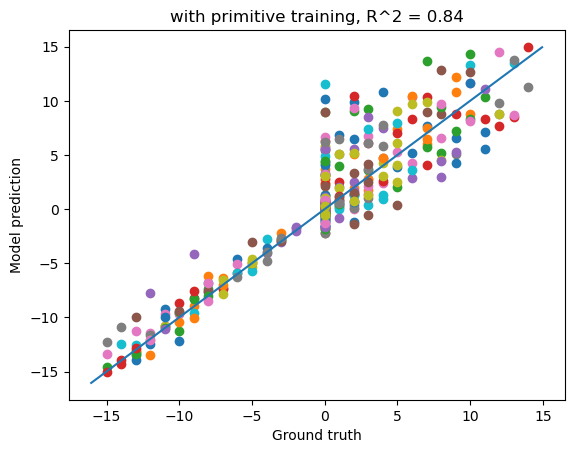

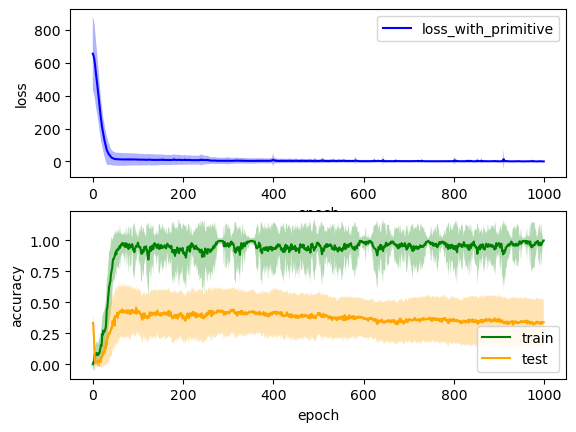

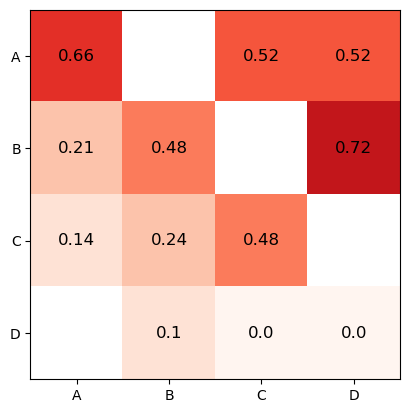

In [60]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.3

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.2368711511294046
30


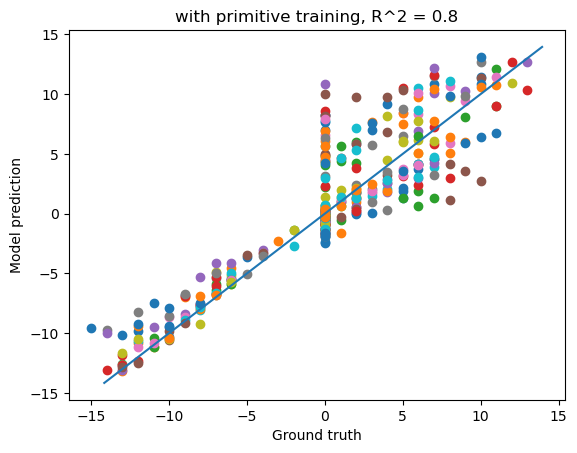

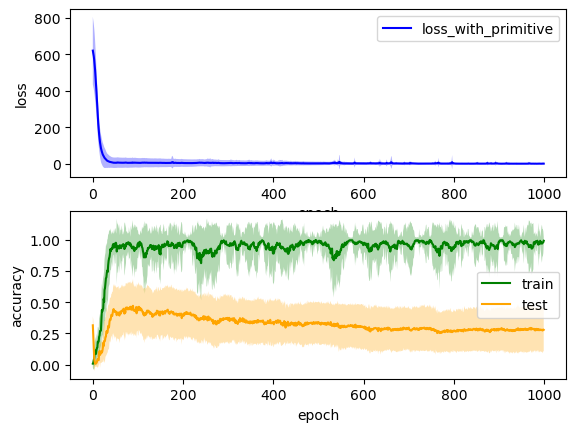

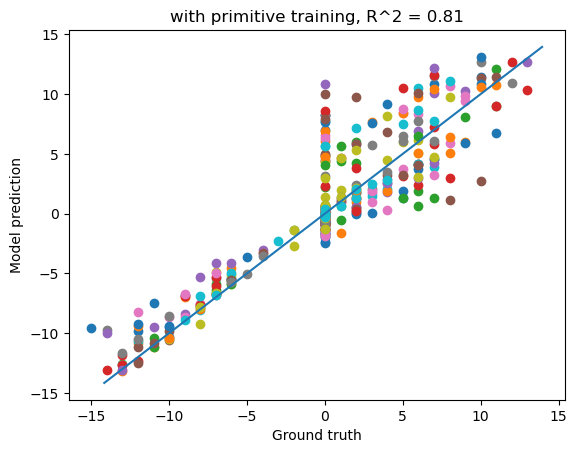

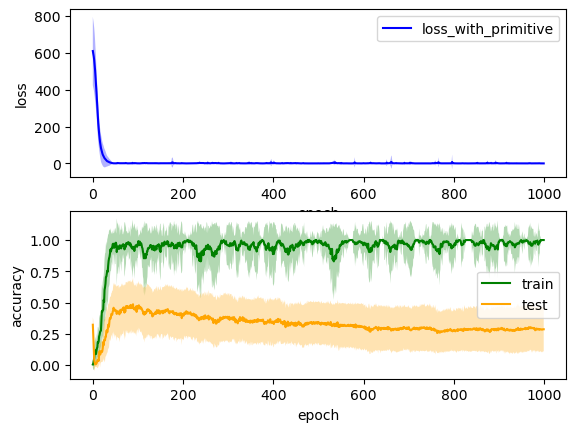

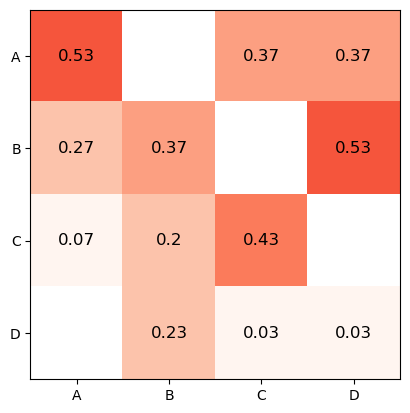

In [61]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.7

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.1985416134198508
29


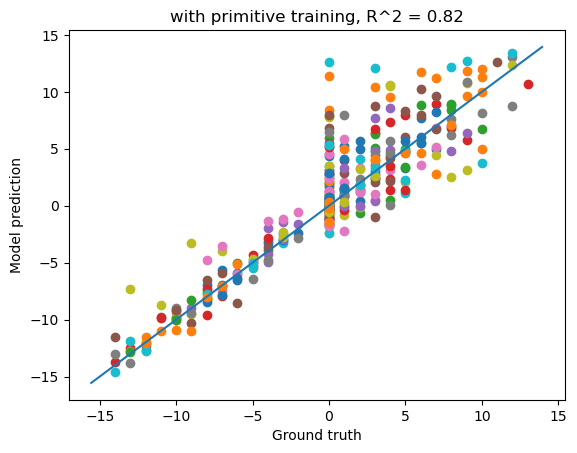

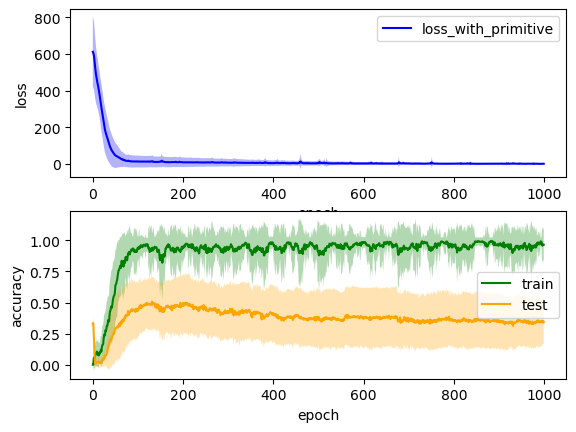

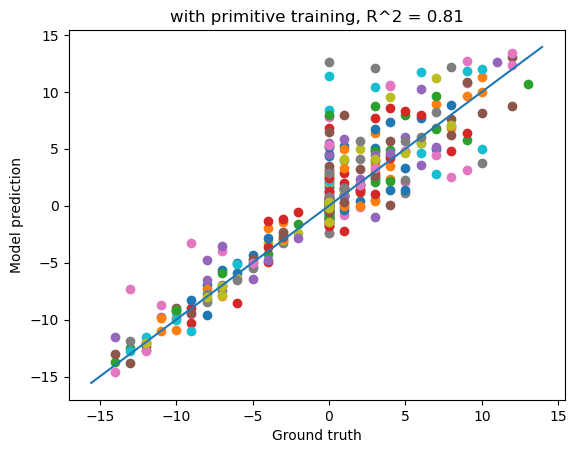

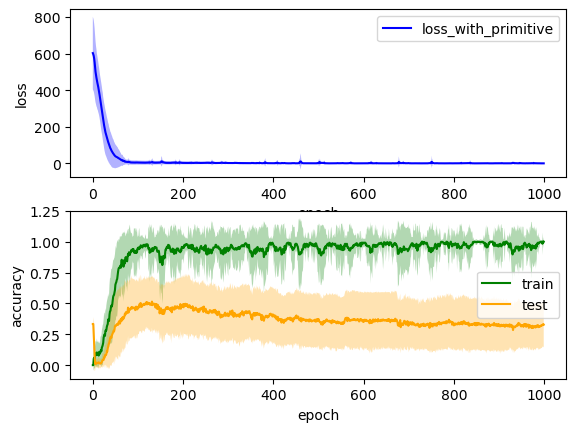

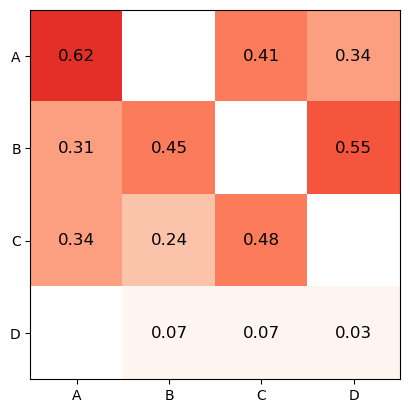

In [63]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.2

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.2212727149327596
24


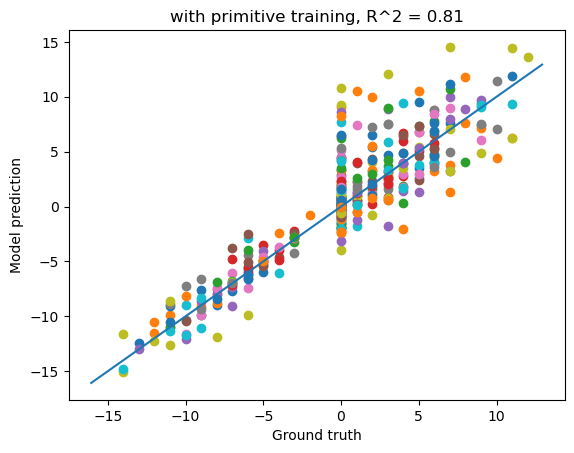

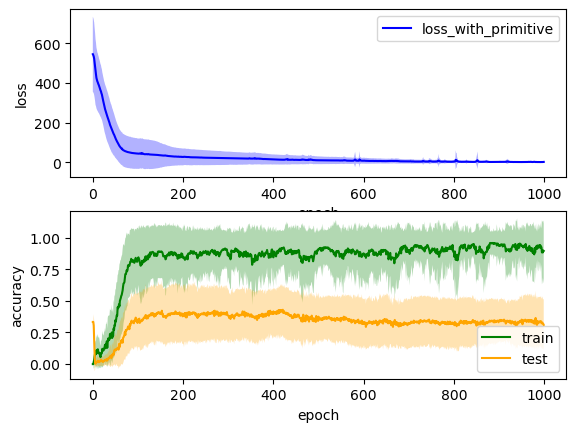

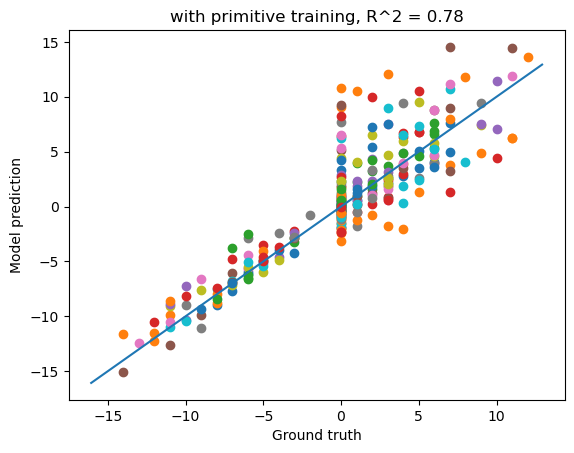

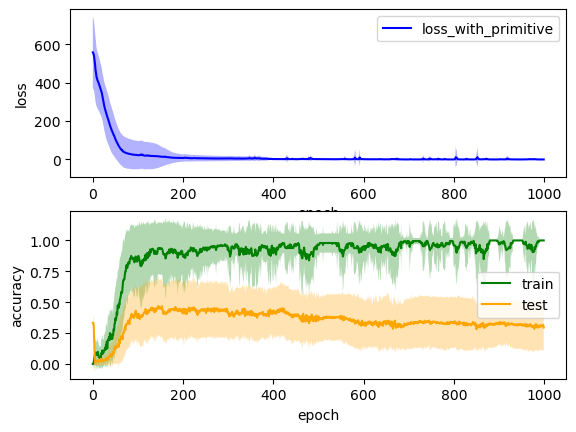

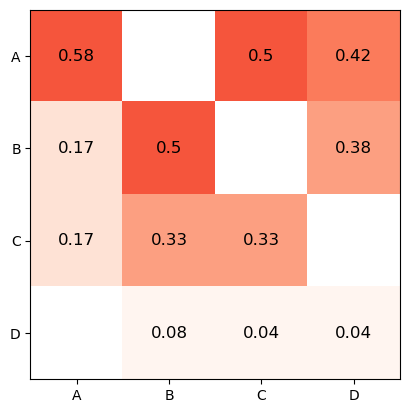

In [65]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.1

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.218162234624227
5


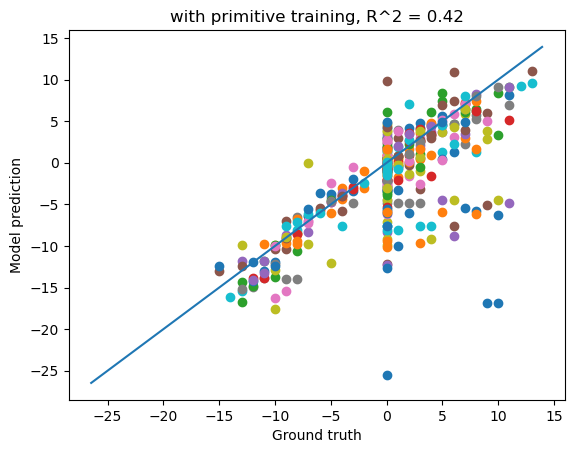

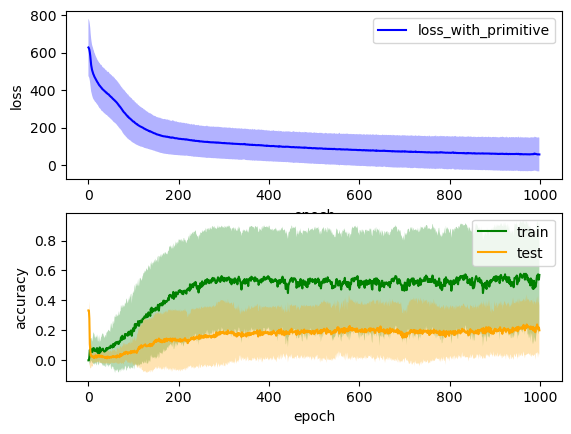

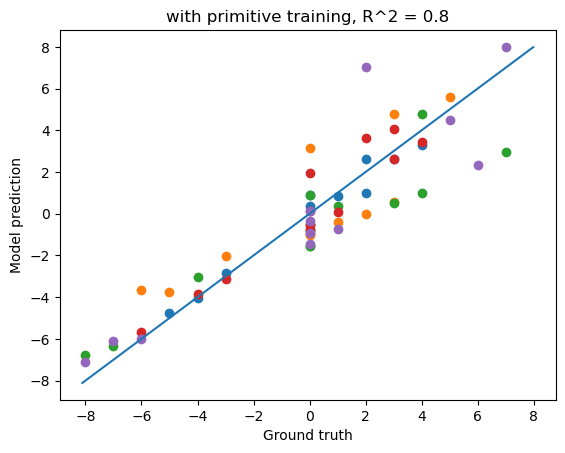

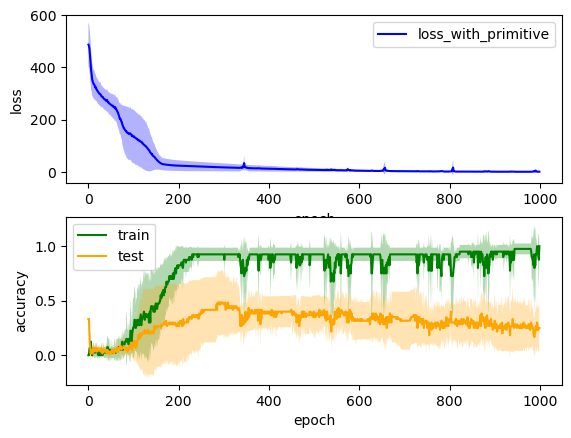

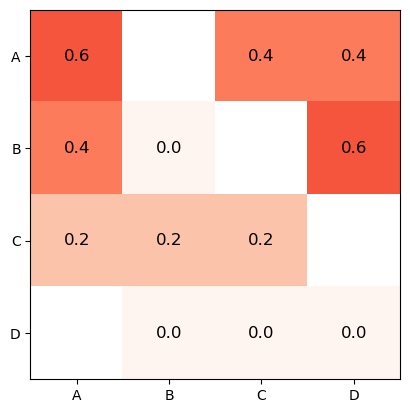

In [66]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.01

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [ ]:
# other reverse

trainseqs  [['A', ('-', 'C'), '=', -10], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['D', ('-', 'B'), '=', 7], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'B'), '=', 3], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.2179026126861572
31


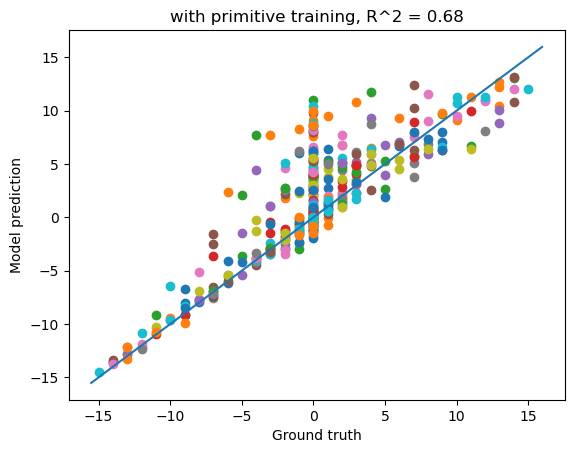

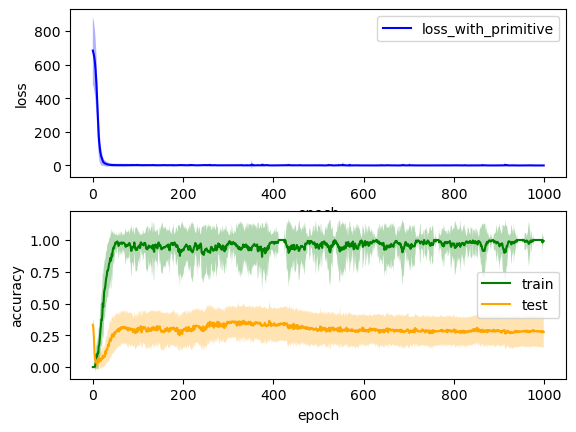

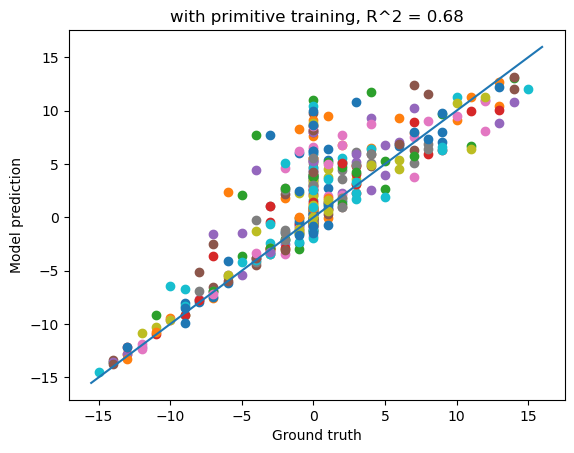

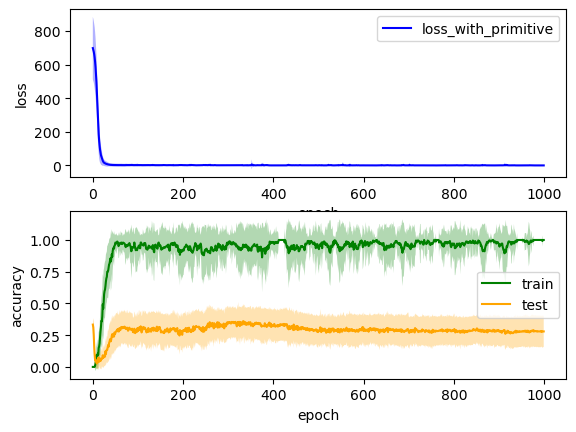

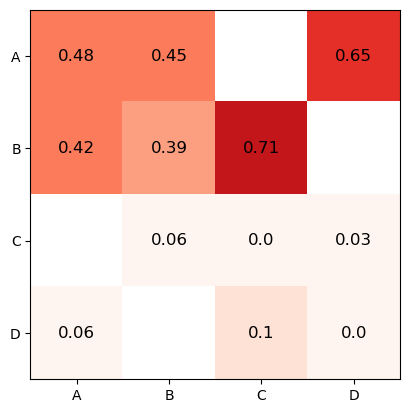

In [68]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.5

trainseqs = generate_other_reverse(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.2011715372403462
29


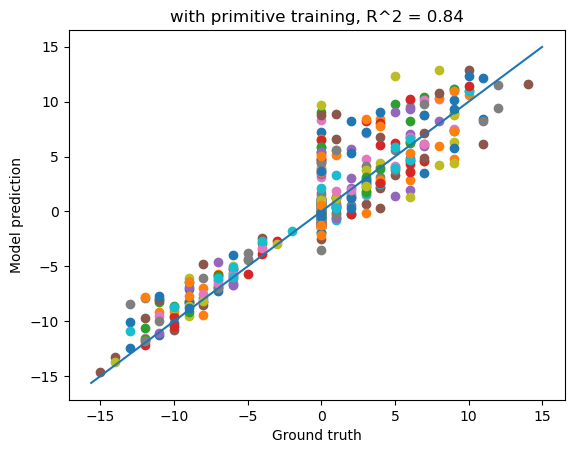

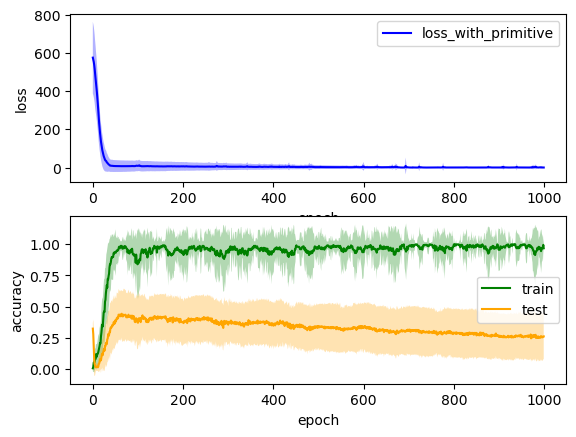

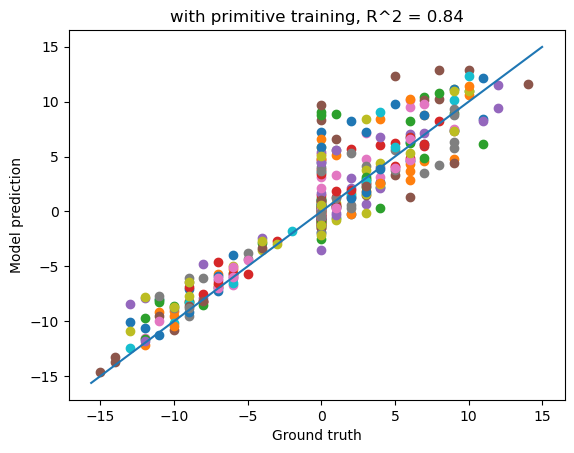

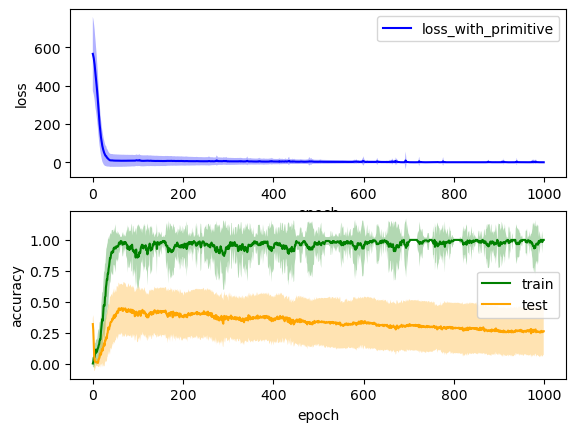

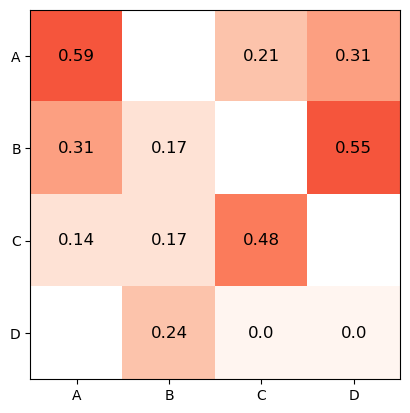

In [69]:
# other
epochs = 1000
num_sims = 32

xavier_gain = 0.5

trainseqs = generate_other(ops, all_syms, cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'C'), '=', -6], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'D'), '=', 0]]
run time:  1.2810049772262573
26


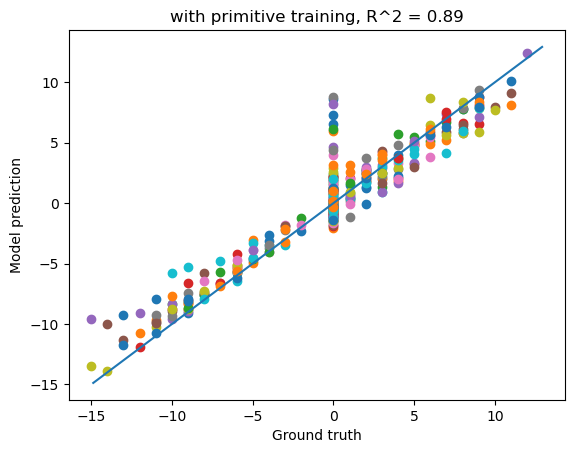

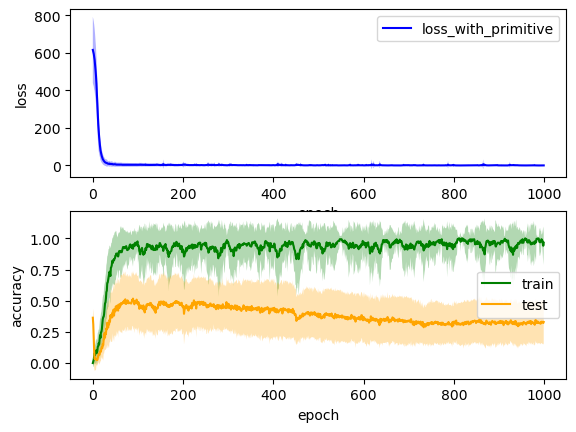

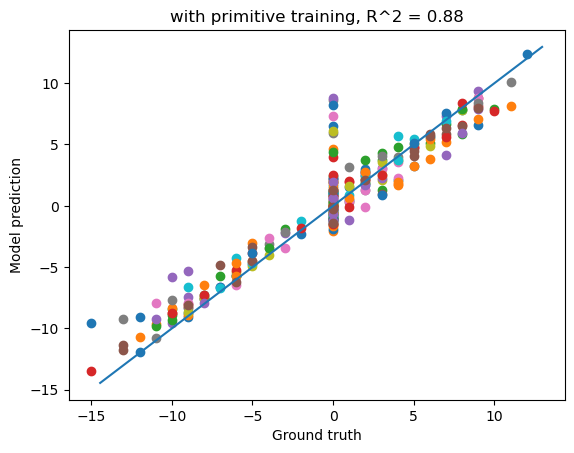

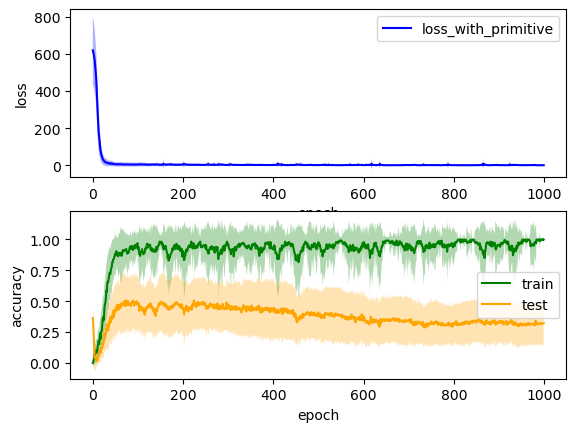

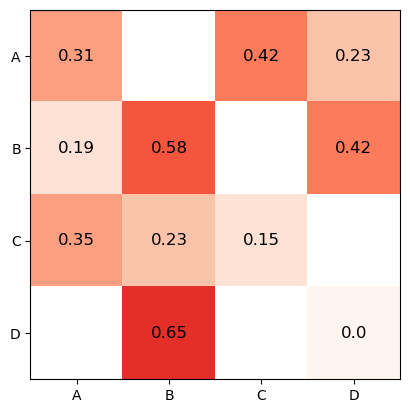

In [72]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 0.5

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['C'], ['D'], cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'D'), '=', 0], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6]]
run time:  1.282149648666382
30


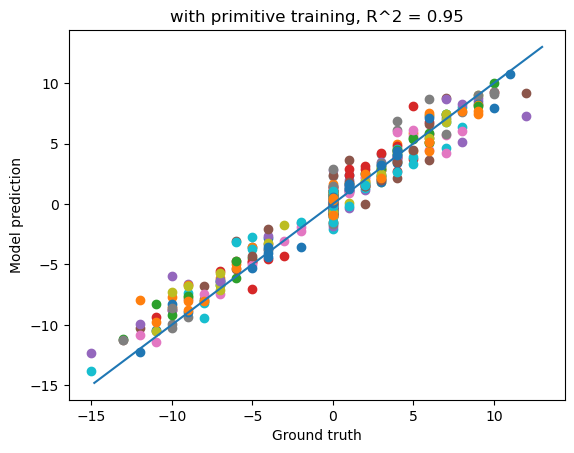

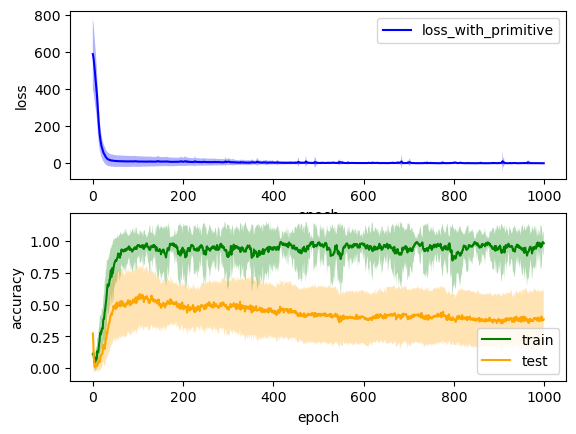

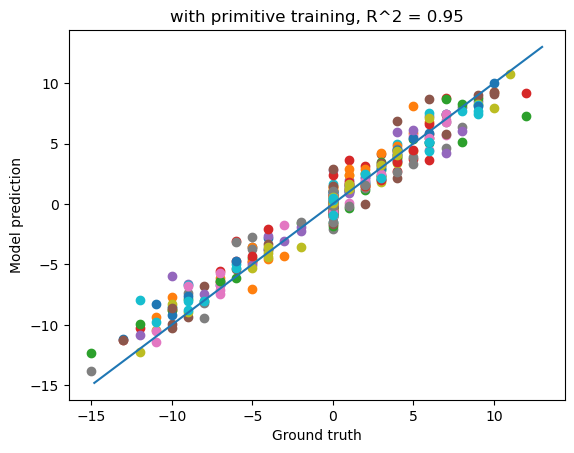

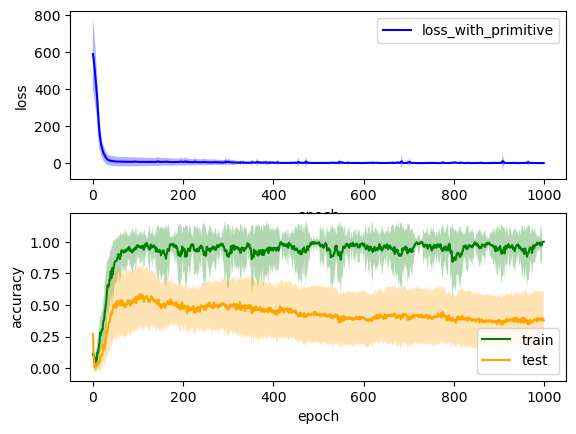

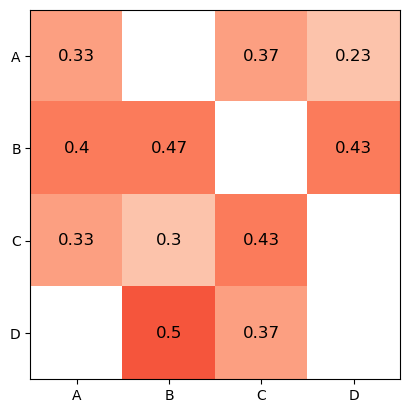

In [71]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 0.5

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['D'], ['D'], cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', ('-', 'A'), '=', 0], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.2820718010266623
30


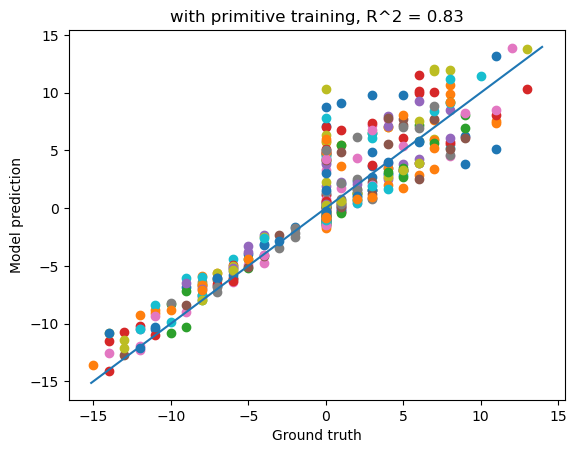

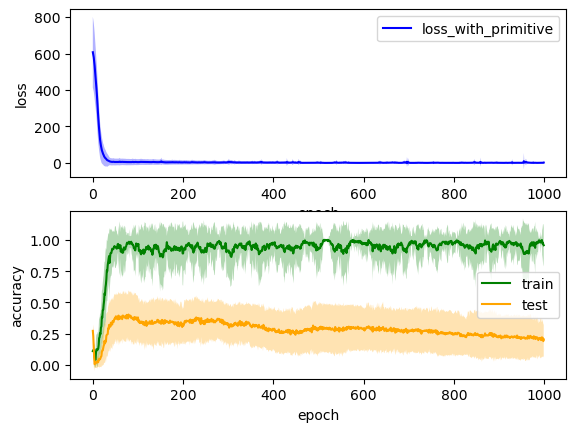

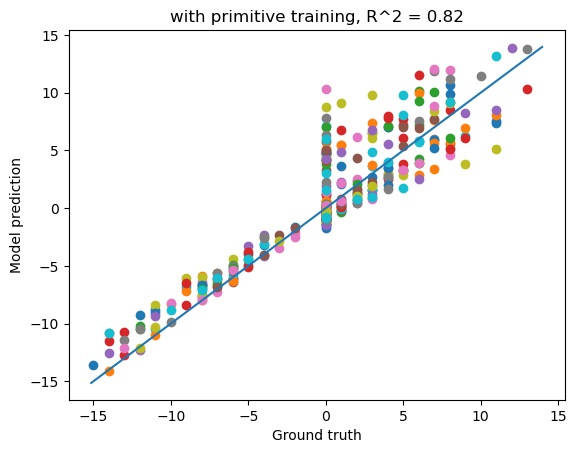

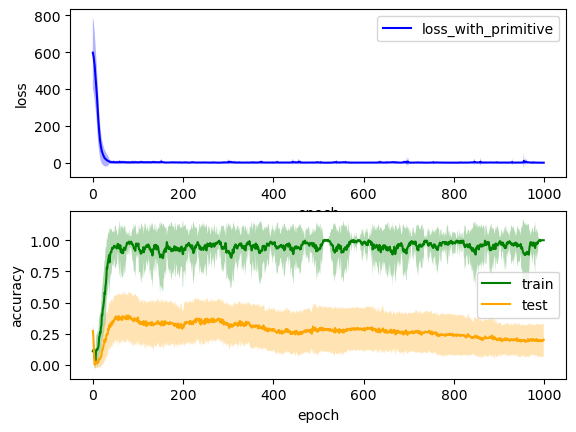

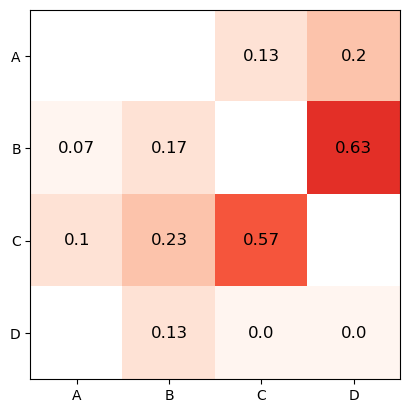

In [73]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 0.5

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['A'], ['A'], cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'D'), '=', 0], ['D', ('-', 'C'), '=', -6], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7]]
run time:  1.3701302846272787
29


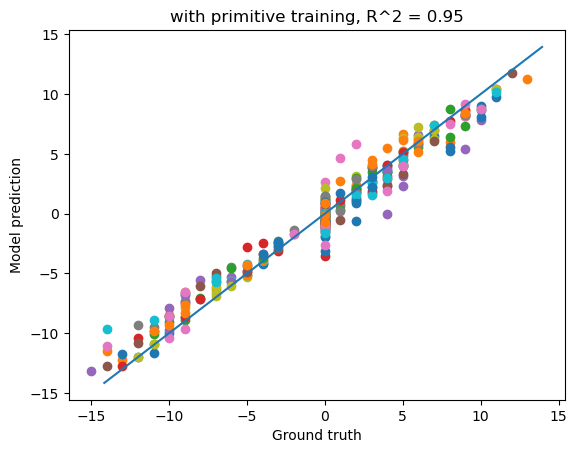

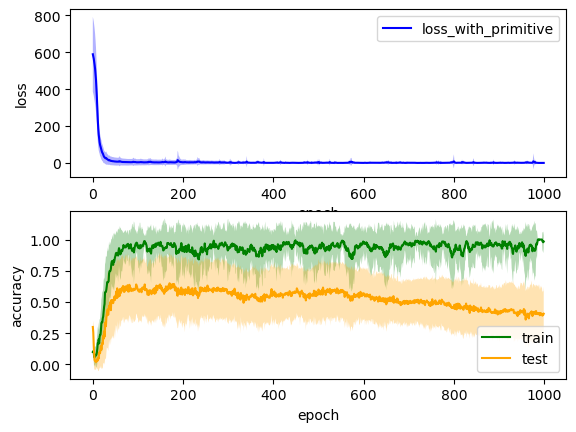

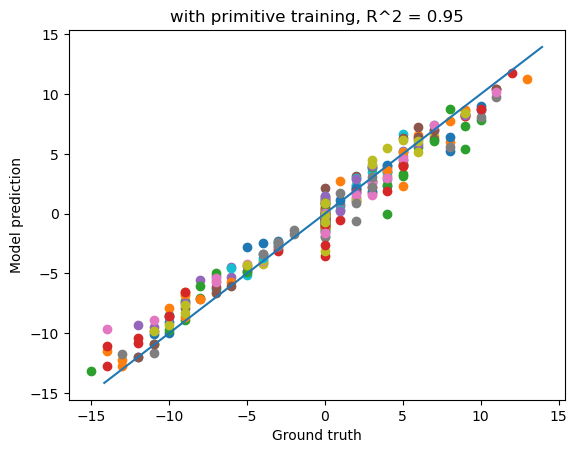

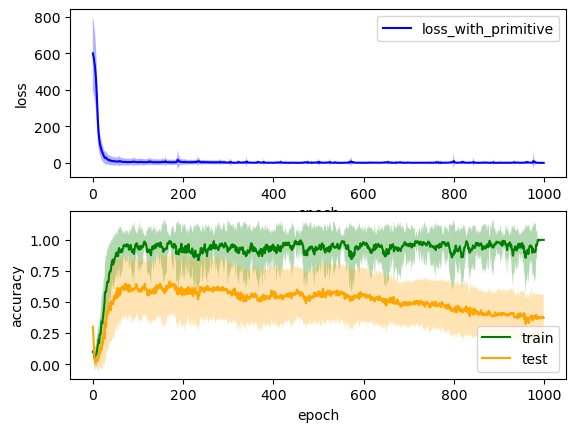

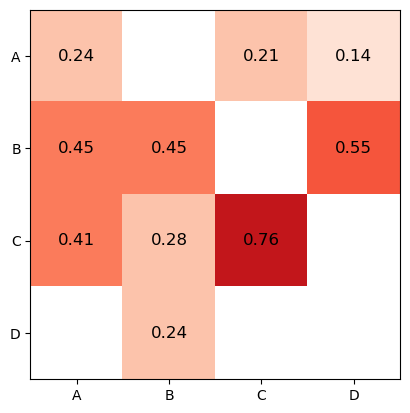

In [74]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 0.5

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['D', 'C'], ['D'], cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'D'), '=', 0], ['D', ('-', 'C'), '=', -6], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7]]
run time:  1.7530574321746826
24


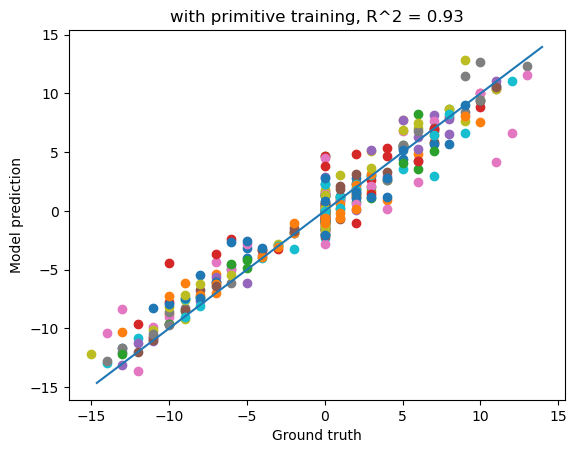

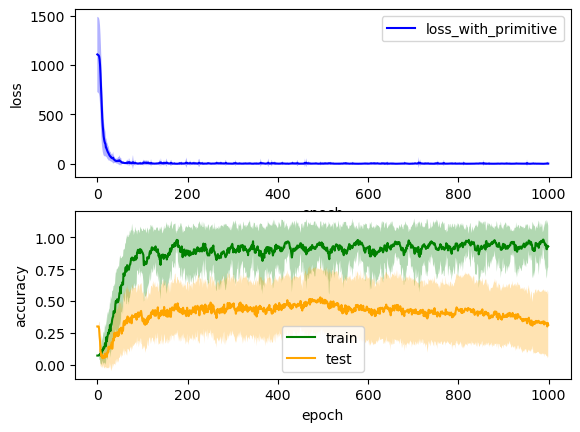

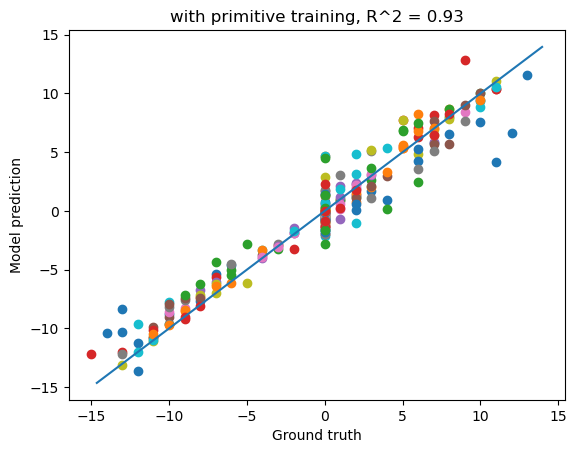

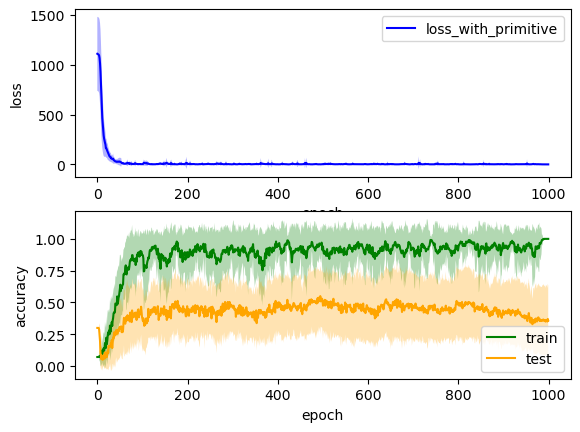

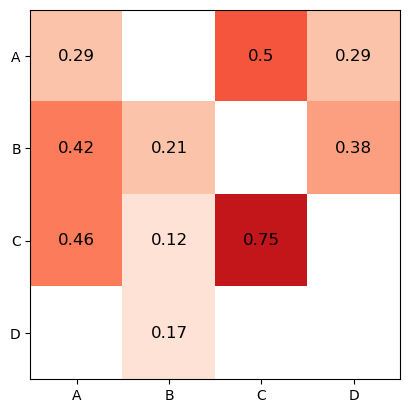

In [75]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 0.5

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['D', 'C'], ['D'], cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'D'), '=', 0], ['D', ('-', 'C'), '=', -6], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7]]
run time:  1.706535816192627
21


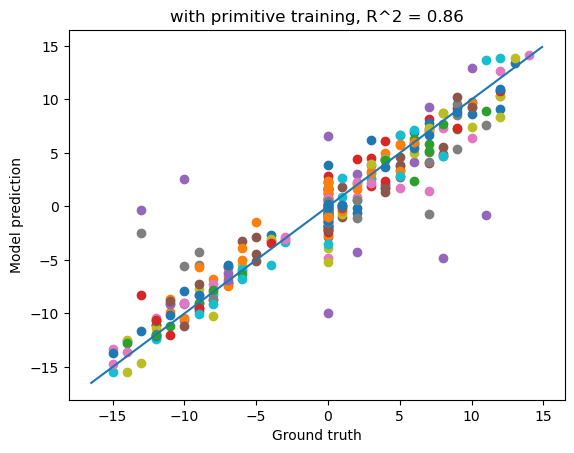

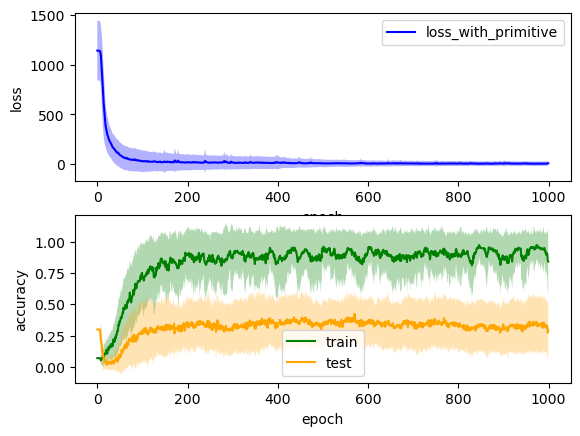

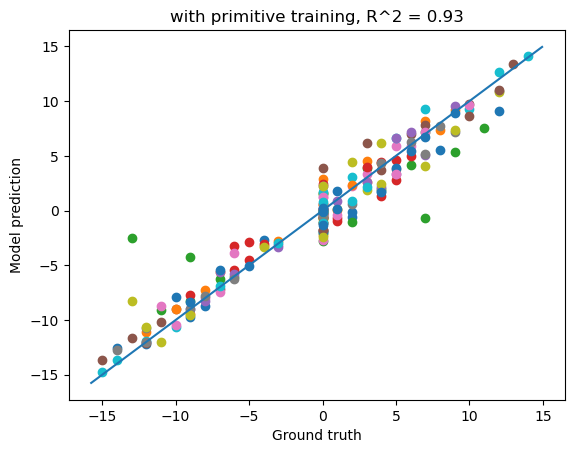

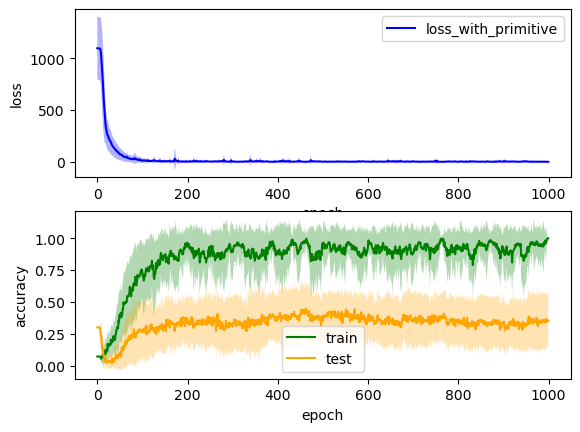

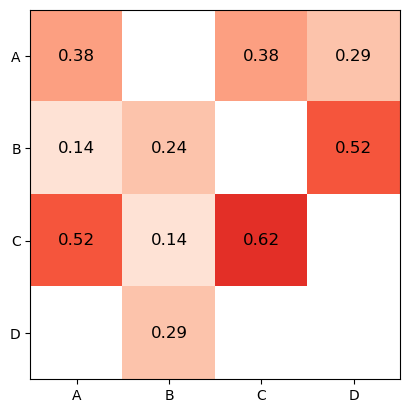

In [76]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 0.1

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['D', 'C'], ['D'], cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'D'), '=', 0], ['D', ('-', 'C'), '=', -6], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7]]
run time:  15.778123637040457
11


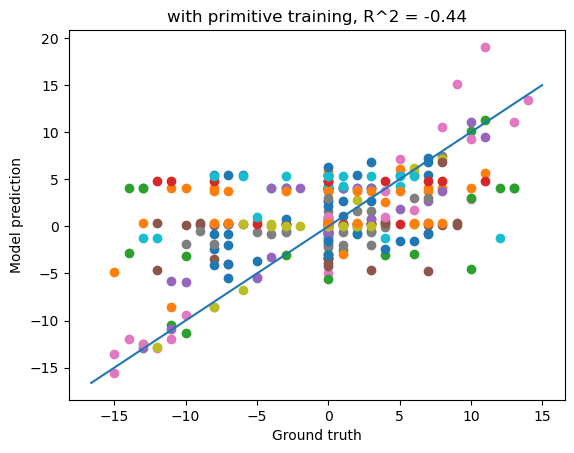

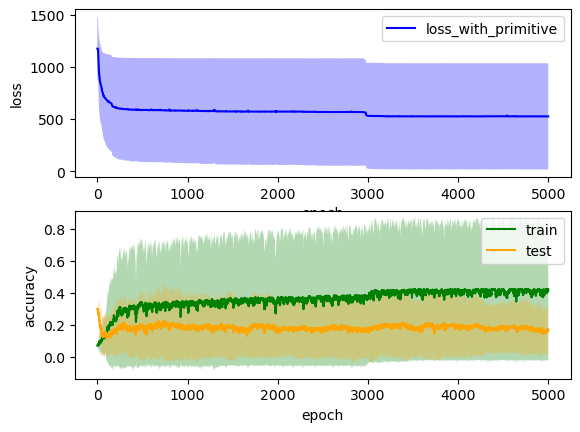

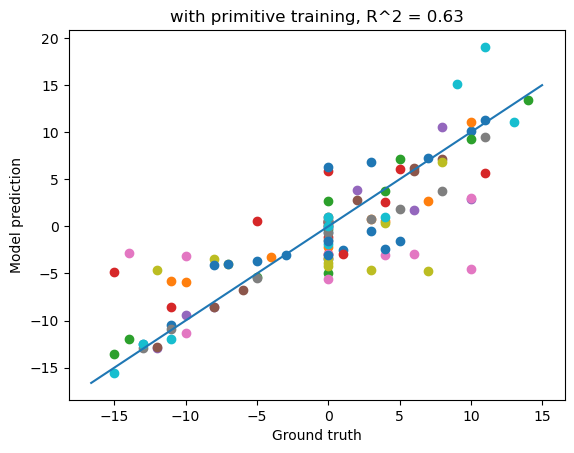

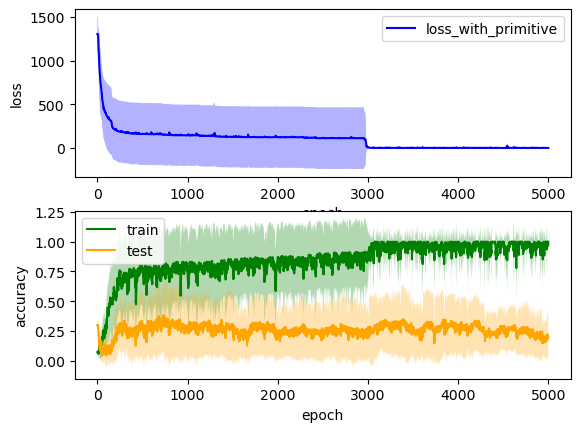

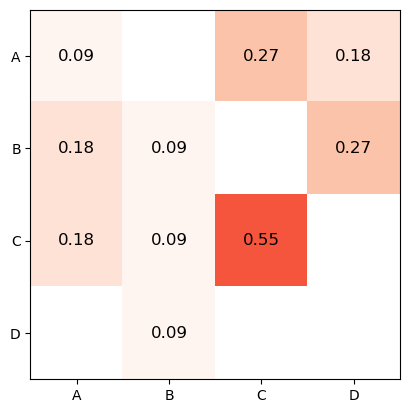

In [79]:
 # other
epochs = 5000
num_sims = 32

xavier_gain = 0.01

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['D', 'C'], ['D'], cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'D'), '=', 0], ['D', ('-', 'C'), '=', -6], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7]]
run time:  1.724822719891866
23


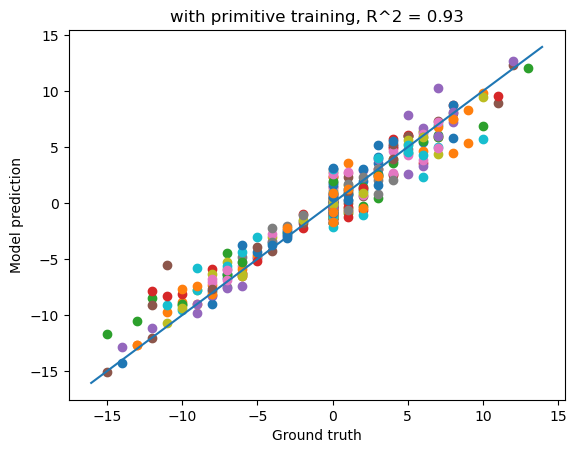

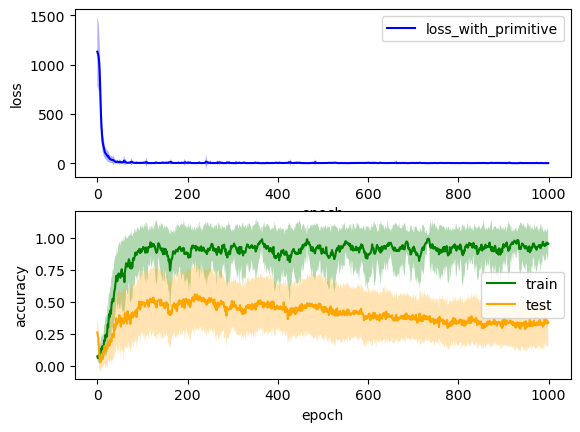

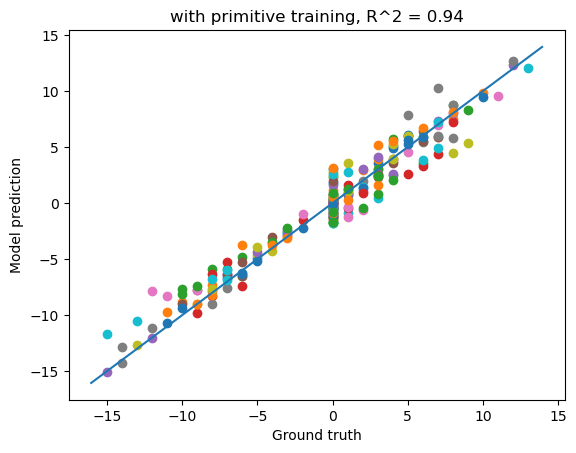

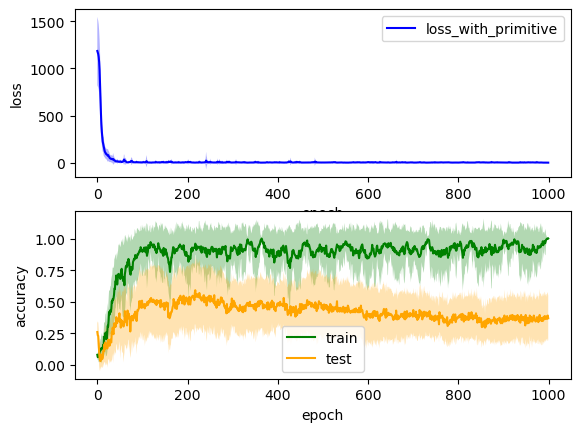

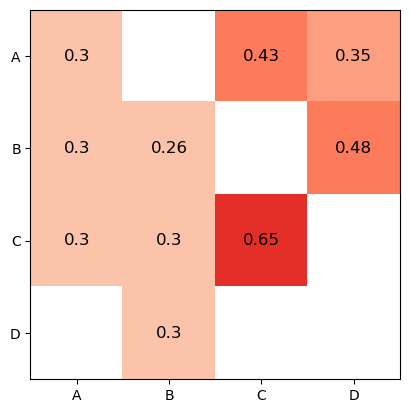

In [78]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 1

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['D', 'C'], ['D'], cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'D'), '=', 0], ['D', ('-', 'C'), '=', -6], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7]]
run time:  1.6756208499272665
16


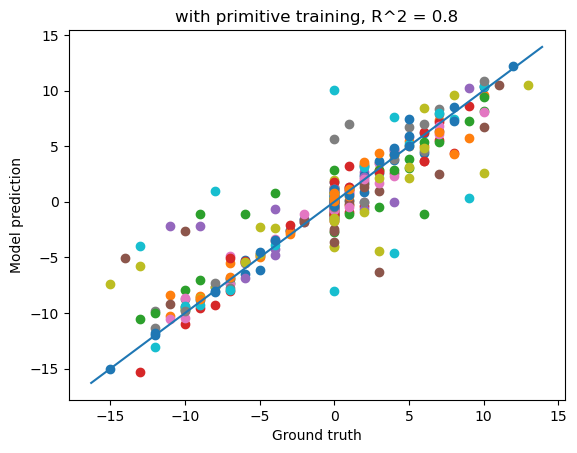

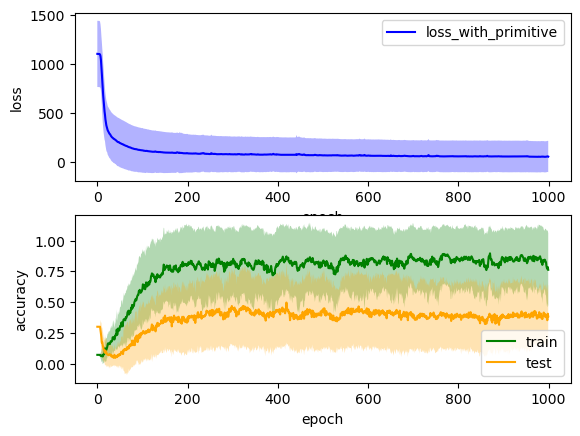

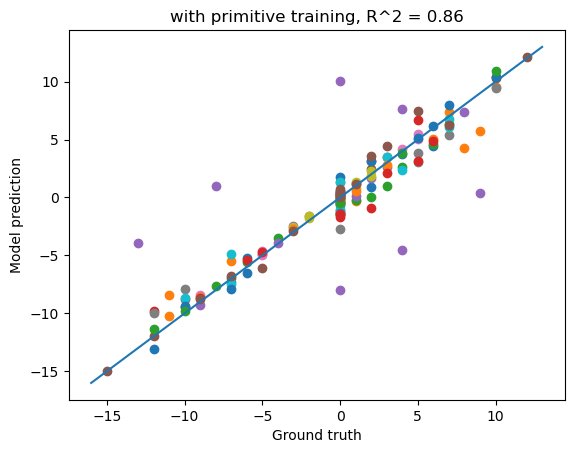

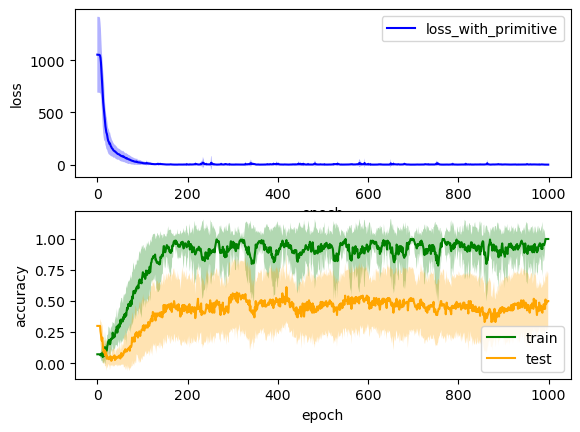

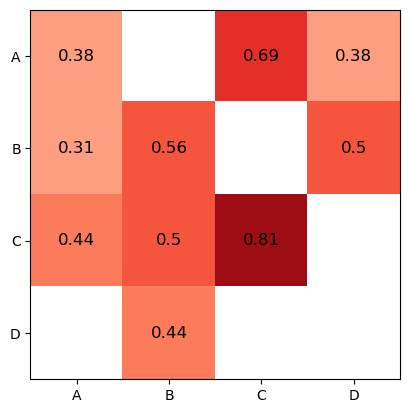

In [81]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 0.05

trainseqs = generate_other(ops, all_syms, cue_dict) + generate_trials(ops, ['D', 'C'], ['D'], cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'B'), '=', 3], ['A', ('-', 'C'), '=', -10], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'D'), '=', -4], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  2.813325750827789
22


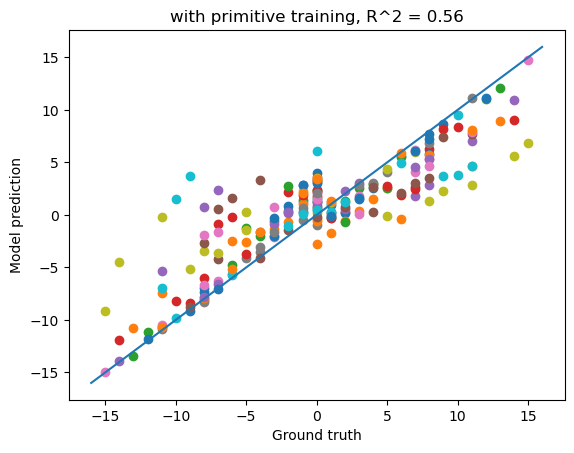

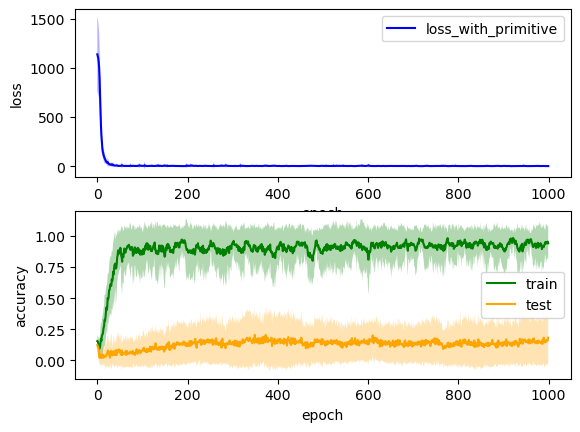

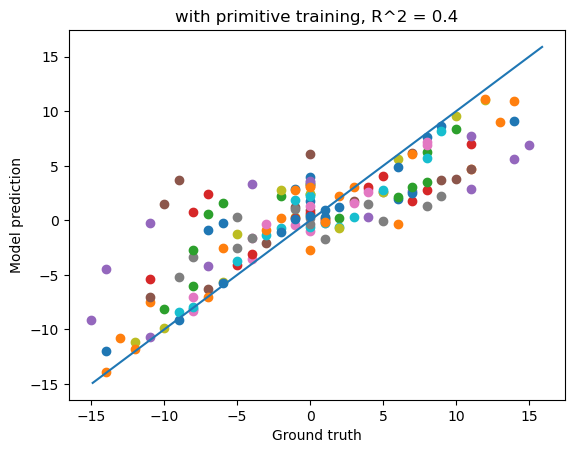

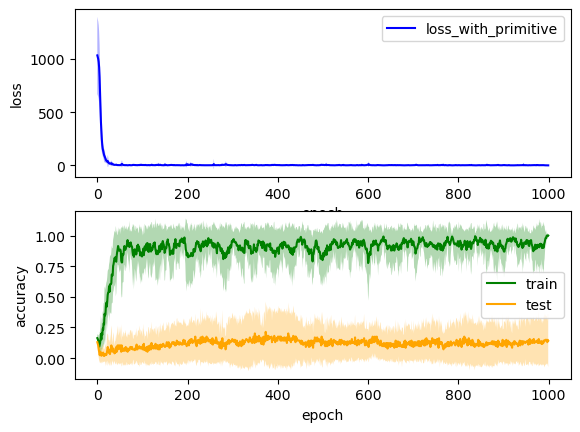

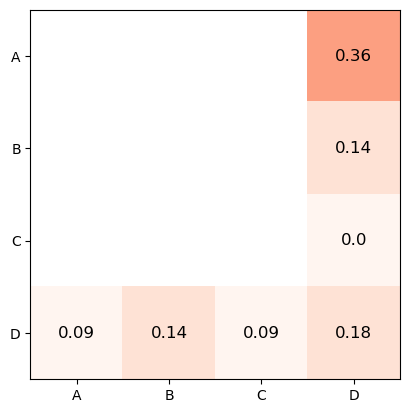

In [83]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 1

trainseqs = generate_trials(ops, all_syms[:-1], all_syms[:-1], cue_dict) + primitives + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'B'), '=', 3], ['A', ('-', 'C'), '=', -10], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'D'), '=', -4], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.5607281843821208
25


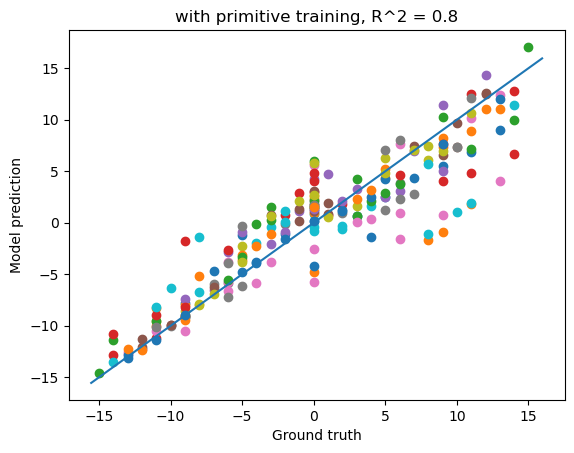

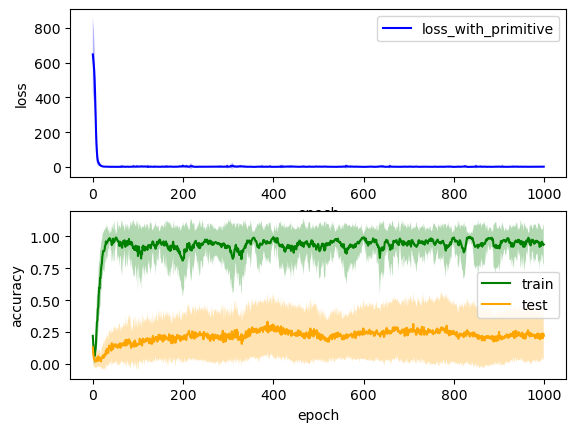

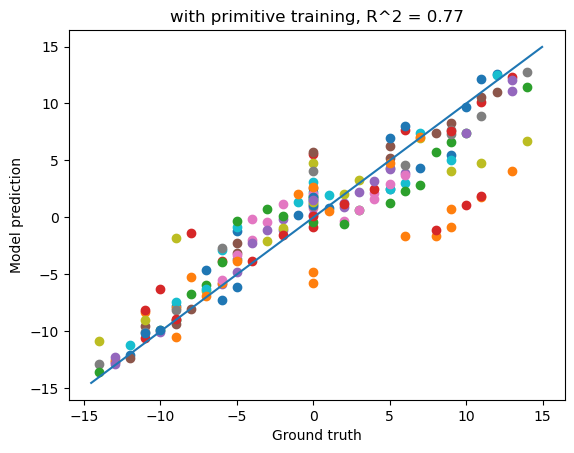

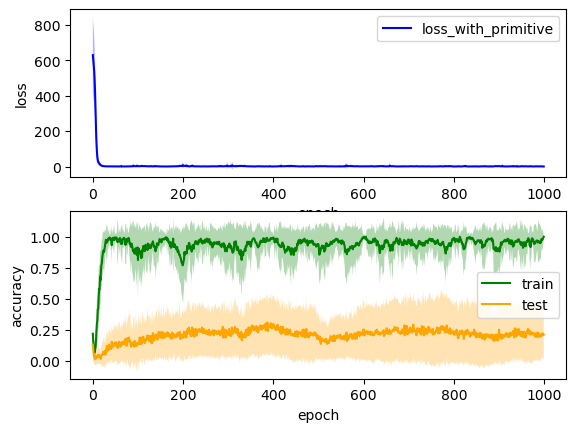

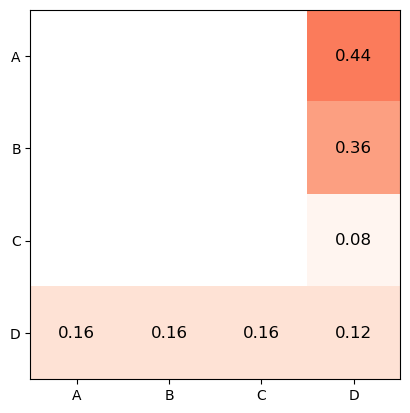

In [84]:
 # other
epochs = 1000
num_sims = 32

xavier_gain = 1

trainseqs = generate_trials(ops, all_syms[:-1], all_syms[:-1], cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  9.387464515368144
7


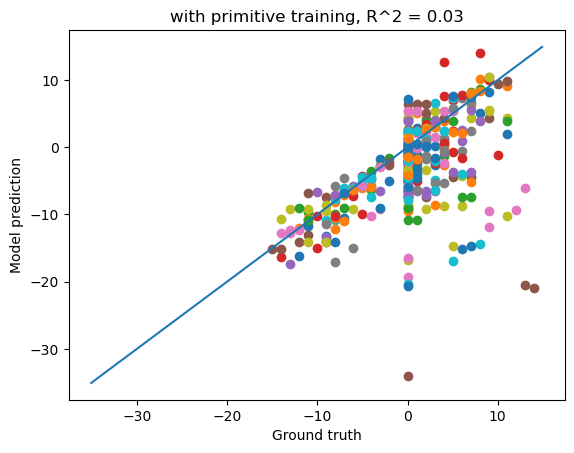

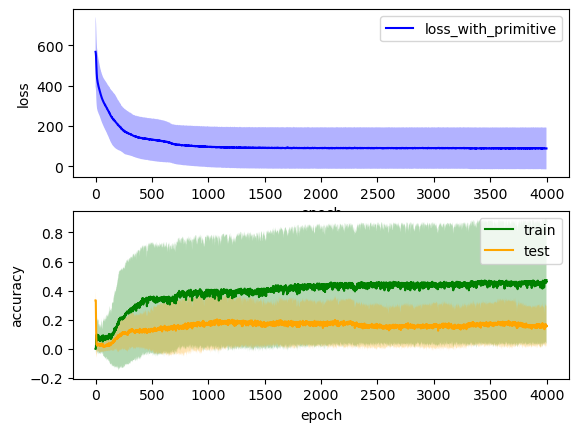

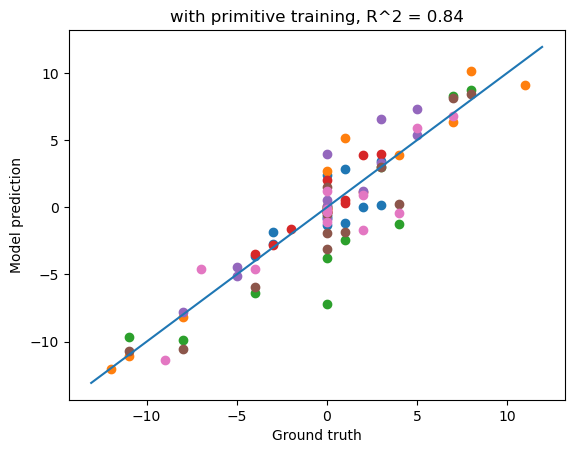

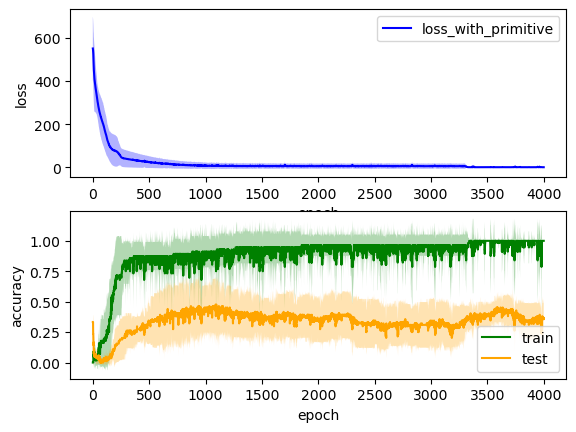

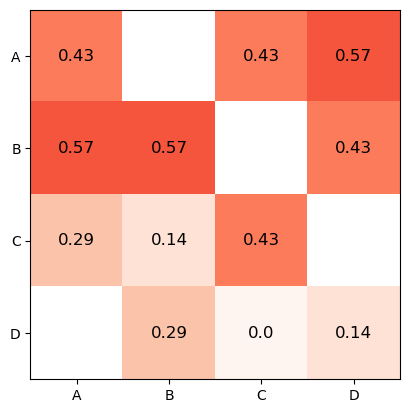

In [87]:
 # other
epochs = 4000
num_sims = 32

xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [88]:
hidden_size

10

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  23.37168526252111
20


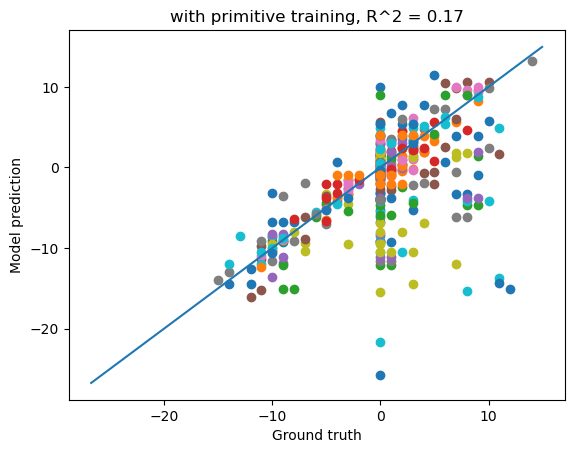

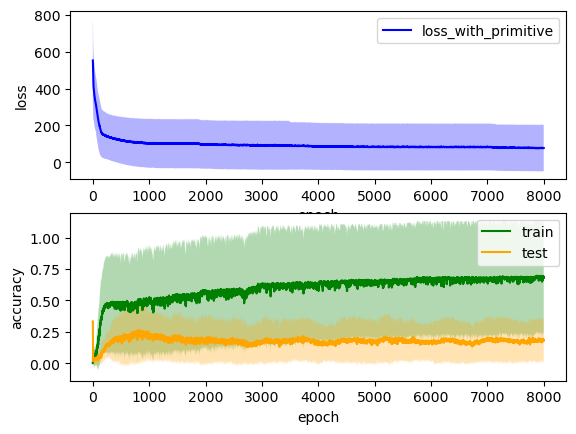

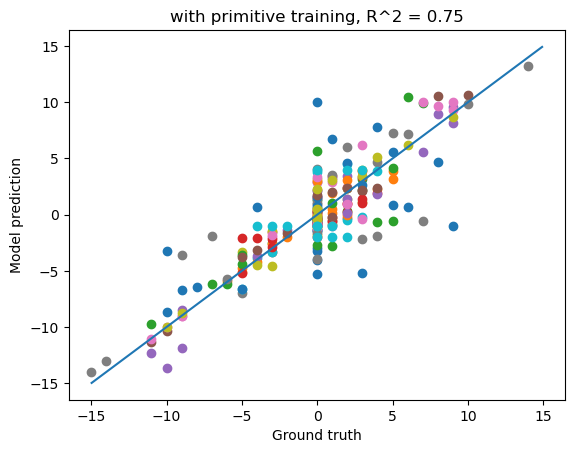

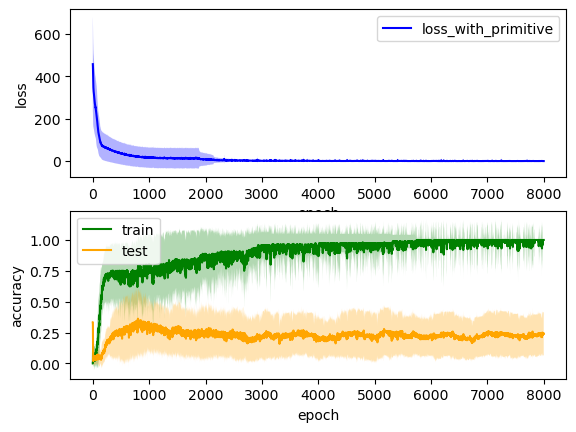

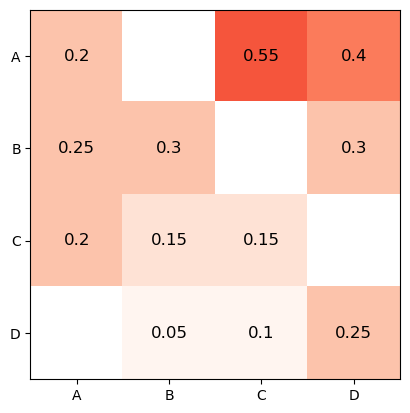

In [90]:
 # other
epochs = 8000
num_sims = 32
hidden_size=20
xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  46.40441649754842
13


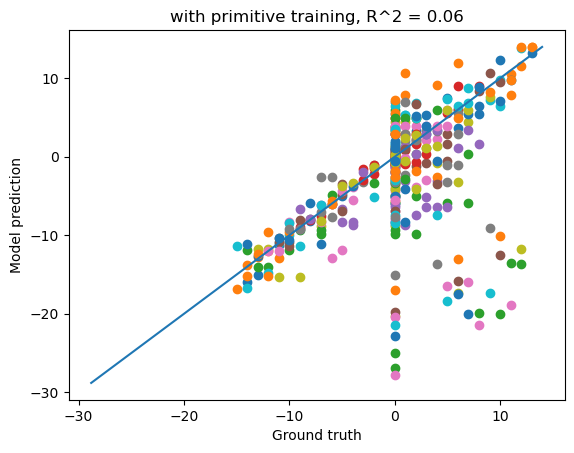

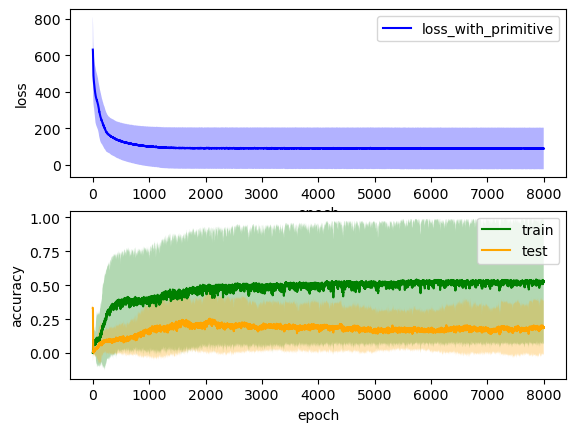

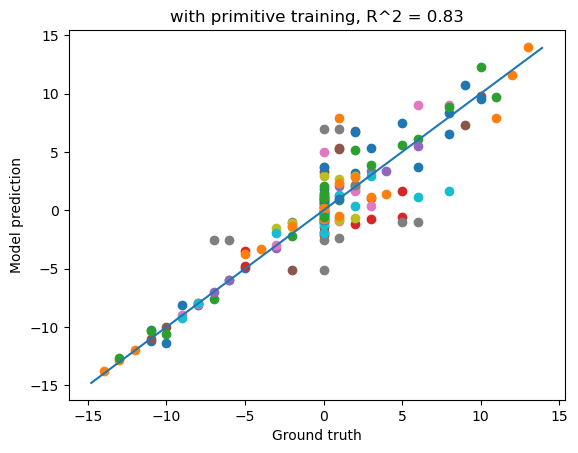

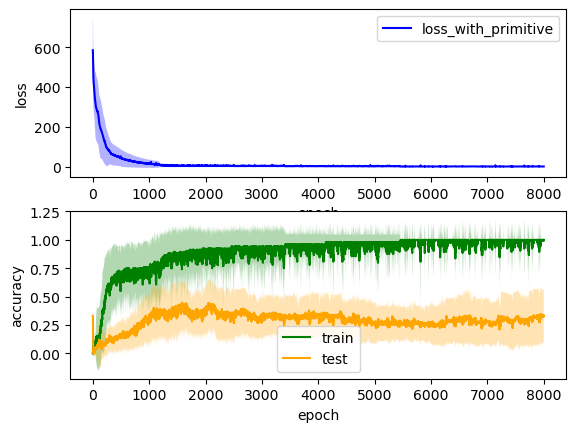

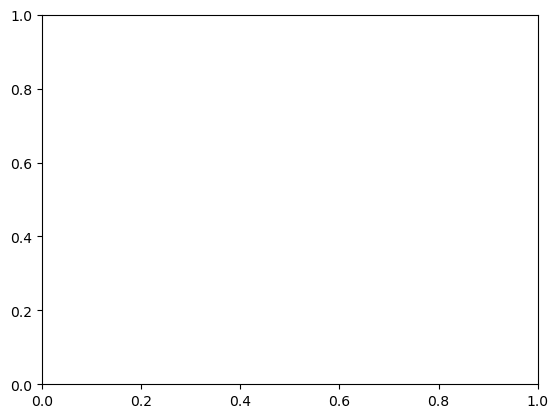

In [91]:
 # other
epochs = 8000
num_sims = 32
hidden_size=15
xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  2.706893853346507
5


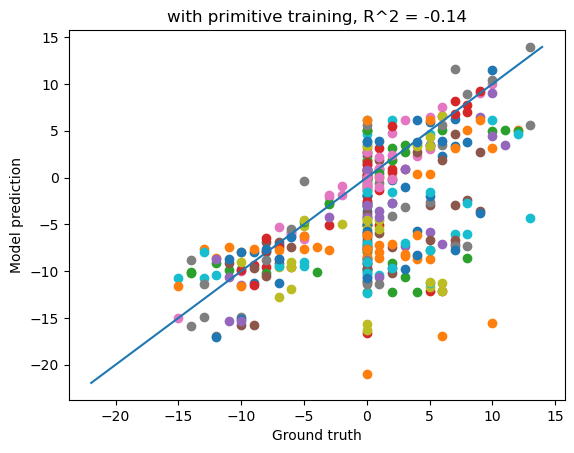

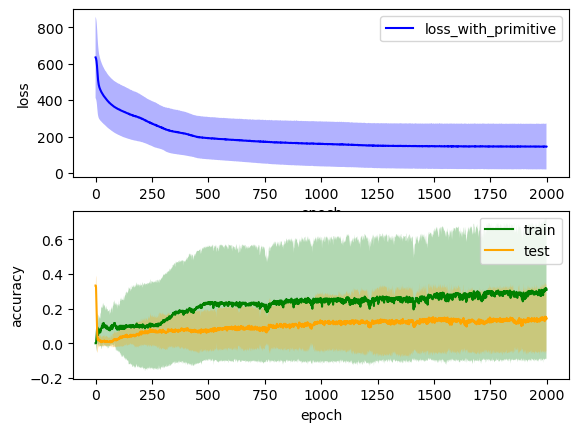

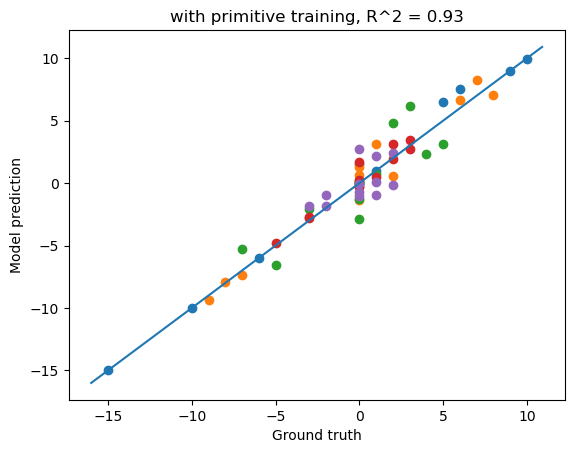

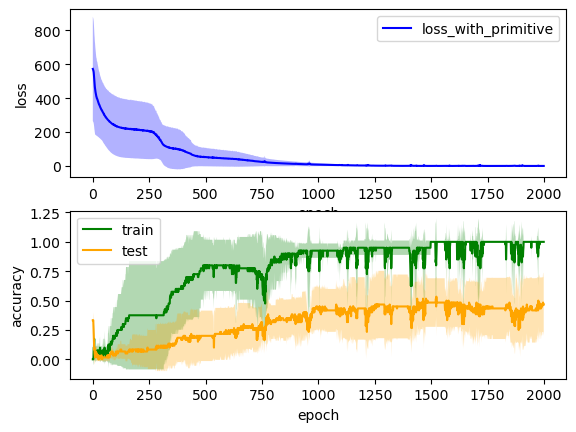

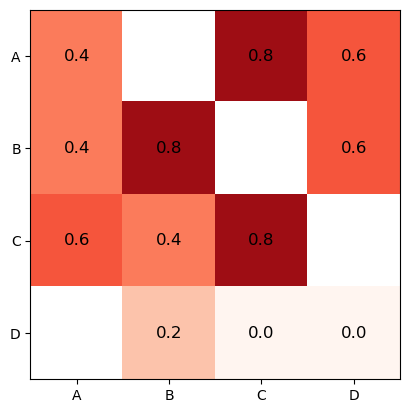

In [93]:
 # other
epochs = 2000
num_sims = 32
hidden_size=8
xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  3.2072779814402264
2


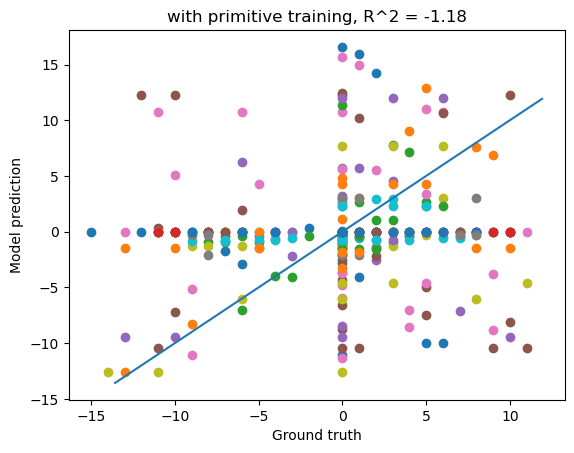

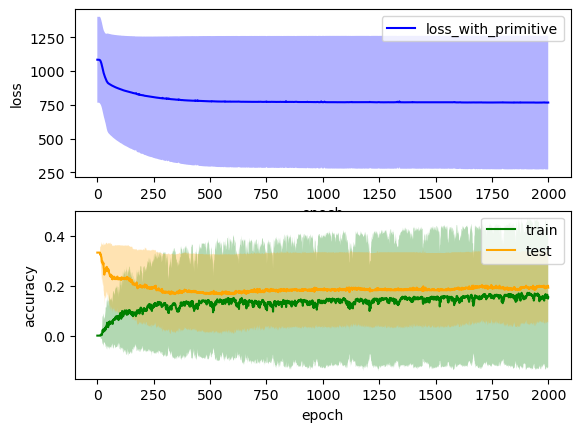

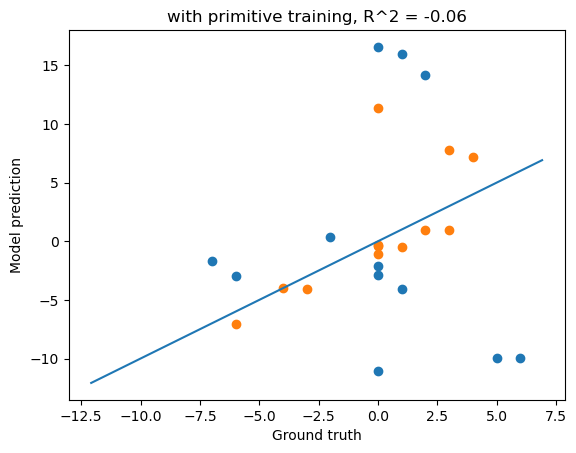

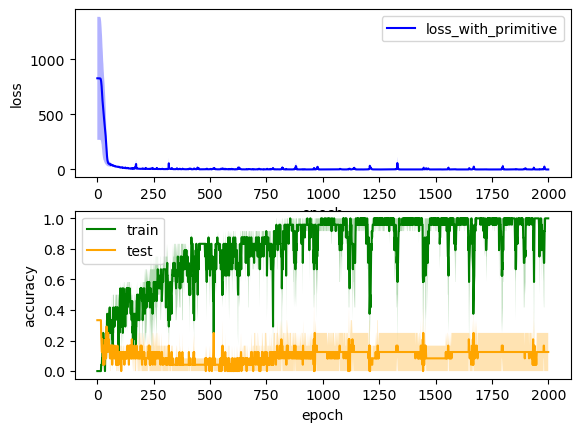

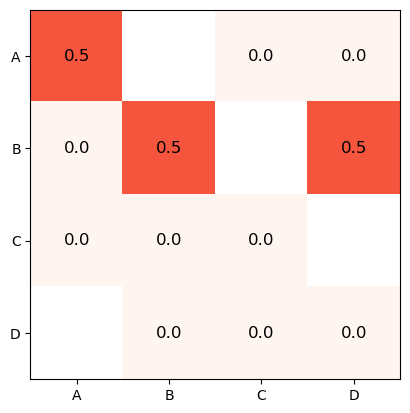

In [94]:
 # other
epochs = 2000
num_sims = 32
hidden_size=8
xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms,  cue_dict) + primitives+ neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  3.4414050300916035
2


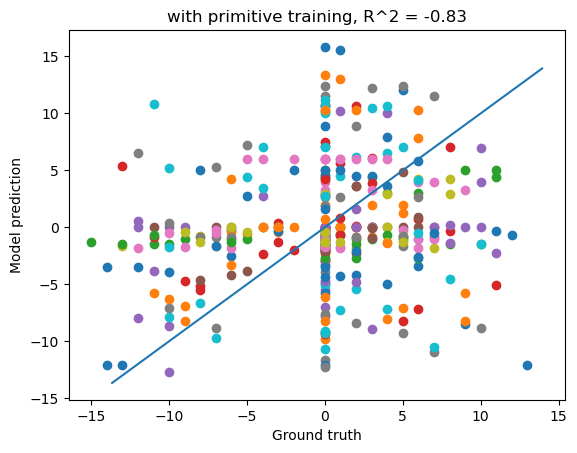

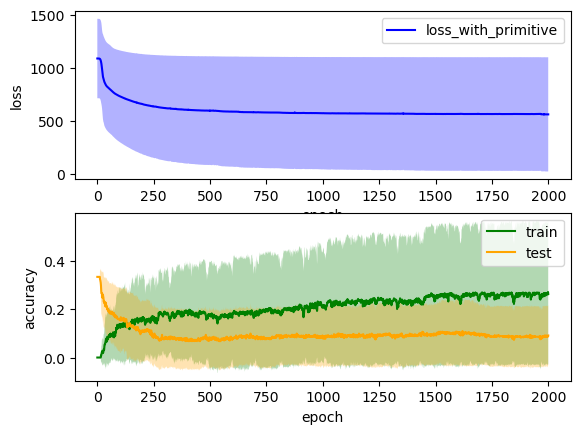

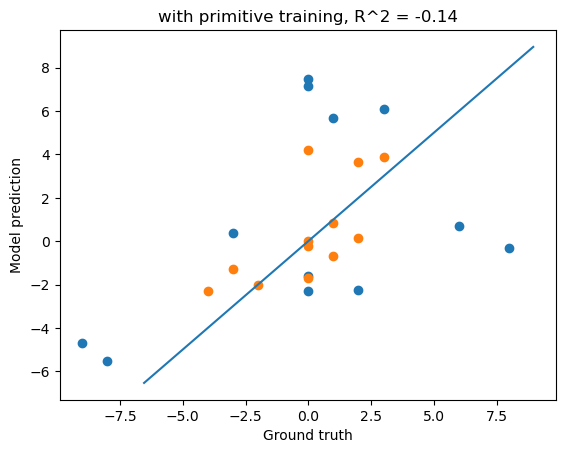

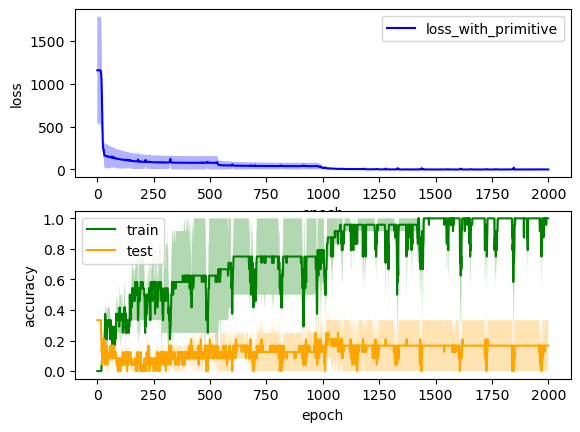

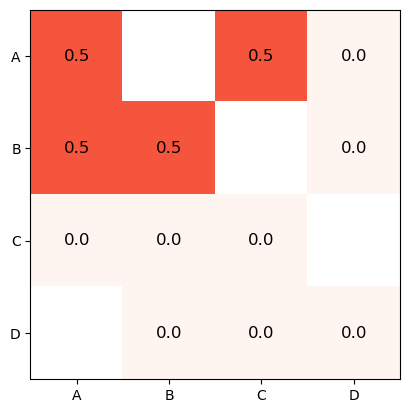

In [95]:
 # other
epochs = 2000
num_sims = 32
hidden_size=8
xavier_gain = 0.01

trainseqs = generate_other(ops, all_syms,  cue_dict) + primitives+ neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  65.96134233474731
21


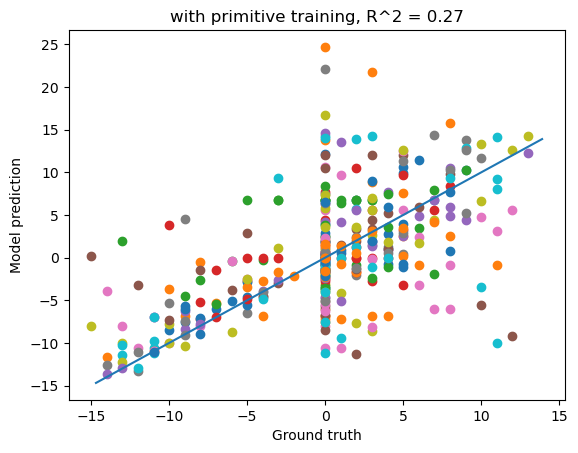

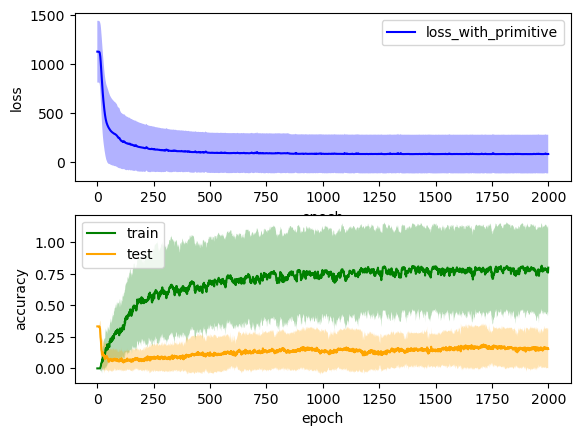

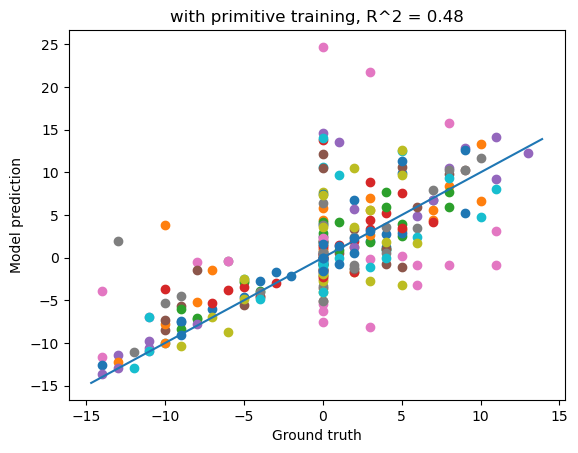

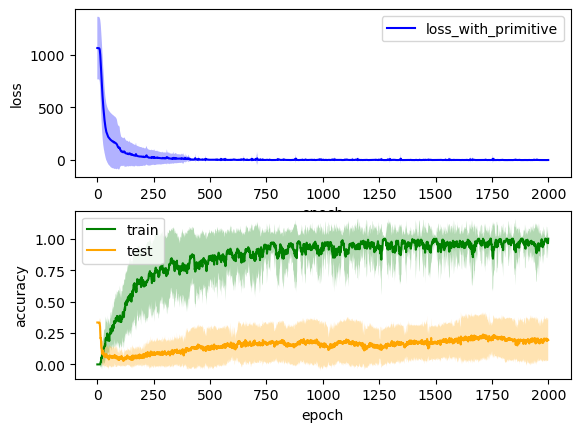

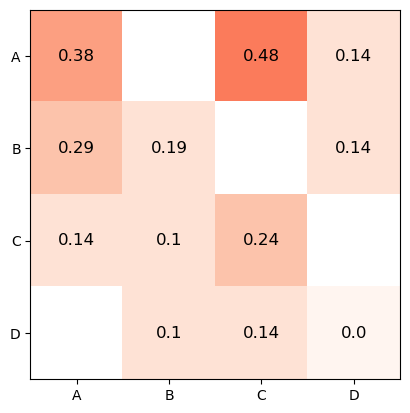

In [96]:
 # other
epochs = 2000
num_sims = 32
hidden_size=8
xavier_gain = 0.1

trainseqs = generate_other(ops, all_syms,  cue_dict) + primitives+ neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  21.64937858581543
5


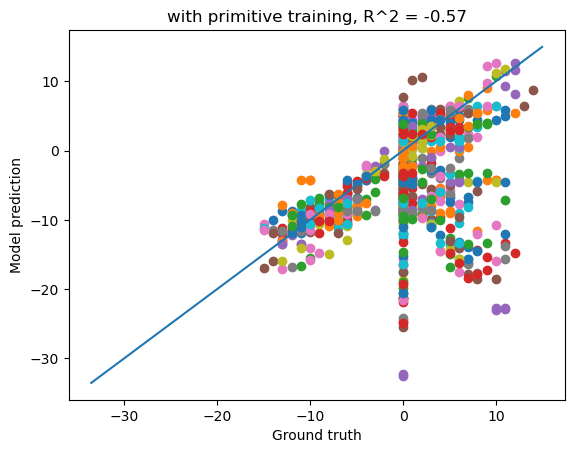

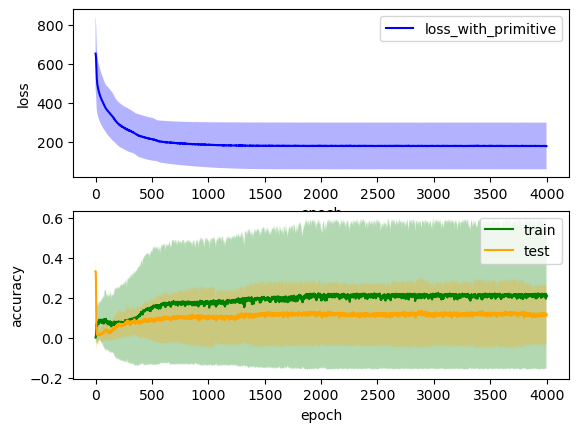

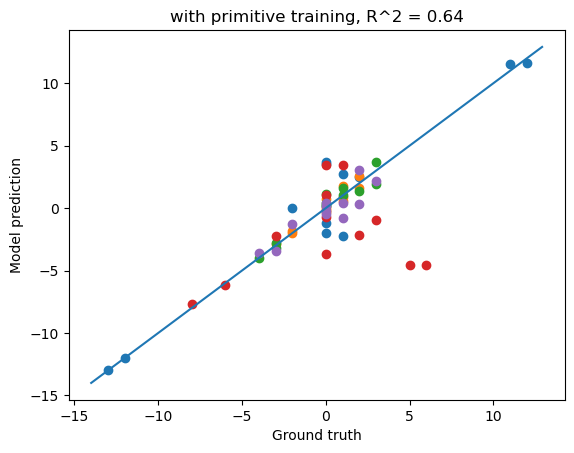

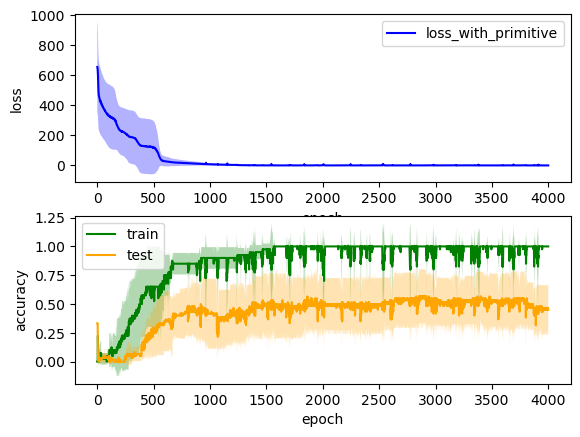

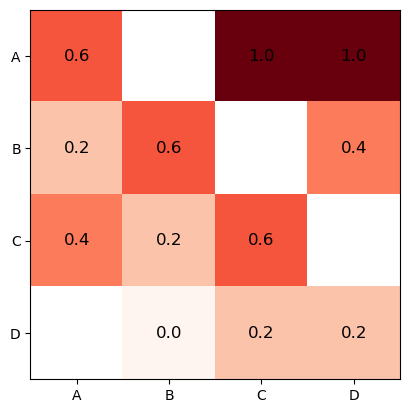

In [99]:
 # other
epochs = 4000
num_sims = 64
hidden_size=8
xavier_gain = 0.00001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  160.58672276735305
6


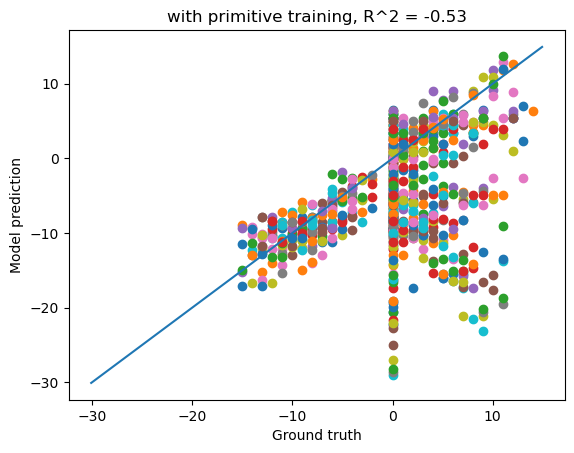

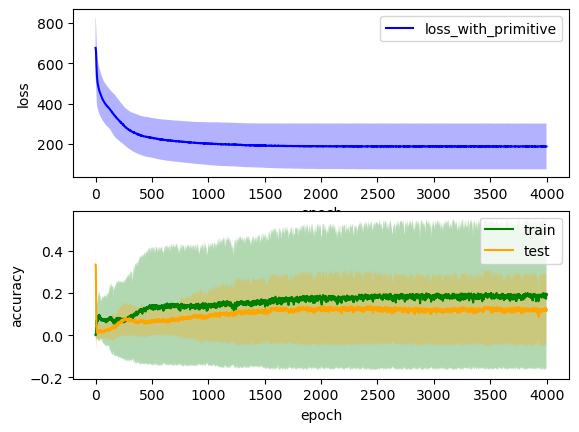

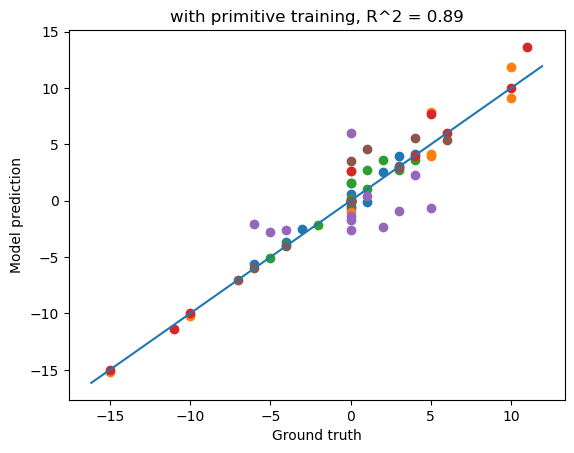

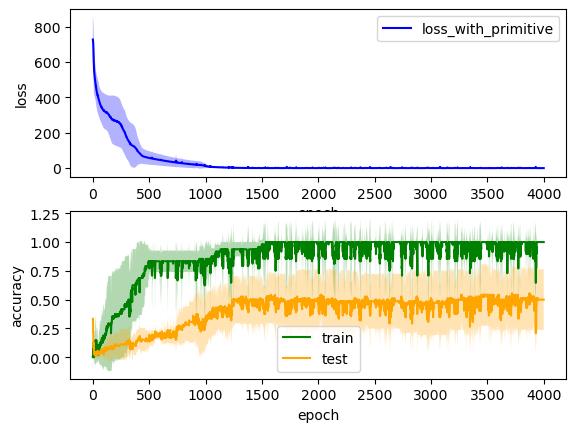

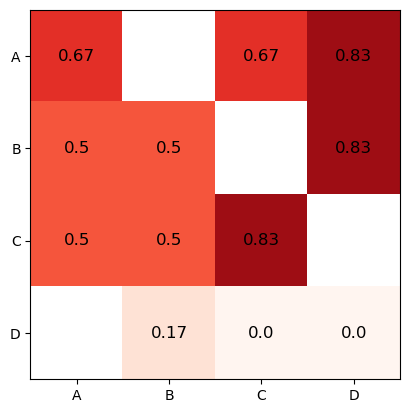

In [100]:
 # other
epochs = 4000
num_sims = 64
hidden_size=8
xavier_gain = 0.0001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  59.01660945018133
12


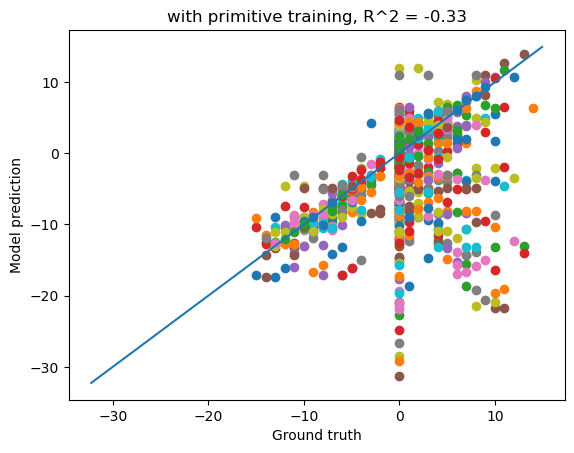

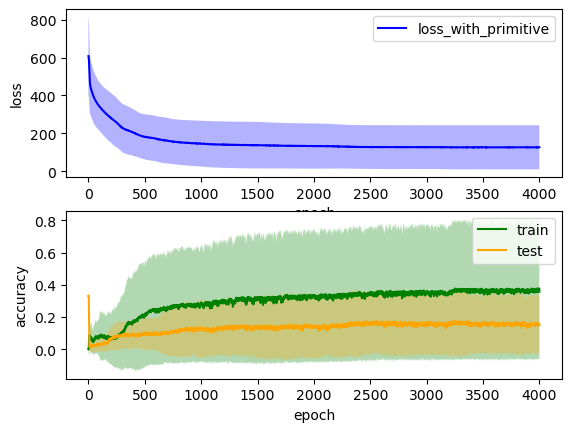

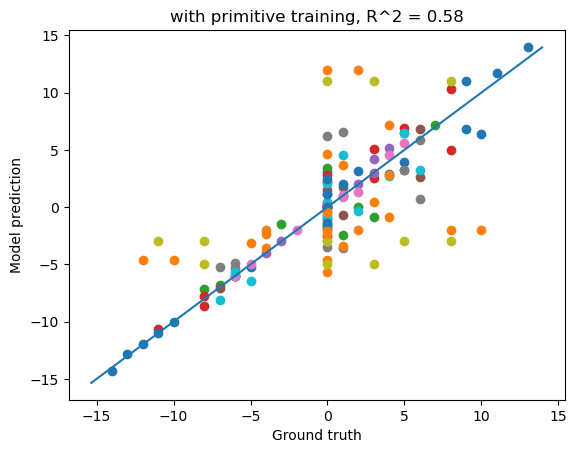

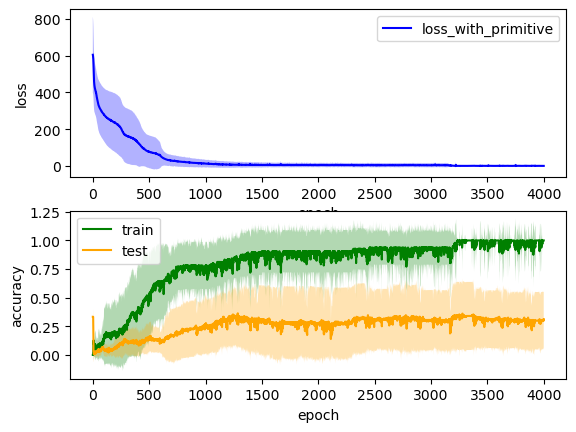

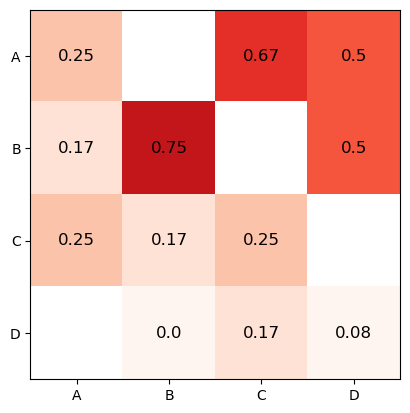

In [101]:
 # other
epochs = 4000
num_sims = 64
hidden_size=8
xavier_gain = 0.001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  17.952152180671693
9


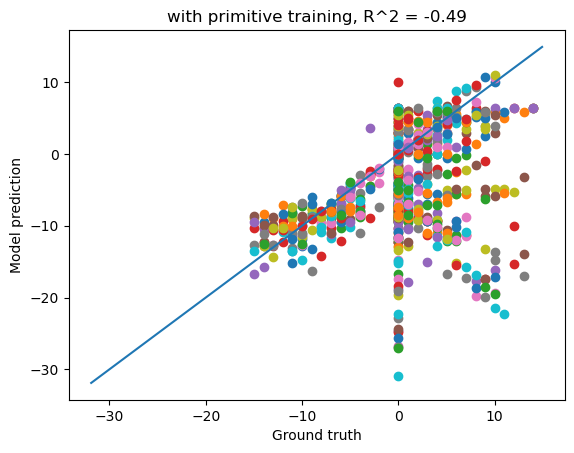

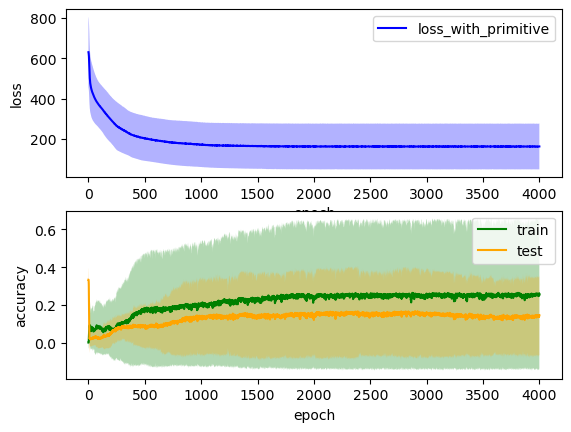

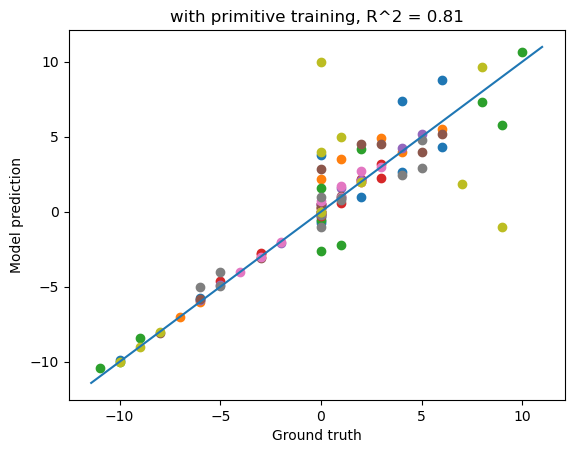

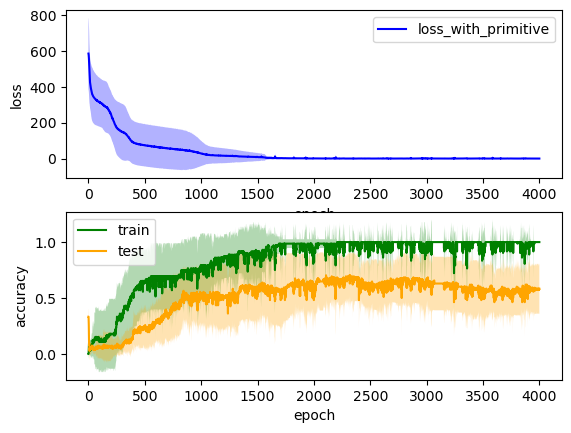

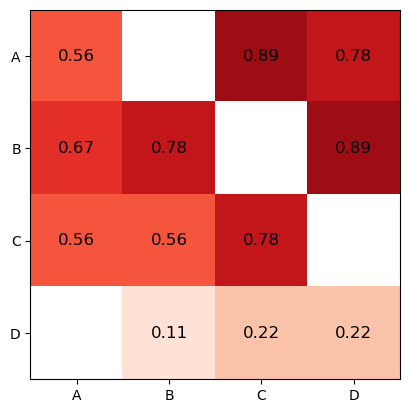

In [106]:
 # other
epochs = 4000
num_sims = 64
hidden_size=8
xavier_gain = 0.0001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [107]:
save_dir = '../results/representation_analysis/'

with open(save_dir+'res_sub', 'wb') as f:
    pickle.dump(res1, f)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  17.92938844760259
10


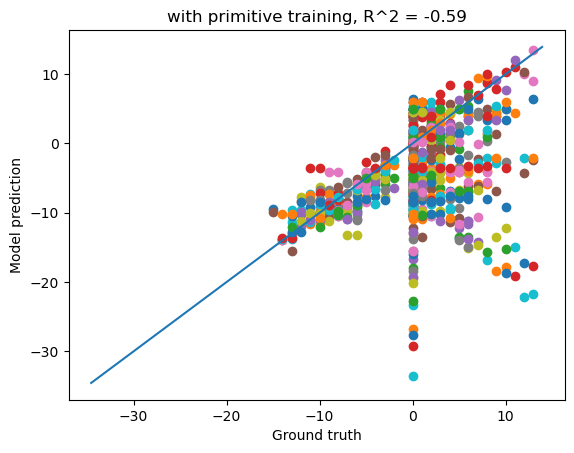

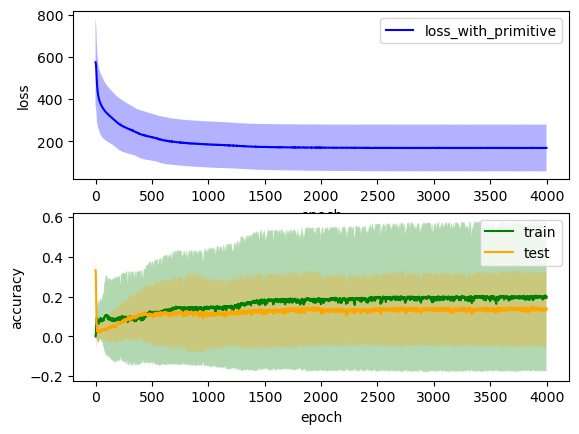

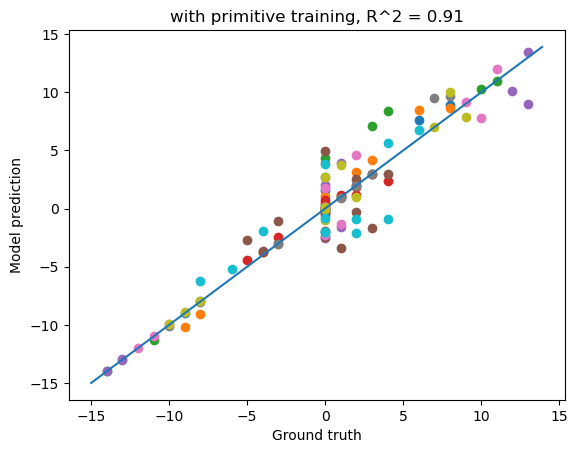

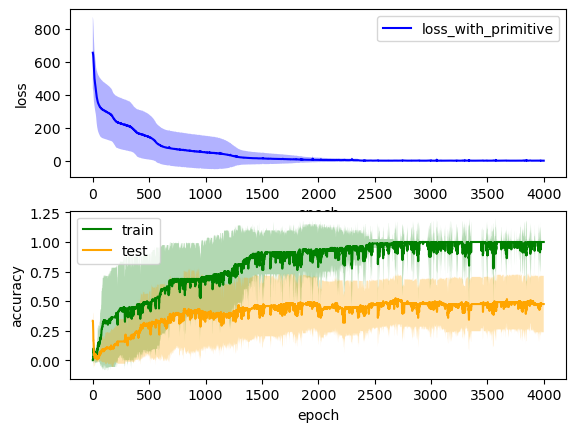

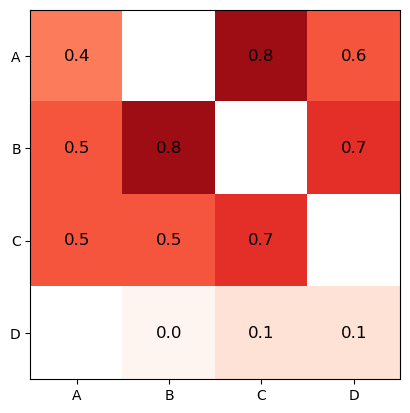

In [104]:
 # other
epochs = 4000
num_sims = 64
hidden_size=5
xavier_gain = 0.0001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'C'), '=', -10], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['D', ('-', 'B'), '=', 7], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'B'), '=', 3], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  63.80906128485997
13


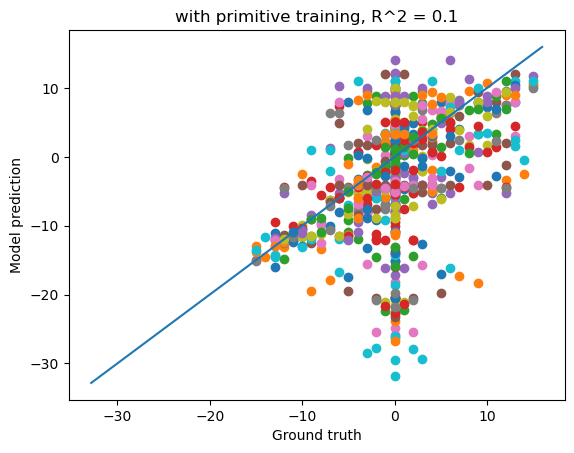

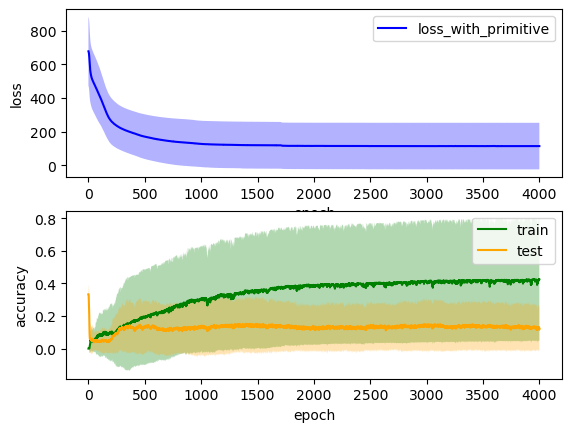

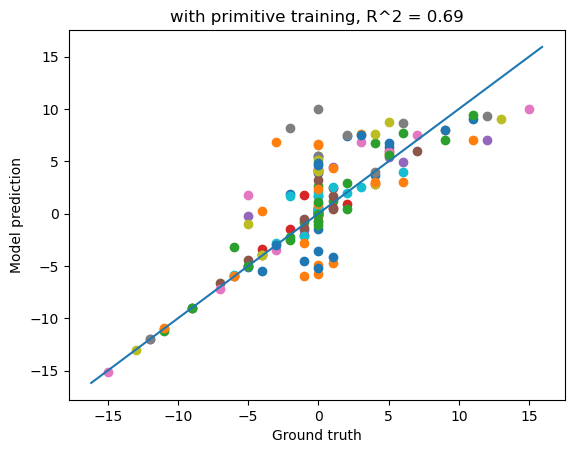

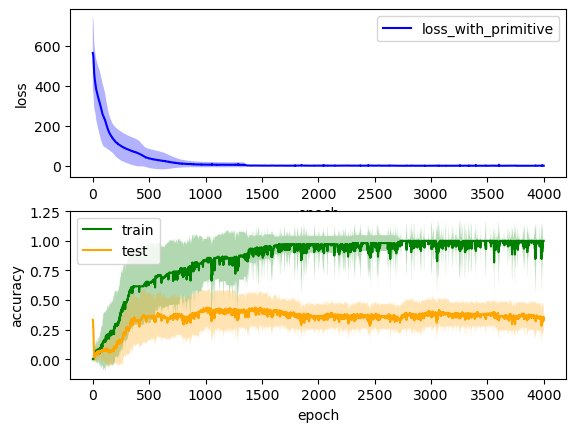

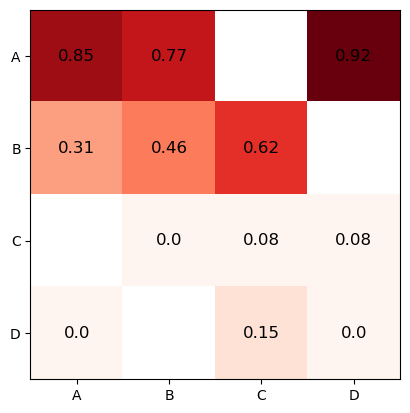

In [105]:
 # other
epochs = 4000
num_sims = 64
hidden_size=5
xavier_gain = 0.0001

trainseqs = generate_other_reverse(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  20.785232667128245
27


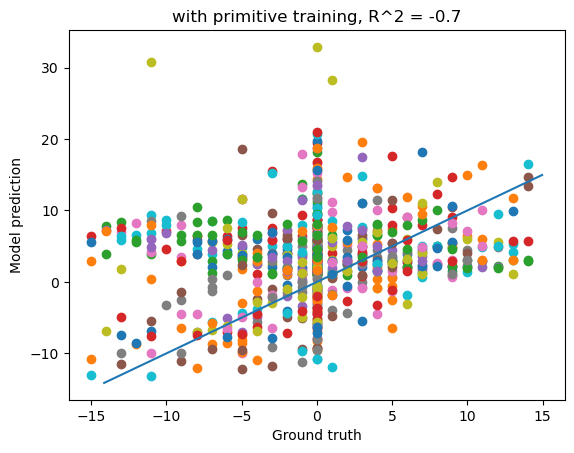

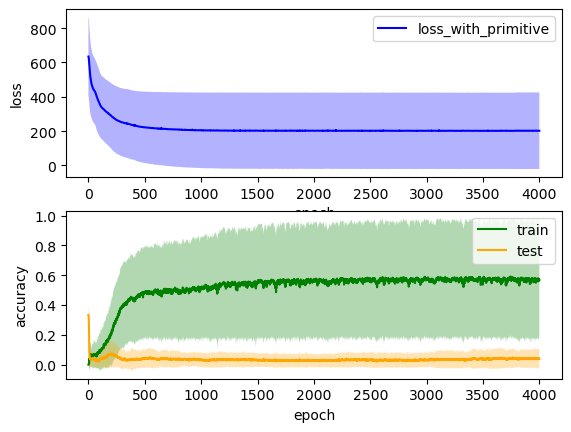

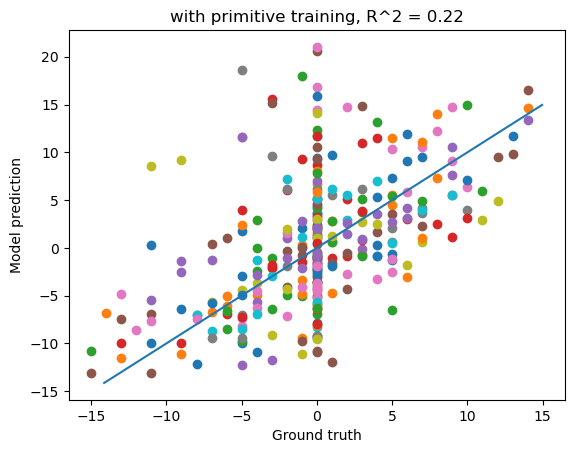

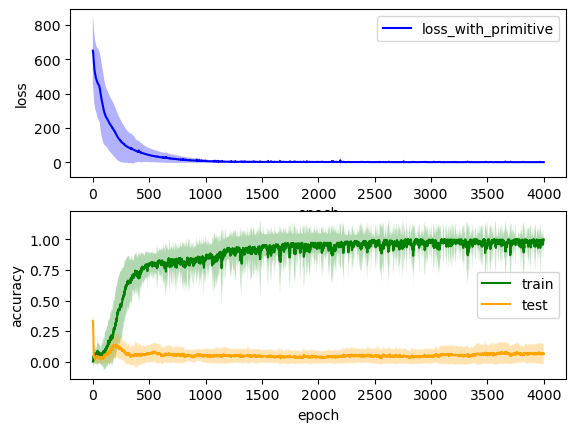

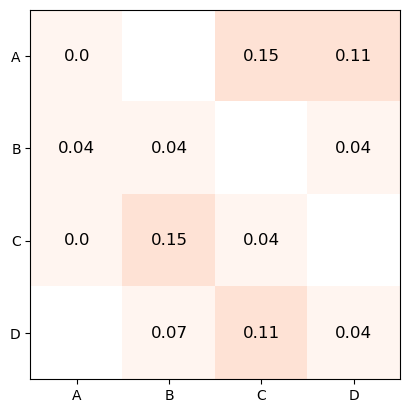

In [109]:
 # other
epochs = 4000
num_sims = 64
hidden_size=8
xavier_gain = 0.0001

trainseqs = generate_other(ops, all_syms,  cue_dict) + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'B'), '=', 3], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9], ['A', '=', 5], ['B', '=', 2], ['C', '=', 15], ['D', '=', 9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'C'), '=', -10], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['D', ('-', 'B'), '=', 7], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  29.53873143196106
4


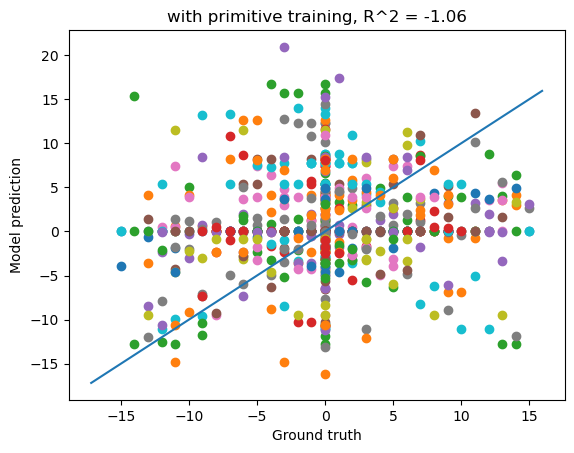

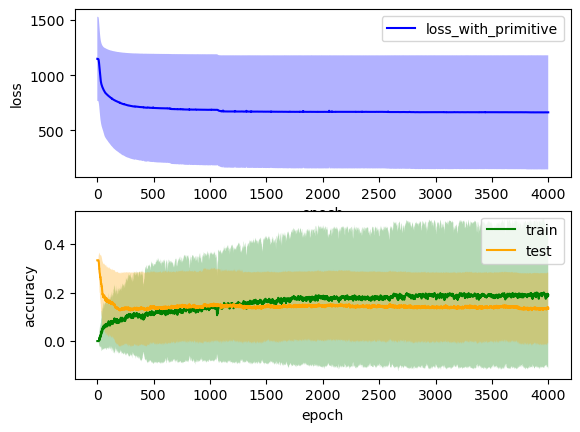

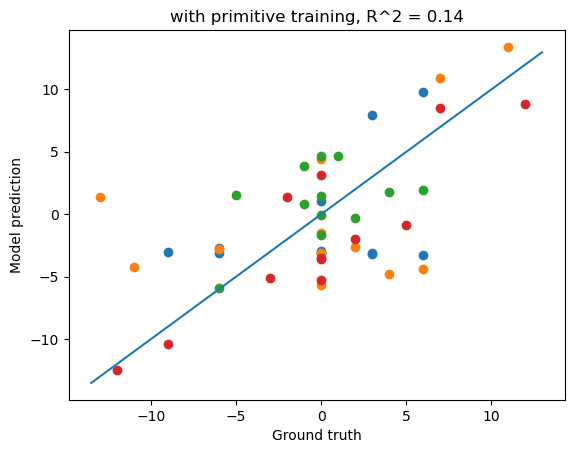

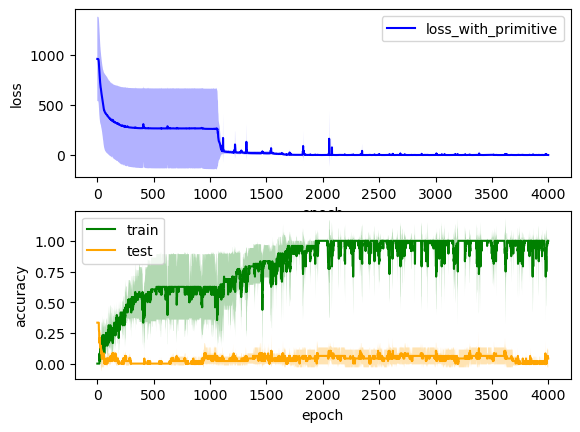

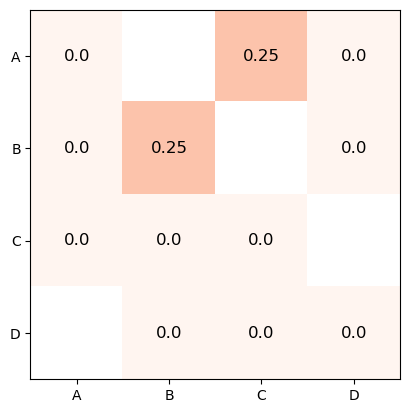

In [110]:
 # other
epochs = 4000
num_sims = 64
hidden_size=8
xavier_gain = 0.0001

trainseqs = generate_other(ops, all_syms,  cue_dict) + neg_primitives + primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

trainseqs  [['A', ('-', 'C'), '=', -10], ['B', ('-', 'D'), '=', -7], ['C', ('-', 'A'), '=', 10], ['D', ('-', 'B'), '=', 7], [('-', 'A'), '=', -5], [('-', 'B'), '=', -2], [('-', 'C'), '=', -15], [('-', 'D'), '=', -9]]
testseqs  [['A', ('-', 'A'), '=', 0], ['A', ('-', 'B'), '=', 3], ['A', ('-', 'D'), '=', -4], ['B', ('-', 'A'), '=', -3], ['B', ('-', 'B'), '=', 0], ['B', ('-', 'C'), '=', -13], ['C', ('-', 'B'), '=', 13], ['C', ('-', 'C'), '=', 0], ['C', ('-', 'D'), '=', 6], ['D', ('-', 'A'), '=', 4], ['D', ('-', 'C'), '=', -6], ['D', ('-', 'D'), '=', 0]]
run time:  1.9168497641881308
1


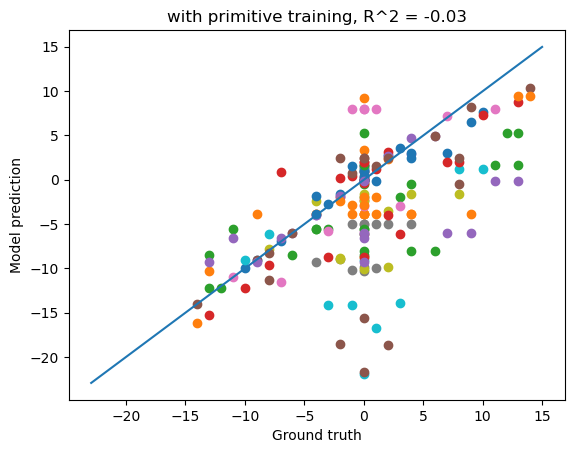

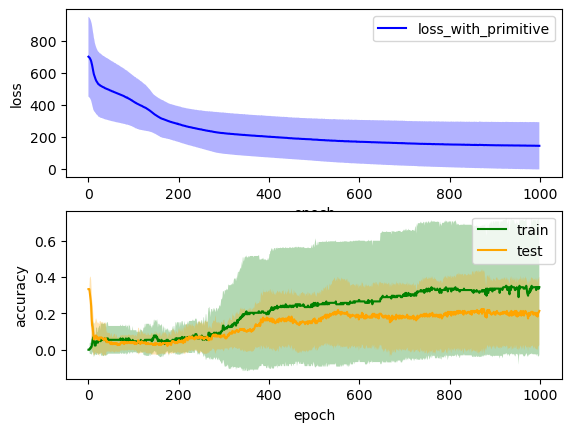

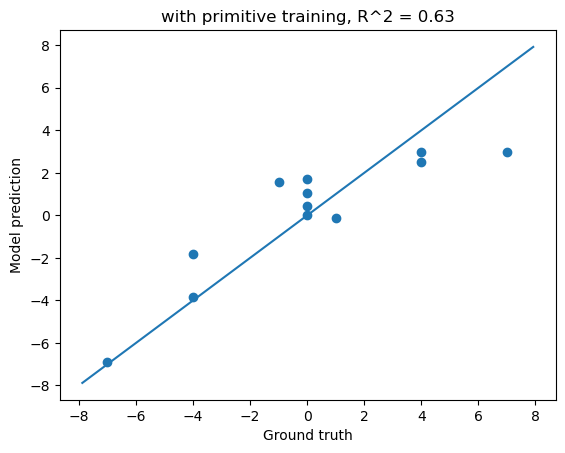

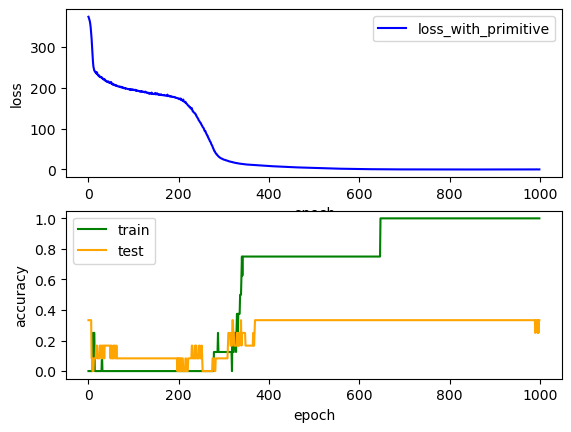

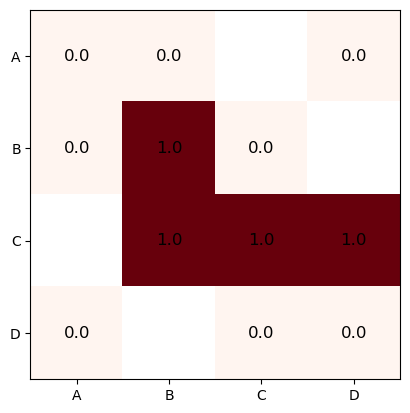

In [113]:
 # other
epochs = 1000
num_sims = 16
hidden_size=5
xavier_gain = 0.001

trainseqs = generate_other_reverse(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)

In [ ]:
 # other
epochs = 1000
num_sims = 16
hidden_size=7
xavier_gain = 0.001

trainseqs = generate_other_reverse(ops, all_syms,  cue_dict) + neg_primitives
testseqs = generate_trials(ops, all_syms, all_syms, cue_dict)
testseqs = [seq for seq in testseqs if seq not in trainseqs]
print('trainseqs ', trainseqs)
print('testseqs ', testseqs )
res1 = run_plot(trainseqs, testseqs, cue_dict, xavier_gain)

fig, ax = plt.subplots(1,1)
heatmap_acc(num_inputs, res1['dfs'], ax)